# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]="2"

In [3]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

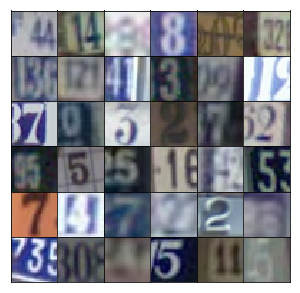

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stack layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        # tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.7032... Generator Loss: 0.5633
Epoch 1/25... Discriminator Loss: 0.5833... Generator Loss: 1.5477
Epoch 1/25... Discriminator Loss: 0.2334... Generator Loss: 2.0120
Epoch 1/25... Discriminator Loss: 0.1695... Generator Loss: 2.5384
Epoch 1/25... Discriminator Loss: 0.1746... Generator Loss: 2.6152
Epoch 1/25... Discriminator Loss: 0.0726... Generator Loss: 3.4351
Epoch 1/25... Discriminator Loss: 0.1280... Generator Loss: 2.9166
Epoch 1/25... Discriminator Loss: 0.2996... Generator Loss: 2.2935
Epoch 1/25... Discriminator Loss: 0.1661... Generator Loss: 2.6205
Epoch 1/25... Discriminator Loss: 0.1855... Generator Loss: 3.7016


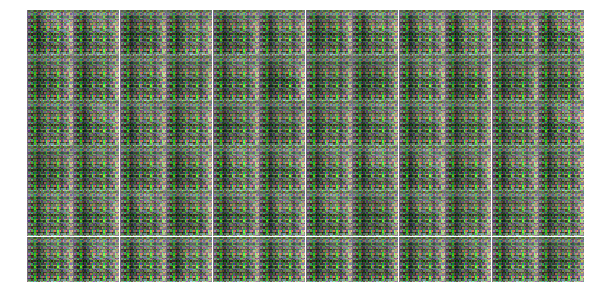

Epoch 1/25... Discriminator Loss: 0.1259... Generator Loss: 3.1731
Epoch 1/25... Discriminator Loss: 1.0086... Generator Loss: 0.7265
Epoch 1/25... Discriminator Loss: 0.8969... Generator Loss: 1.7969
Epoch 1/25... Discriminator Loss: 0.5120... Generator Loss: 1.6911
Epoch 1/25... Discriminator Loss: 0.6087... Generator Loss: 1.1991
Epoch 1/25... Discriminator Loss: 0.4700... Generator Loss: 2.0612
Epoch 1/25... Discriminator Loss: 0.3426... Generator Loss: 2.0304
Epoch 1/25... Discriminator Loss: 0.3760... Generator Loss: 1.8148
Epoch 1/25... Discriminator Loss: 0.6573... Generator Loss: 3.7324
Epoch 1/25... Discriminator Loss: 0.4275... Generator Loss: 3.4931


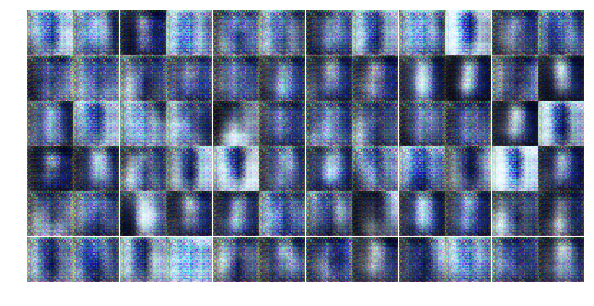

Epoch 1/25... Discriminator Loss: 1.8609... Generator Loss: 0.3301
Epoch 1/25... Discriminator Loss: 0.7791... Generator Loss: 1.7071
Epoch 1/25... Discriminator Loss: 0.2548... Generator Loss: 2.7234
Epoch 1/25... Discriminator Loss: 0.9820... Generator Loss: 1.1772
Epoch 1/25... Discriminator Loss: 0.3515... Generator Loss: 2.2229
Epoch 1/25... Discriminator Loss: 0.8462... Generator Loss: 1.2859
Epoch 1/25... Discriminator Loss: 0.6447... Generator Loss: 1.7591
Epoch 1/25... Discriminator Loss: 0.4767... Generator Loss: 2.4585
Epoch 1/25... Discriminator Loss: 0.3861... Generator Loss: 2.4822
Epoch 1/25... Discriminator Loss: 0.4112... Generator Loss: 2.4546


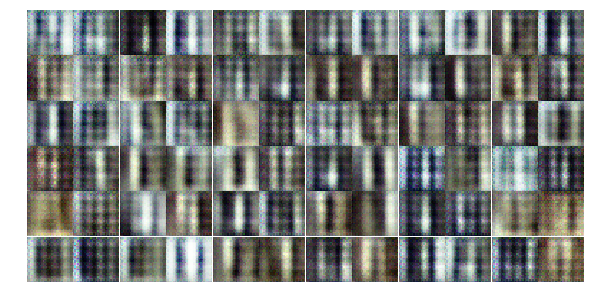

Epoch 1/25... Discriminator Loss: 0.6444... Generator Loss: 1.1609
Epoch 1/25... Discriminator Loss: 0.5755... Generator Loss: 1.3667
Epoch 1/25... Discriminator Loss: 0.6852... Generator Loss: 1.4857
Epoch 1/25... Discriminator Loss: 0.4139... Generator Loss: 1.9899
Epoch 1/25... Discriminator Loss: 0.5694... Generator Loss: 1.2180
Epoch 1/25... Discriminator Loss: 0.8555... Generator Loss: 0.9124
Epoch 1/25... Discriminator Loss: 0.5226... Generator Loss: 1.7519
Epoch 1/25... Discriminator Loss: 0.6134... Generator Loss: 1.9960
Epoch 1/25... Discriminator Loss: 0.6094... Generator Loss: 1.4036
Epoch 1/25... Discriminator Loss: 0.5025... Generator Loss: 1.8957


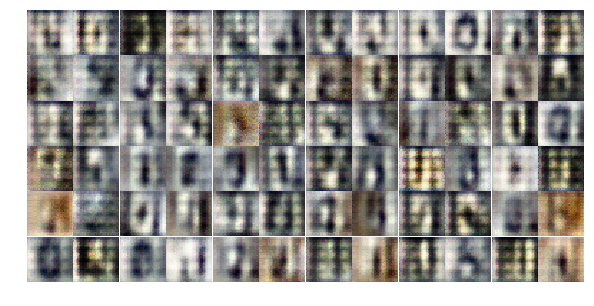

Epoch 1/25... Discriminator Loss: 0.8555... Generator Loss: 1.5385
Epoch 1/25... Discriminator Loss: 0.4789... Generator Loss: 1.7036
Epoch 1/25... Discriminator Loss: 0.5741... Generator Loss: 1.4579
Epoch 1/25... Discriminator Loss: 0.9793... Generator Loss: 2.6112
Epoch 1/25... Discriminator Loss: 0.5884... Generator Loss: 1.5695
Epoch 1/25... Discriminator Loss: 0.7402... Generator Loss: 1.4523
Epoch 1/25... Discriminator Loss: 0.6477... Generator Loss: 1.4510
Epoch 1/25... Discriminator Loss: 1.0614... Generator Loss: 1.1400
Epoch 1/25... Discriminator Loss: 0.8136... Generator Loss: 1.1287
Epoch 1/25... Discriminator Loss: 1.1686... Generator Loss: 1.2105


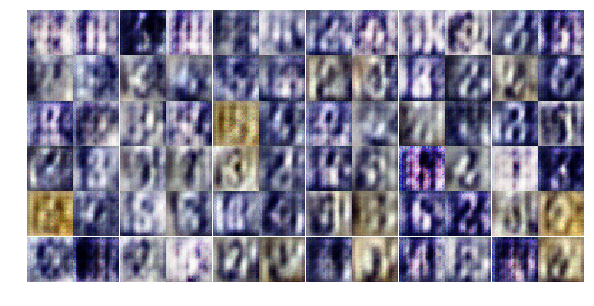

Epoch 1/25... Discriminator Loss: 0.9821... Generator Loss: 0.8870
Epoch 1/25... Discriminator Loss: 0.9293... Generator Loss: 1.2321
Epoch 1/25... Discriminator Loss: 0.7196... Generator Loss: 1.7001
Epoch 1/25... Discriminator Loss: 1.1395... Generator Loss: 0.6190
Epoch 1/25... Discriminator Loss: 0.6471... Generator Loss: 1.6952
Epoch 1/25... Discriminator Loss: 0.7910... Generator Loss: 1.4380
Epoch 1/25... Discriminator Loss: 0.7896... Generator Loss: 1.5027
Epoch 2/25... Discriminator Loss: 0.9179... Generator Loss: 1.2015
Epoch 2/25... Discriminator Loss: 0.6385... Generator Loss: 1.7130
Epoch 2/25... Discriminator Loss: 0.8642... Generator Loss: 1.0397


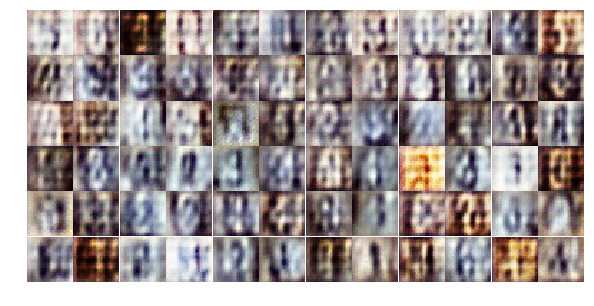

Epoch 2/25... Discriminator Loss: 0.9592... Generator Loss: 1.0542
Epoch 2/25... Discriminator Loss: 1.1218... Generator Loss: 0.7954
Epoch 2/25... Discriminator Loss: 0.9769... Generator Loss: 1.0967
Epoch 2/25... Discriminator Loss: 1.0799... Generator Loss: 1.0860
Epoch 2/25... Discriminator Loss: 0.9854... Generator Loss: 0.8983
Epoch 2/25... Discriminator Loss: 1.1110... Generator Loss: 0.8798
Epoch 2/25... Discriminator Loss: 0.8991... Generator Loss: 1.0961
Epoch 2/25... Discriminator Loss: 0.9462... Generator Loss: 1.0110
Epoch 2/25... Discriminator Loss: 0.8828... Generator Loss: 1.3016
Epoch 2/25... Discriminator Loss: 0.7617... Generator Loss: 1.3365


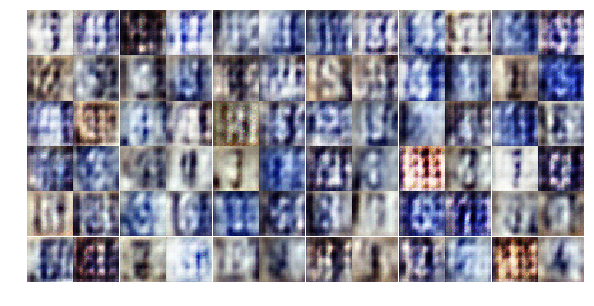

Epoch 2/25... Discriminator Loss: 1.1106... Generator Loss: 1.0041
Epoch 2/25... Discriminator Loss: 0.8417... Generator Loss: 1.2980
Epoch 2/25... Discriminator Loss: 0.9916... Generator Loss: 1.0336
Epoch 2/25... Discriminator Loss: 0.7742... Generator Loss: 0.9872
Epoch 2/25... Discriminator Loss: 0.8901... Generator Loss: 1.3787
Epoch 2/25... Discriminator Loss: 1.2964... Generator Loss: 1.8435
Epoch 2/25... Discriminator Loss: 1.3399... Generator Loss: 0.8129
Epoch 2/25... Discriminator Loss: 1.1775... Generator Loss: 0.9350
Epoch 2/25... Discriminator Loss: 1.1791... Generator Loss: 0.8638
Epoch 2/25... Discriminator Loss: 1.1991... Generator Loss: 0.5985


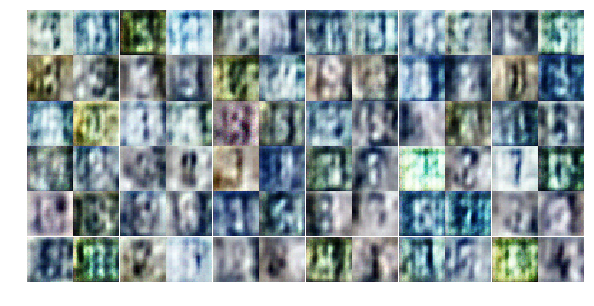

Epoch 2/25... Discriminator Loss: 1.4022... Generator Loss: 0.5668
Epoch 2/25... Discriminator Loss: 1.3666... Generator Loss: 0.7338
Epoch 2/25... Discriminator Loss: 0.8631... Generator Loss: 1.1365
Epoch 2/25... Discriminator Loss: 1.1115... Generator Loss: 1.1467
Epoch 2/25... Discriminator Loss: 1.1041... Generator Loss: 1.0648
Epoch 2/25... Discriminator Loss: 1.2087... Generator Loss: 0.8354
Epoch 2/25... Discriminator Loss: 1.0927... Generator Loss: 1.0102
Epoch 2/25... Discriminator Loss: 1.2956... Generator Loss: 0.5766
Epoch 2/25... Discriminator Loss: 1.1430... Generator Loss: 0.9728
Epoch 2/25... Discriminator Loss: 0.9571... Generator Loss: 1.0804


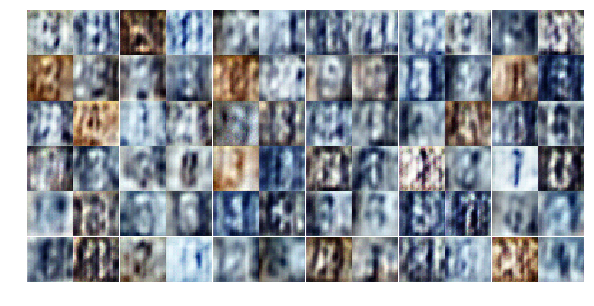

Epoch 2/25... Discriminator Loss: 1.1938... Generator Loss: 0.7850
Epoch 2/25... Discriminator Loss: 1.0374... Generator Loss: 1.0111
Epoch 2/25... Discriminator Loss: 1.3156... Generator Loss: 0.6406
Epoch 2/25... Discriminator Loss: 1.4911... Generator Loss: 0.6010
Epoch 2/25... Discriminator Loss: 1.2115... Generator Loss: 0.9224
Epoch 2/25... Discriminator Loss: 1.2234... Generator Loss: 0.7334
Epoch 2/25... Discriminator Loss: 1.0844... Generator Loss: 1.0399
Epoch 2/25... Discriminator Loss: 1.1415... Generator Loss: 1.1446
Epoch 2/25... Discriminator Loss: 1.0818... Generator Loss: 1.0056
Epoch 2/25... Discriminator Loss: 1.0898... Generator Loss: 0.8967


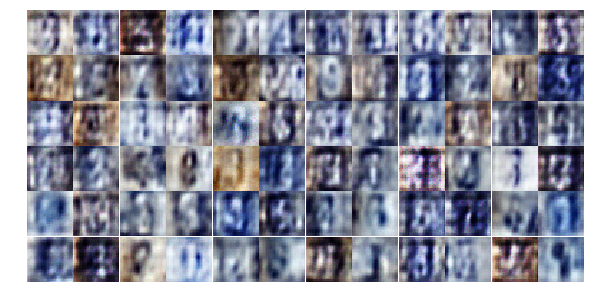

Epoch 2/25... Discriminator Loss: 0.8369... Generator Loss: 1.3538
Epoch 2/25... Discriminator Loss: 1.1114... Generator Loss: 1.3991
Epoch 2/25... Discriminator Loss: 1.1089... Generator Loss: 0.9573
Epoch 2/25... Discriminator Loss: 1.0730... Generator Loss: 1.1120
Epoch 2/25... Discriminator Loss: 1.1624... Generator Loss: 0.7929
Epoch 2/25... Discriminator Loss: 1.3080... Generator Loss: 0.6015
Epoch 2/25... Discriminator Loss: 1.0865... Generator Loss: 1.1755
Epoch 2/25... Discriminator Loss: 1.2713... Generator Loss: 0.9076
Epoch 2/25... Discriminator Loss: 1.0828... Generator Loss: 1.2880
Epoch 2/25... Discriminator Loss: 1.0390... Generator Loss: 0.9181


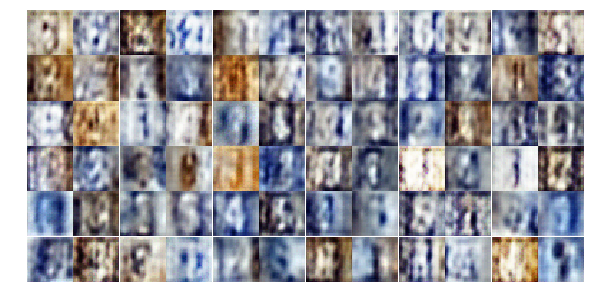

Epoch 2/25... Discriminator Loss: 1.0225... Generator Loss: 1.2523
Epoch 2/25... Discriminator Loss: 1.2330... Generator Loss: 0.8695
Epoch 2/25... Discriminator Loss: 1.3962... Generator Loss: 0.5002
Epoch 2/25... Discriminator Loss: 0.8852... Generator Loss: 1.0766
Epoch 3/25... Discriminator Loss: 0.9824... Generator Loss: 1.1507
Epoch 3/25... Discriminator Loss: 0.9621... Generator Loss: 1.0518
Epoch 3/25... Discriminator Loss: 0.9578... Generator Loss: 0.9162
Epoch 3/25... Discriminator Loss: 0.9873... Generator Loss: 0.8663
Epoch 3/25... Discriminator Loss: 0.8365... Generator Loss: 1.3140
Epoch 3/25... Discriminator Loss: 0.9995... Generator Loss: 1.0729


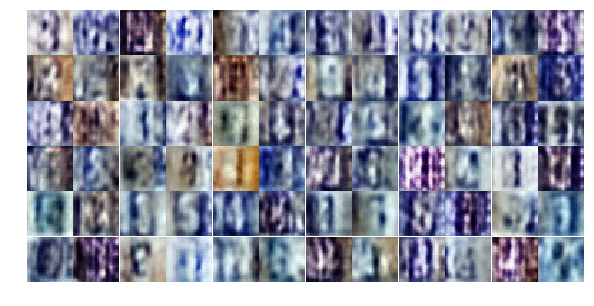

Epoch 3/25... Discriminator Loss: 0.7932... Generator Loss: 1.5516
Epoch 3/25... Discriminator Loss: 0.8976... Generator Loss: 1.4978
Epoch 3/25... Discriminator Loss: 0.8635... Generator Loss: 1.1831
Epoch 3/25... Discriminator Loss: 0.7749... Generator Loss: 1.3188
Epoch 3/25... Discriminator Loss: 0.8344... Generator Loss: 1.1369
Epoch 3/25... Discriminator Loss: 0.8699... Generator Loss: 1.9086
Epoch 3/25... Discriminator Loss: 0.9826... Generator Loss: 0.7883
Epoch 3/25... Discriminator Loss: 0.8323... Generator Loss: 1.2665
Epoch 3/25... Discriminator Loss: 0.8911... Generator Loss: 0.7416
Epoch 3/25... Discriminator Loss: 0.6364... Generator Loss: 1.3497


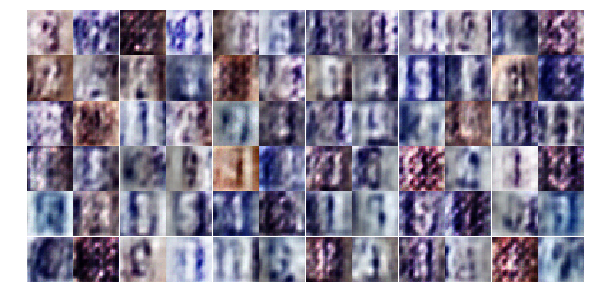

Epoch 3/25... Discriminator Loss: 0.7467... Generator Loss: 1.1085
Epoch 3/25... Discriminator Loss: 0.8723... Generator Loss: 1.1563
Epoch 3/25... Discriminator Loss: 1.0046... Generator Loss: 0.7983
Epoch 3/25... Discriminator Loss: 0.7990... Generator Loss: 1.1133
Epoch 3/25... Discriminator Loss: 1.0065... Generator Loss: 0.6645
Epoch 3/25... Discriminator Loss: 0.7528... Generator Loss: 1.5763
Epoch 3/25... Discriminator Loss: 0.8005... Generator Loss: 0.8944
Epoch 3/25... Discriminator Loss: 0.8683... Generator Loss: 0.8405
Epoch 3/25... Discriminator Loss: 0.4453... Generator Loss: 1.8584
Epoch 3/25... Discriminator Loss: 0.9093... Generator Loss: 0.7747


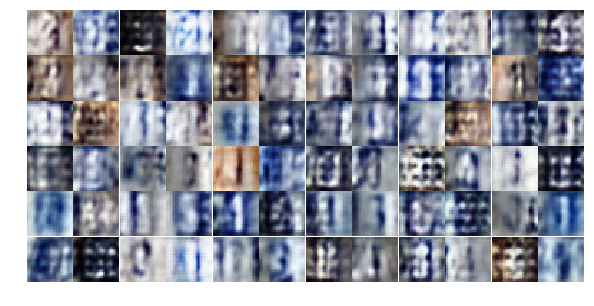

Epoch 3/25... Discriminator Loss: 0.5346... Generator Loss: 1.6632
Epoch 3/25... Discriminator Loss: 0.5853... Generator Loss: 1.7802
Epoch 3/25... Discriminator Loss: 0.9446... Generator Loss: 0.7545
Epoch 3/25... Discriminator Loss: 0.9436... Generator Loss: 0.7293
Epoch 3/25... Discriminator Loss: 0.7760... Generator Loss: 1.5402
Epoch 3/25... Discriminator Loss: 0.9728... Generator Loss: 0.7501
Epoch 3/25... Discriminator Loss: 0.7532... Generator Loss: 1.0521
Epoch 3/25... Discriminator Loss: 0.6927... Generator Loss: 1.6052
Epoch 3/25... Discriminator Loss: 0.6034... Generator Loss: 1.8569
Epoch 3/25... Discriminator Loss: 0.8283... Generator Loss: 2.5752


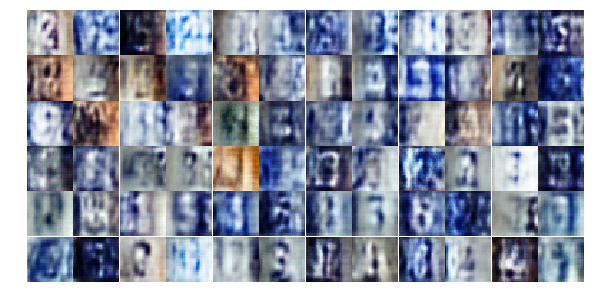

Epoch 3/25... Discriminator Loss: 0.6153... Generator Loss: 2.0412
Epoch 3/25... Discriminator Loss: 0.5541... Generator Loss: 1.5856
Epoch 3/25... Discriminator Loss: 0.4547... Generator Loss: 2.6196
Epoch 3/25... Discriminator Loss: 0.5051... Generator Loss: 2.2519
Epoch 3/25... Discriminator Loss: 0.3070... Generator Loss: 2.8621
Epoch 3/25... Discriminator Loss: 0.6327... Generator Loss: 1.2819
Epoch 3/25... Discriminator Loss: 0.8558... Generator Loss: 1.9590
Epoch 3/25... Discriminator Loss: 0.8305... Generator Loss: 1.3750
Epoch 3/25... Discriminator Loss: 0.6655... Generator Loss: 2.5043
Epoch 3/25... Discriminator Loss: 0.6684... Generator Loss: 1.4137


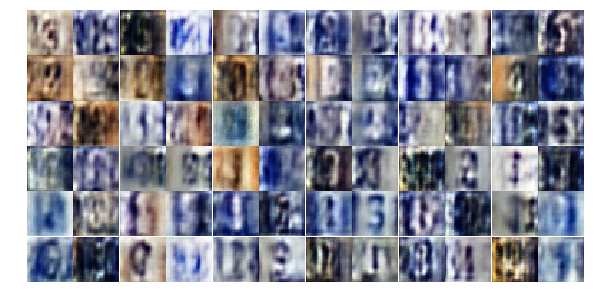

Epoch 3/25... Discriminator Loss: 0.7380... Generator Loss: 1.0793
Epoch 3/25... Discriminator Loss: 0.7454... Generator Loss: 2.0774
Epoch 3/25... Discriminator Loss: 0.7164... Generator Loss: 1.0460
Epoch 3/25... Discriminator Loss: 0.6536... Generator Loss: 1.3831
Epoch 3/25... Discriminator Loss: 0.9689... Generator Loss: 0.7093
Epoch 3/25... Discriminator Loss: 0.4448... Generator Loss: 2.0902
Epoch 3/25... Discriminator Loss: 0.5974... Generator Loss: 2.1777
Epoch 3/25... Discriminator Loss: 0.4121... Generator Loss: 2.0067
Epoch 3/25... Discriminator Loss: 0.5395... Generator Loss: 1.2646
Epoch 3/25... Discriminator Loss: 0.6442... Generator Loss: 1.0747


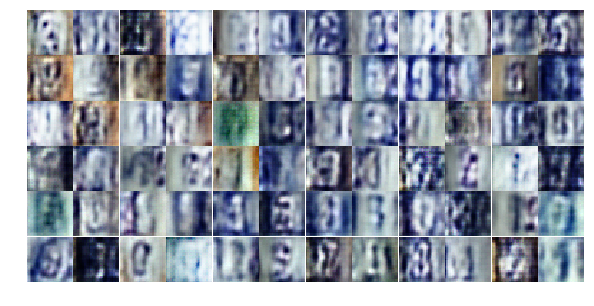

Epoch 3/25... Discriminator Loss: 1.5223... Generator Loss: 0.3389
Epoch 4/25... Discriminator Loss: 1.1699... Generator Loss: 0.5090
Epoch 4/25... Discriminator Loss: 0.8229... Generator Loss: 0.8152
Epoch 4/25... Discriminator Loss: 0.4196... Generator Loss: 1.8752
Epoch 4/25... Discriminator Loss: 0.5255... Generator Loss: 1.3355
Epoch 4/25... Discriminator Loss: 0.6188... Generator Loss: 1.1988
Epoch 4/25... Discriminator Loss: 1.2521... Generator Loss: 0.4921
Epoch 4/25... Discriminator Loss: 0.7334... Generator Loss: 0.9905
Epoch 4/25... Discriminator Loss: 0.4501... Generator Loss: 2.0008
Epoch 4/25... Discriminator Loss: 0.3998... Generator Loss: 1.8817


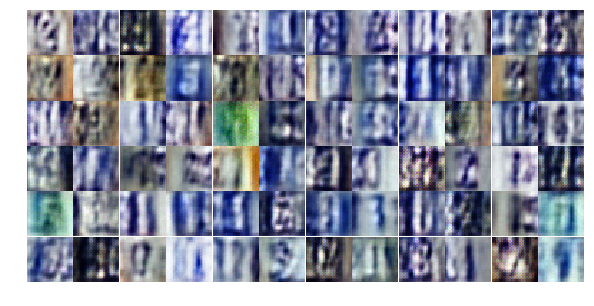

Epoch 4/25... Discriminator Loss: 0.7679... Generator Loss: 0.8928
Epoch 4/25... Discriminator Loss: 0.5265... Generator Loss: 1.6101
Epoch 4/25... Discriminator Loss: 0.9220... Generator Loss: 0.7487
Epoch 4/25... Discriminator Loss: 0.6779... Generator Loss: 1.8403
Epoch 4/25... Discriminator Loss: 0.8143... Generator Loss: 1.5107
Epoch 4/25... Discriminator Loss: 1.5830... Generator Loss: 0.2953
Epoch 4/25... Discriminator Loss: 1.2633... Generator Loss: 0.4383
Epoch 4/25... Discriminator Loss: 0.8837... Generator Loss: 0.7222
Epoch 4/25... Discriminator Loss: 0.5783... Generator Loss: 1.4566
Epoch 4/25... Discriminator Loss: 0.7218... Generator Loss: 1.8436


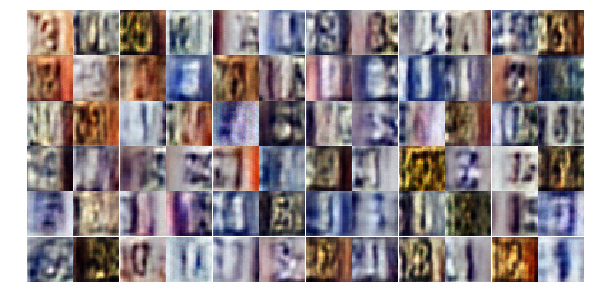

Epoch 4/25... Discriminator Loss: 0.5122... Generator Loss: 1.4468
Epoch 4/25... Discriminator Loss: 0.3839... Generator Loss: 2.6879
Epoch 4/25... Discriminator Loss: 0.3889... Generator Loss: 2.1977
Epoch 4/25... Discriminator Loss: 0.4601... Generator Loss: 1.7223
Epoch 4/25... Discriminator Loss: 0.3134... Generator Loss: 2.0469
Epoch 4/25... Discriminator Loss: 0.4007... Generator Loss: 2.6788
Epoch 4/25... Discriminator Loss: 1.0017... Generator Loss: 0.6247
Epoch 4/25... Discriminator Loss: 0.7404... Generator Loss: 1.2237
Epoch 4/25... Discriminator Loss: 0.5075... Generator Loss: 1.4329
Epoch 4/25... Discriminator Loss: 0.5878... Generator Loss: 2.4112


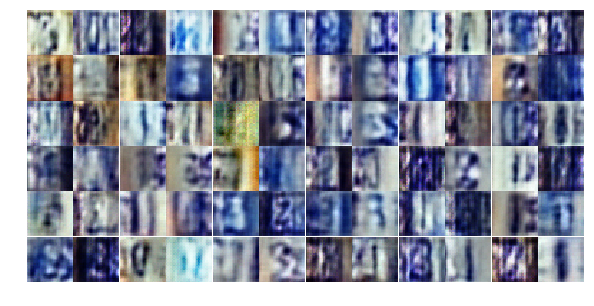

Epoch 4/25... Discriminator Loss: 0.5256... Generator Loss: 1.2391
Epoch 4/25... Discriminator Loss: 0.5689... Generator Loss: 1.5109
Epoch 4/25... Discriminator Loss: 0.4884... Generator Loss: 1.5118
Epoch 4/25... Discriminator Loss: 0.4693... Generator Loss: 1.9458
Epoch 4/25... Discriminator Loss: 0.3381... Generator Loss: 1.7208
Epoch 4/25... Discriminator Loss: 0.3954... Generator Loss: 2.4770
Epoch 4/25... Discriminator Loss: 0.4925... Generator Loss: 1.7611
Epoch 4/25... Discriminator Loss: 1.2999... Generator Loss: 2.7825
Epoch 4/25... Discriminator Loss: 1.0229... Generator Loss: 0.5985
Epoch 4/25... Discriminator Loss: 0.9400... Generator Loss: 0.6877


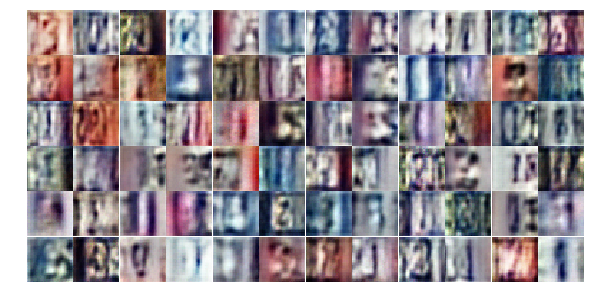

Epoch 4/25... Discriminator Loss: 0.4838... Generator Loss: 1.5651
Epoch 4/25... Discriminator Loss: 0.3386... Generator Loss: 2.0573
Epoch 4/25... Discriminator Loss: 0.8727... Generator Loss: 0.7348
Epoch 4/25... Discriminator Loss: 0.8345... Generator Loss: 0.7654
Epoch 4/25... Discriminator Loss: 0.5327... Generator Loss: 2.1398
Epoch 4/25... Discriminator Loss: 0.8464... Generator Loss: 0.8805
Epoch 4/25... Discriminator Loss: 1.0087... Generator Loss: 0.6847
Epoch 4/25... Discriminator Loss: 0.6670... Generator Loss: 1.3755
Epoch 4/25... Discriminator Loss: 0.4932... Generator Loss: 1.3828
Epoch 4/25... Discriminator Loss: 0.3610... Generator Loss: 2.0649


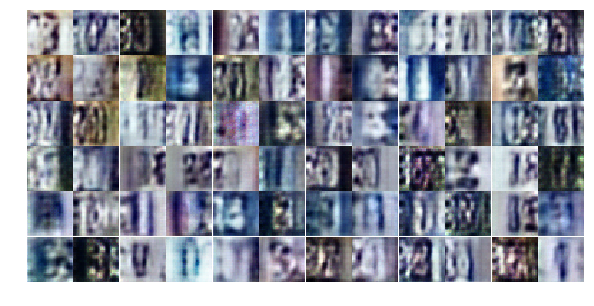

Epoch 4/25... Discriminator Loss: 0.5067... Generator Loss: 1.4484
Epoch 4/25... Discriminator Loss: 0.4747... Generator Loss: 1.2170
Epoch 4/25... Discriminator Loss: 0.5430... Generator Loss: 1.2841
Epoch 4/25... Discriminator Loss: 0.6649... Generator Loss: 2.1039
Epoch 4/25... Discriminator Loss: 0.6100... Generator Loss: 1.0588
Epoch 4/25... Discriminator Loss: 0.4043... Generator Loss: 2.2254
Epoch 4/25... Discriminator Loss: 0.4083... Generator Loss: 1.5376
Epoch 4/25... Discriminator Loss: 0.5415... Generator Loss: 1.9316
Epoch 4/25... Discriminator Loss: 0.8983... Generator Loss: 2.2182
Epoch 5/25... Discriminator Loss: 2.4332... Generator Loss: 4.8080


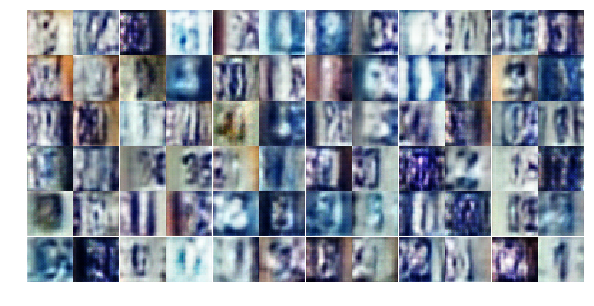

Epoch 5/25... Discriminator Loss: 0.6742... Generator Loss: 1.2101
Epoch 5/25... Discriminator Loss: 0.6545... Generator Loss: 2.2188
Epoch 5/25... Discriminator Loss: 0.4879... Generator Loss: 1.6285
Epoch 5/25... Discriminator Loss: 0.5838... Generator Loss: 1.1051
Epoch 5/25... Discriminator Loss: 0.5417... Generator Loss: 2.3226
Epoch 5/25... Discriminator Loss: 1.1930... Generator Loss: 0.5086
Epoch 5/25... Discriminator Loss: 0.4462... Generator Loss: 1.7513
Epoch 5/25... Discriminator Loss: 0.5359... Generator Loss: 1.1686
Epoch 5/25... Discriminator Loss: 0.5269... Generator Loss: 1.4488
Epoch 5/25... Discriminator Loss: 1.6805... Generator Loss: 0.3134


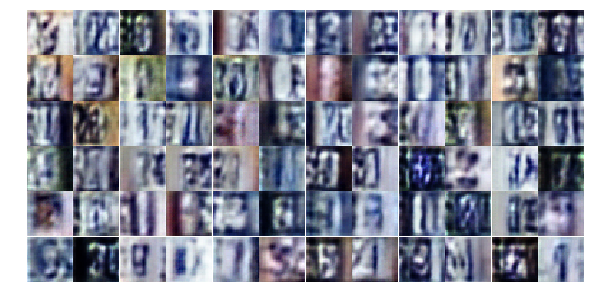

Epoch 5/25... Discriminator Loss: 1.4087... Generator Loss: 0.3944
Epoch 5/25... Discriminator Loss: 0.5172... Generator Loss: 2.0934
Epoch 5/25... Discriminator Loss: 1.0311... Generator Loss: 0.6139
Epoch 5/25... Discriminator Loss: 0.7322... Generator Loss: 1.5868
Epoch 5/25... Discriminator Loss: 0.6299... Generator Loss: 1.7577
Epoch 5/25... Discriminator Loss: 0.6205... Generator Loss: 2.4446
Epoch 5/25... Discriminator Loss: 0.4377... Generator Loss: 1.5519
Epoch 5/25... Discriminator Loss: 0.9366... Generator Loss: 0.7955
Epoch 5/25... Discriminator Loss: 0.4909... Generator Loss: 1.8529
Epoch 5/25... Discriminator Loss: 0.5648... Generator Loss: 1.3860


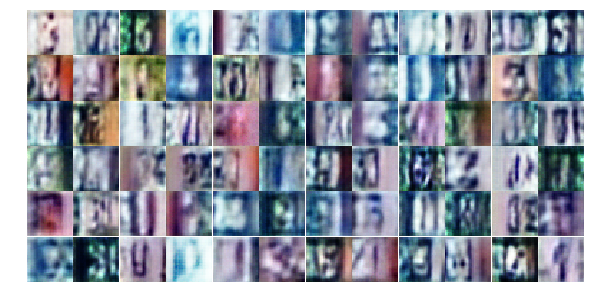

Epoch 5/25... Discriminator Loss: 0.6307... Generator Loss: 1.2958
Epoch 5/25... Discriminator Loss: 0.7437... Generator Loss: 1.2696
Epoch 5/25... Discriminator Loss: 0.4718... Generator Loss: 1.4799
Epoch 5/25... Discriminator Loss: 0.8401... Generator Loss: 1.1902
Epoch 5/25... Discriminator Loss: 0.6751... Generator Loss: 0.9668
Epoch 5/25... Discriminator Loss: 0.5644... Generator Loss: 1.2640
Epoch 5/25... Discriminator Loss: 0.8794... Generator Loss: 0.7452
Epoch 5/25... Discriminator Loss: 1.7856... Generator Loss: 0.2825
Epoch 5/25... Discriminator Loss: 0.7912... Generator Loss: 0.8481
Epoch 5/25... Discriminator Loss: 0.4634... Generator Loss: 1.7497


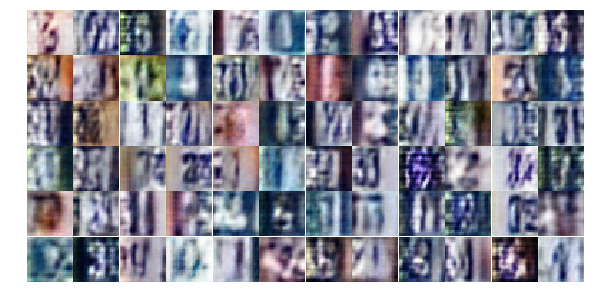

Epoch 5/25... Discriminator Loss: 0.6499... Generator Loss: 1.4246
Epoch 5/25... Discriminator Loss: 0.4864... Generator Loss: 1.4230
Epoch 5/25... Discriminator Loss: 0.5811... Generator Loss: 1.2677
Epoch 5/25... Discriminator Loss: 0.9454... Generator Loss: 0.8176
Epoch 5/25... Discriminator Loss: 0.7745... Generator Loss: 1.5496
Epoch 5/25... Discriminator Loss: 0.6354... Generator Loss: 1.5351
Epoch 5/25... Discriminator Loss: 1.2227... Generator Loss: 0.4747
Epoch 5/25... Discriminator Loss: 0.5012... Generator Loss: 1.4400
Epoch 5/25... Discriminator Loss: 1.0699... Generator Loss: 0.5616
Epoch 5/25... Discriminator Loss: 0.5169... Generator Loss: 1.3479


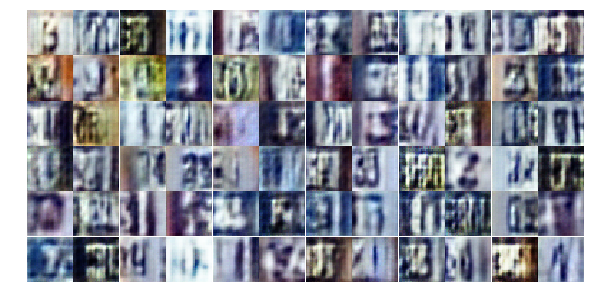

Epoch 5/25... Discriminator Loss: 0.3355... Generator Loss: 2.0057
Epoch 5/25... Discriminator Loss: 0.3453... Generator Loss: 1.7658
Epoch 5/25... Discriminator Loss: 1.3892... Generator Loss: 0.3889
Epoch 5/25... Discriminator Loss: 0.5489... Generator Loss: 1.9804
Epoch 5/25... Discriminator Loss: 0.8889... Generator Loss: 0.9070
Epoch 5/25... Discriminator Loss: 0.4019... Generator Loss: 1.6155
Epoch 5/25... Discriminator Loss: 1.4417... Generator Loss: 0.4372
Epoch 5/25... Discriminator Loss: 0.5297... Generator Loss: 1.8267
Epoch 5/25... Discriminator Loss: 1.3798... Generator Loss: 0.3885
Epoch 5/25... Discriminator Loss: 0.8631... Generator Loss: 0.9974


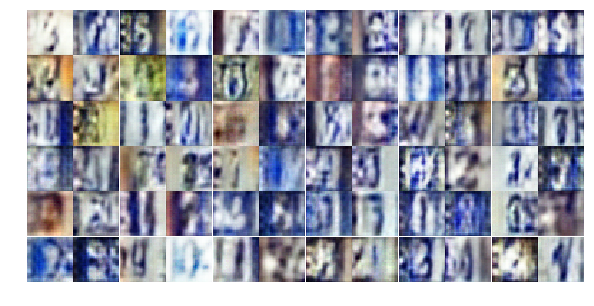

Epoch 5/25... Discriminator Loss: 0.6729... Generator Loss: 1.9558
Epoch 5/25... Discriminator Loss: 0.4248... Generator Loss: 1.6851
Epoch 5/25... Discriminator Loss: 0.7684... Generator Loss: 1.0736
Epoch 5/25... Discriminator Loss: 0.5746... Generator Loss: 1.0688
Epoch 5/25... Discriminator Loss: 0.3773... Generator Loss: 1.9271
Epoch 5/25... Discriminator Loss: 0.5940... Generator Loss: 1.0927
Epoch 6/25... Discriminator Loss: 0.6856... Generator Loss: 0.9781
Epoch 6/25... Discriminator Loss: 0.3977... Generator Loss: 1.4637
Epoch 6/25... Discriminator Loss: 0.7503... Generator Loss: 1.4600
Epoch 6/25... Discriminator Loss: 0.9878... Generator Loss: 2.1103


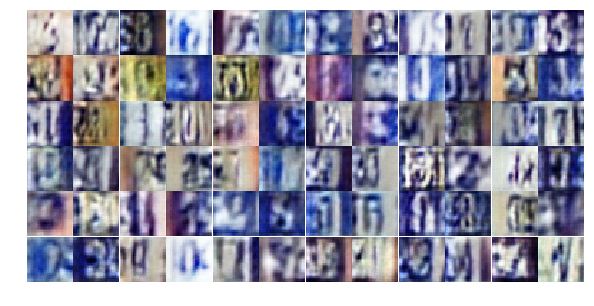

Epoch 6/25... Discriminator Loss: 0.6626... Generator Loss: 1.5719
Epoch 6/25... Discriminator Loss: 0.6488... Generator Loss: 1.4282
Epoch 6/25... Discriminator Loss: 0.4507... Generator Loss: 1.5867
Epoch 6/25... Discriminator Loss: 1.7934... Generator Loss: 0.2699
Epoch 6/25... Discriminator Loss: 0.7688... Generator Loss: 0.9414
Epoch 6/25... Discriminator Loss: 0.5467... Generator Loss: 1.1795
Epoch 6/25... Discriminator Loss: 0.5640... Generator Loss: 1.7668
Epoch 6/25... Discriminator Loss: 0.9210... Generator Loss: 0.8611
Epoch 6/25... Discriminator Loss: 0.8826... Generator Loss: 0.6787
Epoch 6/25... Discriminator Loss: 0.7917... Generator Loss: 0.8137


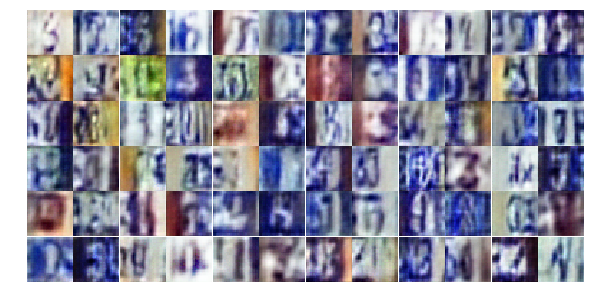

Epoch 6/25... Discriminator Loss: 0.5345... Generator Loss: 1.5943
Epoch 6/25... Discriminator Loss: 0.9792... Generator Loss: 1.6824
Epoch 6/25... Discriminator Loss: 1.6316... Generator Loss: 0.3019
Epoch 6/25... Discriminator Loss: 0.5088... Generator Loss: 1.4592
Epoch 6/25... Discriminator Loss: 0.5170... Generator Loss: 1.6551
Epoch 6/25... Discriminator Loss: 0.8249... Generator Loss: 0.7779
Epoch 6/25... Discriminator Loss: 0.7812... Generator Loss: 0.9816
Epoch 6/25... Discriminator Loss: 0.7997... Generator Loss: 0.8411
Epoch 6/25... Discriminator Loss: 0.8903... Generator Loss: 3.1234
Epoch 6/25... Discriminator Loss: 0.8182... Generator Loss: 1.0198


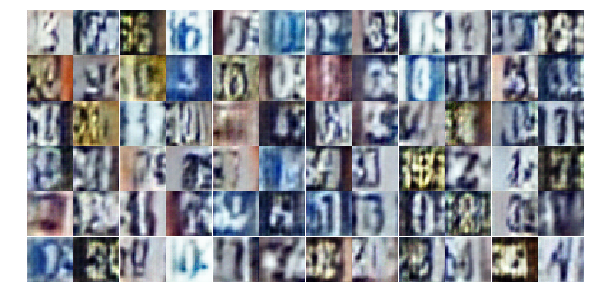

Epoch 6/25... Discriminator Loss: 0.7506... Generator Loss: 0.8465
Epoch 6/25... Discriminator Loss: 0.7782... Generator Loss: 0.9621
Epoch 6/25... Discriminator Loss: 0.6355... Generator Loss: 1.1344
Epoch 6/25... Discriminator Loss: 0.7237... Generator Loss: 2.3274
Epoch 6/25... Discriminator Loss: 0.5362... Generator Loss: 2.1567
Epoch 6/25... Discriminator Loss: 0.8096... Generator Loss: 0.8732
Epoch 6/25... Discriminator Loss: 0.5172... Generator Loss: 1.4045
Epoch 6/25... Discriminator Loss: 0.2294... Generator Loss: 2.3062
Epoch 6/25... Discriminator Loss: 0.5922... Generator Loss: 1.2896
Epoch 6/25... Discriminator Loss: 0.4979... Generator Loss: 1.6816


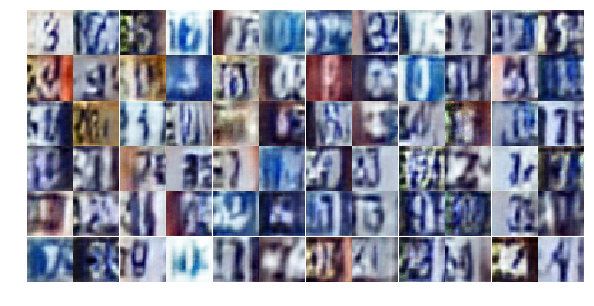

Epoch 6/25... Discriminator Loss: 0.7817... Generator Loss: 0.9950
Epoch 6/25... Discriminator Loss: 0.6903... Generator Loss: 2.0606
Epoch 6/25... Discriminator Loss: 0.6973... Generator Loss: 1.0369
Epoch 6/25... Discriminator Loss: 0.6805... Generator Loss: 0.9011
Epoch 6/25... Discriminator Loss: 0.5438... Generator Loss: 2.6646
Epoch 6/25... Discriminator Loss: 0.5231... Generator Loss: 2.0035
Epoch 6/25... Discriminator Loss: 0.4370... Generator Loss: 1.9521
Epoch 6/25... Discriminator Loss: 1.0774... Generator Loss: 2.8107
Epoch 6/25... Discriminator Loss: 0.6645... Generator Loss: 1.0574
Epoch 6/25... Discriminator Loss: 0.6398... Generator Loss: 1.0792


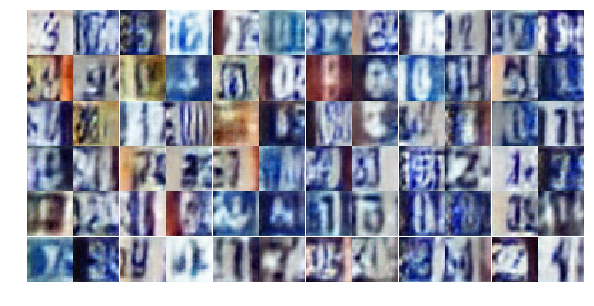

Epoch 6/25... Discriminator Loss: 0.5497... Generator Loss: 1.6548
Epoch 6/25... Discriminator Loss: 0.5654... Generator Loss: 1.3780
Epoch 6/25... Discriminator Loss: 0.8330... Generator Loss: 0.9150
Epoch 6/25... Discriminator Loss: 0.5362... Generator Loss: 1.6396
Epoch 6/25... Discriminator Loss: 0.5408... Generator Loss: 1.5005
Epoch 6/25... Discriminator Loss: 0.5218... Generator Loss: 3.2879
Epoch 6/25... Discriminator Loss: 0.7670... Generator Loss: 0.9728
Epoch 6/25... Discriminator Loss: 0.7638... Generator Loss: 0.8574
Epoch 6/25... Discriminator Loss: 1.0855... Generator Loss: 0.6243
Epoch 6/25... Discriminator Loss: 1.3706... Generator Loss: 0.3777


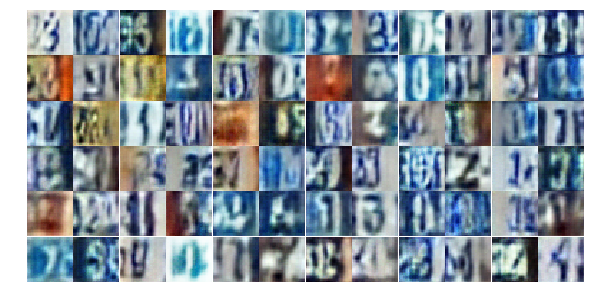

Epoch 6/25... Discriminator Loss: 0.7105... Generator Loss: 2.1761
Epoch 6/25... Discriminator Loss: 0.4623... Generator Loss: 1.4672
Epoch 6/25... Discriminator Loss: 0.6251... Generator Loss: 1.6445
Epoch 7/25... Discriminator Loss: 0.4958... Generator Loss: 2.0975
Epoch 7/25... Discriminator Loss: 0.7217... Generator Loss: 1.3138
Epoch 7/25... Discriminator Loss: 0.6493... Generator Loss: 1.1383
Epoch 7/25... Discriminator Loss: 0.6634... Generator Loss: 0.9624
Epoch 7/25... Discriminator Loss: 0.6076... Generator Loss: 1.3574
Epoch 7/25... Discriminator Loss: 0.4781... Generator Loss: 1.5801
Epoch 7/25... Discriminator Loss: 1.6732... Generator Loss: 0.3159


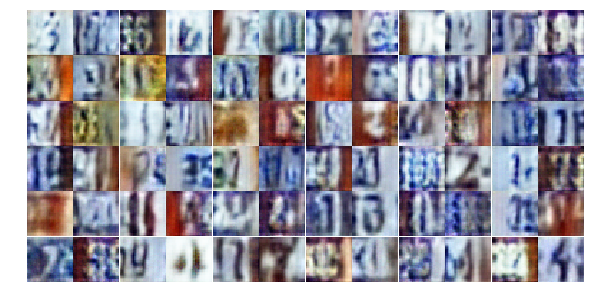

Epoch 7/25... Discriminator Loss: 0.7072... Generator Loss: 1.0674
Epoch 7/25... Discriminator Loss: 0.7042... Generator Loss: 1.0410
Epoch 7/25... Discriminator Loss: 0.8602... Generator Loss: 0.8004
Epoch 7/25... Discriminator Loss: 0.6629... Generator Loss: 1.7838
Epoch 7/25... Discriminator Loss: 0.5809... Generator Loss: 1.4678
Epoch 7/25... Discriminator Loss: 0.4783... Generator Loss: 1.5033
Epoch 7/25... Discriminator Loss: 0.6685... Generator Loss: 1.3982
Epoch 7/25... Discriminator Loss: 0.7315... Generator Loss: 2.3458
Epoch 7/25... Discriminator Loss: 0.7789... Generator Loss: 1.3829
Epoch 7/25... Discriminator Loss: 0.5003... Generator Loss: 1.2757


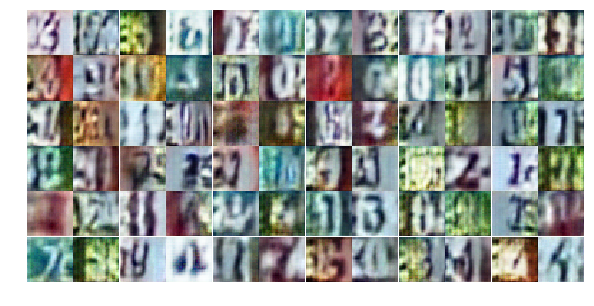

Epoch 7/25... Discriminator Loss: 0.7757... Generator Loss: 1.0531
Epoch 7/25... Discriminator Loss: 0.4676... Generator Loss: 1.7592
Epoch 7/25... Discriminator Loss: 0.6714... Generator Loss: 1.4481
Epoch 7/25... Discriminator Loss: 0.4932... Generator Loss: 1.5754
Epoch 7/25... Discriminator Loss: 0.3914... Generator Loss: 1.5690
Epoch 7/25... Discriminator Loss: 0.6579... Generator Loss: 2.7145
Epoch 7/25... Discriminator Loss: 0.5331... Generator Loss: 1.3278
Epoch 7/25... Discriminator Loss: 0.7492... Generator Loss: 0.9023
Epoch 7/25... Discriminator Loss: 0.5124... Generator Loss: 1.5312
Epoch 7/25... Discriminator Loss: 0.5586... Generator Loss: 1.4632


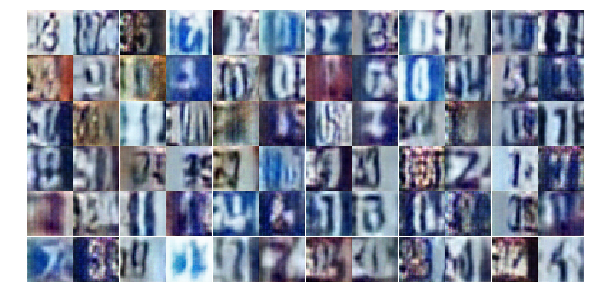

Epoch 7/25... Discriminator Loss: 0.9729... Generator Loss: 0.6388
Epoch 7/25... Discriminator Loss: 1.5758... Generator Loss: 0.3404
Epoch 7/25... Discriminator Loss: 0.5575... Generator Loss: 1.5085
Epoch 7/25... Discriminator Loss: 0.6780... Generator Loss: 1.0334
Epoch 7/25... Discriminator Loss: 0.6343... Generator Loss: 1.0481
Epoch 7/25... Discriminator Loss: 0.7266... Generator Loss: 1.0148
Epoch 7/25... Discriminator Loss: 0.4512... Generator Loss: 1.4219
Epoch 7/25... Discriminator Loss: 0.4582... Generator Loss: 1.4845
Epoch 7/25... Discriminator Loss: 0.8064... Generator Loss: 0.8795
Epoch 7/25... Discriminator Loss: 0.5126... Generator Loss: 2.5229


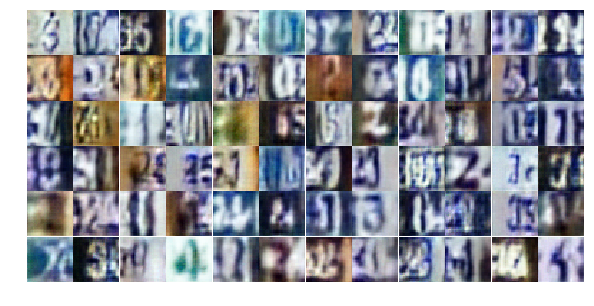

Epoch 7/25... Discriminator Loss: 0.9992... Generator Loss: 0.6297
Epoch 7/25... Discriminator Loss: 0.9217... Generator Loss: 0.6766
Epoch 7/25... Discriminator Loss: 0.5361... Generator Loss: 1.5101
Epoch 7/25... Discriminator Loss: 0.6228... Generator Loss: 2.3815
Epoch 7/25... Discriminator Loss: 0.7229... Generator Loss: 0.9447
Epoch 7/25... Discriminator Loss: 0.4350... Generator Loss: 1.5931
Epoch 7/25... Discriminator Loss: 0.6020... Generator Loss: 1.0823
Epoch 7/25... Discriminator Loss: 0.8181... Generator Loss: 1.3861
Epoch 7/25... Discriminator Loss: 0.3934... Generator Loss: 1.7586
Epoch 7/25... Discriminator Loss: 0.5886... Generator Loss: 1.1581


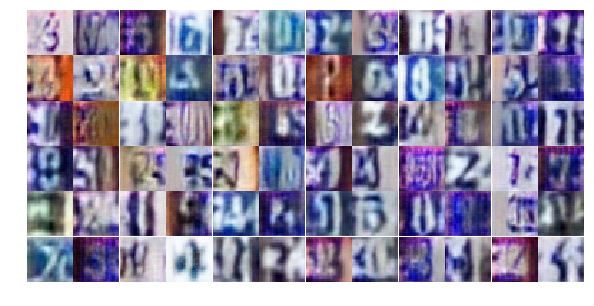

Epoch 7/25... Discriminator Loss: 0.3195... Generator Loss: 1.7841
Epoch 7/25... Discriminator Loss: 0.9727... Generator Loss: 0.5825
Epoch 7/25... Discriminator Loss: 0.8051... Generator Loss: 1.6860
Epoch 7/25... Discriminator Loss: 0.6338... Generator Loss: 1.3261
Epoch 7/25... Discriminator Loss: 0.5253... Generator Loss: 1.3346
Epoch 7/25... Discriminator Loss: 0.3978... Generator Loss: 1.7030
Epoch 7/25... Discriminator Loss: 1.4711... Generator Loss: 0.3451
Epoch 7/25... Discriminator Loss: 1.4759... Generator Loss: 0.3593
Epoch 7/25... Discriminator Loss: 1.2791... Generator Loss: 0.4571
Epoch 7/25... Discriminator Loss: 0.5827... Generator Loss: 1.1502


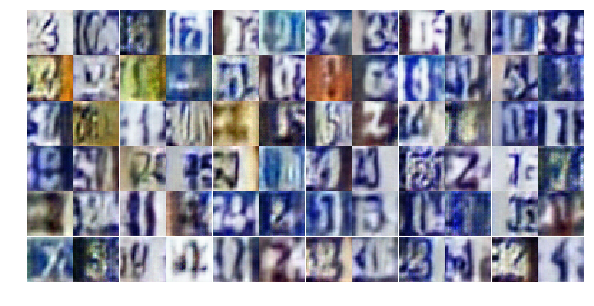

Epoch 7/25... Discriminator Loss: 0.4890... Generator Loss: 2.0661
Epoch 8/25... Discriminator Loss: 0.9743... Generator Loss: 0.6669
Epoch 8/25... Discriminator Loss: 0.6071... Generator Loss: 1.0053
Epoch 8/25... Discriminator Loss: 0.6257... Generator Loss: 1.1547
Epoch 8/25... Discriminator Loss: 0.4313... Generator Loss: 1.4724
Epoch 8/25... Discriminator Loss: 0.6871... Generator Loss: 1.0302
Epoch 8/25... Discriminator Loss: 1.1763... Generator Loss: 0.5784
Epoch 8/25... Discriminator Loss: 0.6226... Generator Loss: 2.5195
Epoch 8/25... Discriminator Loss: 0.7321... Generator Loss: 1.0194
Epoch 8/25... Discriminator Loss: 0.9646... Generator Loss: 0.6511


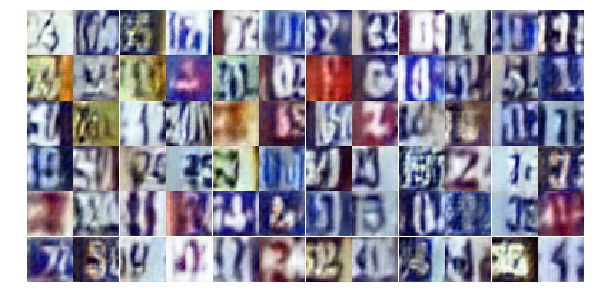

Epoch 8/25... Discriminator Loss: 0.3420... Generator Loss: 2.0598
Epoch 8/25... Discriminator Loss: 0.4762... Generator Loss: 1.4796
Epoch 8/25... Discriminator Loss: 0.9112... Generator Loss: 0.7926
Epoch 8/25... Discriminator Loss: 0.3895... Generator Loss: 2.1774
Epoch 8/25... Discriminator Loss: 0.9840... Generator Loss: 0.6339
Epoch 8/25... Discriminator Loss: 0.7095... Generator Loss: 2.1663
Epoch 8/25... Discriminator Loss: 0.5087... Generator Loss: 1.2799
Epoch 8/25... Discriminator Loss: 1.9604... Generator Loss: 0.2181
Epoch 8/25... Discriminator Loss: 0.7827... Generator Loss: 0.8743
Epoch 8/25... Discriminator Loss: 1.6282... Generator Loss: 0.3072


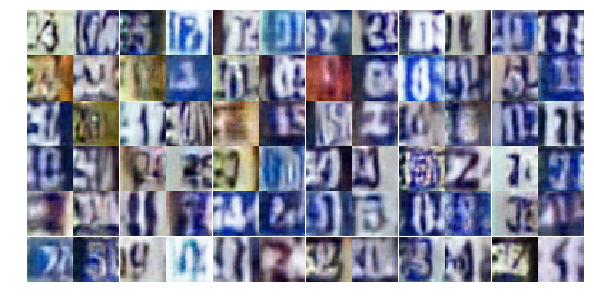

Epoch 8/25... Discriminator Loss: 0.5115... Generator Loss: 1.5060
Epoch 8/25... Discriminator Loss: 0.5037... Generator Loss: 1.2313
Epoch 8/25... Discriminator Loss: 0.8733... Generator Loss: 0.8568
Epoch 8/25... Discriminator Loss: 0.4616... Generator Loss: 1.6636
Epoch 8/25... Discriminator Loss: 0.4836... Generator Loss: 1.5217
Epoch 8/25... Discriminator Loss: 0.5132... Generator Loss: 1.3598
Epoch 8/25... Discriminator Loss: 0.5062... Generator Loss: 1.6063
Epoch 8/25... Discriminator Loss: 0.5617... Generator Loss: 1.3974
Epoch 8/25... Discriminator Loss: 0.6982... Generator Loss: 2.2185
Epoch 8/25... Discriminator Loss: 0.7585... Generator Loss: 0.9089


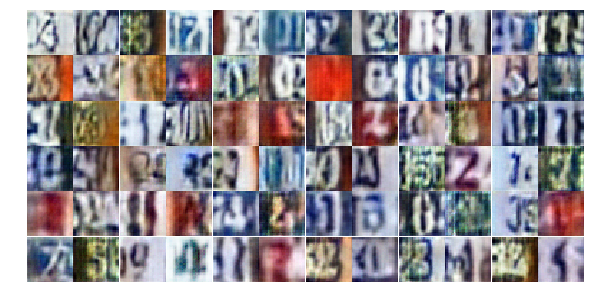

Epoch 8/25... Discriminator Loss: 0.6344... Generator Loss: 1.2252
Epoch 8/25... Discriminator Loss: 1.0165... Generator Loss: 0.5907
Epoch 8/25... Discriminator Loss: 0.5513... Generator Loss: 1.4534
Epoch 8/25... Discriminator Loss: 0.4277... Generator Loss: 1.4082
Epoch 8/25... Discriminator Loss: 0.6381... Generator Loss: 1.0151
Epoch 8/25... Discriminator Loss: 0.9051... Generator Loss: 0.7139
Epoch 8/25... Discriminator Loss: 0.5241... Generator Loss: 1.5958
Epoch 8/25... Discriminator Loss: 0.7147... Generator Loss: 1.0075
Epoch 8/25... Discriminator Loss: 0.7927... Generator Loss: 0.8136
Epoch 8/25... Discriminator Loss: 0.4985... Generator Loss: 1.3669


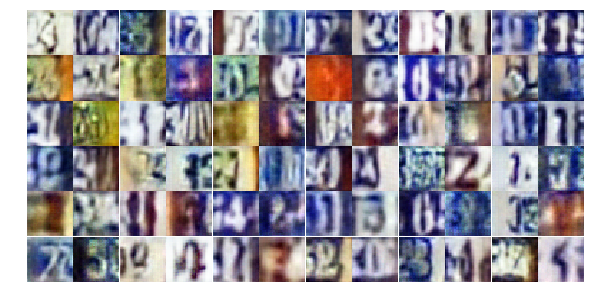

Epoch 8/25... Discriminator Loss: 0.4760... Generator Loss: 2.0135
Epoch 8/25... Discriminator Loss: 0.9037... Generator Loss: 0.7099
Epoch 8/25... Discriminator Loss: 0.5008... Generator Loss: 1.3645
Epoch 8/25... Discriminator Loss: 0.4427... Generator Loss: 1.7586
Epoch 8/25... Discriminator Loss: 0.6537... Generator Loss: 1.8273
Epoch 8/25... Discriminator Loss: 0.9377... Generator Loss: 0.6414
Epoch 8/25... Discriminator Loss: 0.4859... Generator Loss: 1.4715
Epoch 8/25... Discriminator Loss: 0.5216... Generator Loss: 2.1448
Epoch 8/25... Discriminator Loss: 1.8729... Generator Loss: 3.9171
Epoch 8/25... Discriminator Loss: 0.7393... Generator Loss: 0.9615


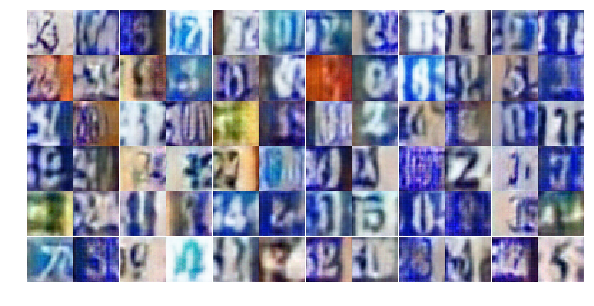

Epoch 8/25... Discriminator Loss: 0.4342... Generator Loss: 1.7323
Epoch 8/25... Discriminator Loss: 0.6025... Generator Loss: 1.1500
Epoch 8/25... Discriminator Loss: 0.5235... Generator Loss: 2.0887
Epoch 8/25... Discriminator Loss: 0.7679... Generator Loss: 0.9933
Epoch 8/25... Discriminator Loss: 0.5428... Generator Loss: 1.9273
Epoch 8/25... Discriminator Loss: 0.9978... Generator Loss: 0.7222
Epoch 8/25... Discriminator Loss: 0.5534... Generator Loss: 1.5747
Epoch 8/25... Discriminator Loss: 0.6765... Generator Loss: 2.6598
Epoch 9/25... Discriminator Loss: 0.8201... Generator Loss: 1.0436
Epoch 9/25... Discriminator Loss: 0.7736... Generator Loss: 0.8421


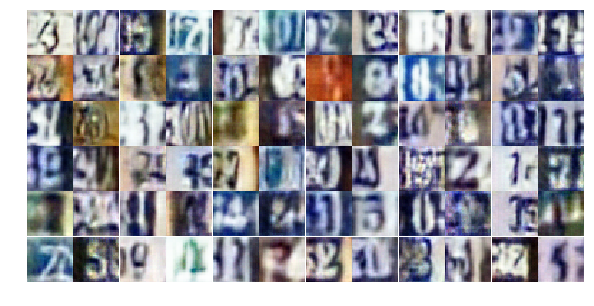

Epoch 9/25... Discriminator Loss: 0.8133... Generator Loss: 0.8390
Epoch 9/25... Discriminator Loss: 0.8268... Generator Loss: 1.7501
Epoch 9/25... Discriminator Loss: 0.7290... Generator Loss: 1.1181
Epoch 9/25... Discriminator Loss: 0.4401... Generator Loss: 1.8125
Epoch 9/25... Discriminator Loss: 1.1152... Generator Loss: 0.5302
Epoch 9/25... Discriminator Loss: 0.5976... Generator Loss: 1.7498
Epoch 9/25... Discriminator Loss: 0.7163... Generator Loss: 1.1459
Epoch 9/25... Discriminator Loss: 0.6347... Generator Loss: 1.0711
Epoch 9/25... Discriminator Loss: 1.0637... Generator Loss: 0.6349
Epoch 9/25... Discriminator Loss: 0.5778... Generator Loss: 1.6473


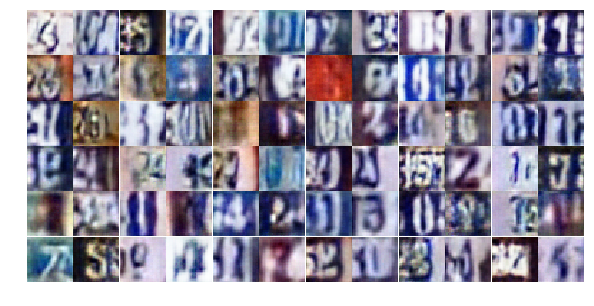

Epoch 9/25... Discriminator Loss: 0.9280... Generator Loss: 0.7086
Epoch 9/25... Discriminator Loss: 0.6881... Generator Loss: 1.1759
Epoch 9/25... Discriminator Loss: 0.6490... Generator Loss: 1.1836
Epoch 9/25... Discriminator Loss: 1.0978... Generator Loss: 0.6767
Epoch 9/25... Discriminator Loss: 0.5071... Generator Loss: 1.4945
Epoch 9/25... Discriminator Loss: 0.7736... Generator Loss: 0.9505
Epoch 9/25... Discriminator Loss: 0.8641... Generator Loss: 0.7409
Epoch 9/25... Discriminator Loss: 0.5179... Generator Loss: 1.3646
Epoch 9/25... Discriminator Loss: 1.2357... Generator Loss: 0.4794
Epoch 9/25... Discriminator Loss: 0.8114... Generator Loss: 0.9060


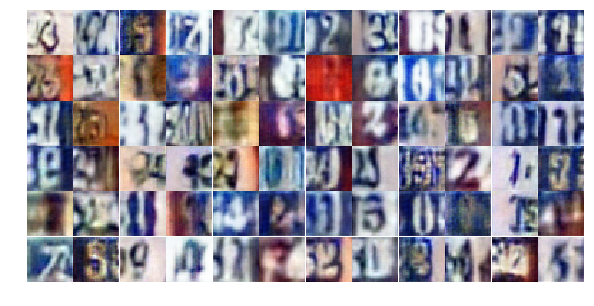

Epoch 9/25... Discriminator Loss: 0.8983... Generator Loss: 0.8297
Epoch 9/25... Discriminator Loss: 0.9065... Generator Loss: 0.7513
Epoch 9/25... Discriminator Loss: 0.5259... Generator Loss: 1.4158
Epoch 9/25... Discriminator Loss: 0.7317... Generator Loss: 0.9277
Epoch 9/25... Discriminator Loss: 0.5689... Generator Loss: 1.8178
Epoch 9/25... Discriminator Loss: 0.5009... Generator Loss: 1.7903
Epoch 9/25... Discriminator Loss: 1.2458... Generator Loss: 0.6697
Epoch 9/25... Discriminator Loss: 0.6428... Generator Loss: 1.2898
Epoch 9/25... Discriminator Loss: 0.5887... Generator Loss: 1.3176
Epoch 9/25... Discriminator Loss: 0.6100... Generator Loss: 1.0998


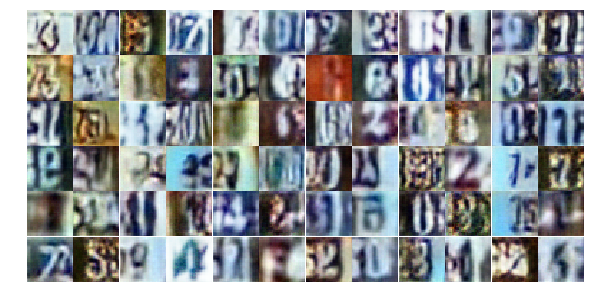

Epoch 9/25... Discriminator Loss: 0.6138... Generator Loss: 1.1449
Epoch 9/25... Discriminator Loss: 0.8084... Generator Loss: 0.8677
Epoch 9/25... Discriminator Loss: 0.8075... Generator Loss: 0.8488
Epoch 9/25... Discriminator Loss: 0.6664... Generator Loss: 1.2362
Epoch 9/25... Discriminator Loss: 1.3657... Generator Loss: 3.5057
Epoch 9/25... Discriminator Loss: 0.6675... Generator Loss: 1.0178
Epoch 9/25... Discriminator Loss: 0.6118... Generator Loss: 1.2400
Epoch 9/25... Discriminator Loss: 0.4367... Generator Loss: 1.5611
Epoch 9/25... Discriminator Loss: 0.9396... Generator Loss: 0.6973
Epoch 9/25... Discriminator Loss: 0.8540... Generator Loss: 0.7616


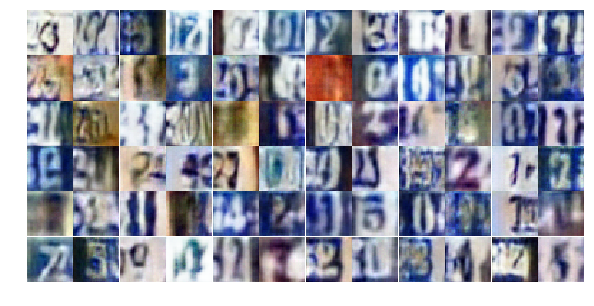

Epoch 9/25... Discriminator Loss: 0.6436... Generator Loss: 1.0406
Epoch 9/25... Discriminator Loss: 0.7641... Generator Loss: 0.8913
Epoch 9/25... Discriminator Loss: 0.5415... Generator Loss: 2.1549
Epoch 9/25... Discriminator Loss: 0.6761... Generator Loss: 1.5625
Epoch 9/25... Discriminator Loss: 0.4521... Generator Loss: 2.6384
Epoch 9/25... Discriminator Loss: 0.8159... Generator Loss: 0.8343
Epoch 9/25... Discriminator Loss: 0.6540... Generator Loss: 1.0828
Epoch 9/25... Discriminator Loss: 1.4899... Generator Loss: 0.3118
Epoch 9/25... Discriminator Loss: 0.6348... Generator Loss: 1.1568
Epoch 9/25... Discriminator Loss: 0.4992... Generator Loss: 1.7542


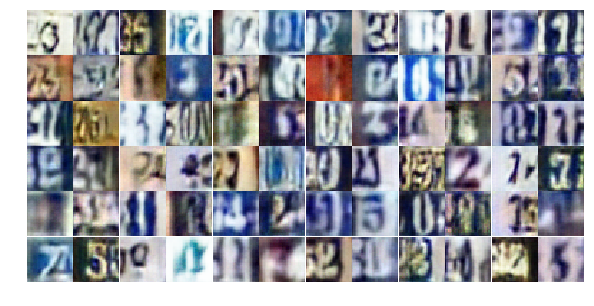

Epoch 9/25... Discriminator Loss: 0.7575... Generator Loss: 1.0302
Epoch 9/25... Discriminator Loss: 3.3507... Generator Loss: 4.4575
Epoch 9/25... Discriminator Loss: 0.6930... Generator Loss: 1.0132
Epoch 9/25... Discriminator Loss: 1.9957... Generator Loss: 0.1873
Epoch 9/25... Discriminator Loss: 0.7083... Generator Loss: 1.1498
Epoch 10/25... Discriminator Loss: 0.6935... Generator Loss: 1.5340
Epoch 10/25... Discriminator Loss: 0.6560... Generator Loss: 1.0507
Epoch 10/25... Discriminator Loss: 0.8953... Generator Loss: 0.7185
Epoch 10/25... Discriminator Loss: 0.6954... Generator Loss: 0.9611
Epoch 10/25... Discriminator Loss: 1.1842... Generator Loss: 0.5523


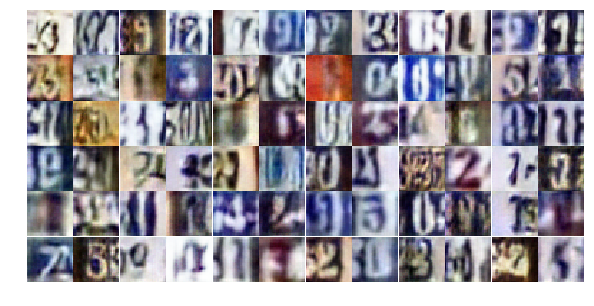

Epoch 10/25... Discriminator Loss: 1.2021... Generator Loss: 0.4810
Epoch 10/25... Discriminator Loss: 0.5769... Generator Loss: 1.1266
Epoch 10/25... Discriminator Loss: 0.7019... Generator Loss: 1.0296
Epoch 10/25... Discriminator Loss: 0.6084... Generator Loss: 1.3909
Epoch 10/25... Discriminator Loss: 0.7428... Generator Loss: 0.9825
Epoch 10/25... Discriminator Loss: 0.7400... Generator Loss: 0.9377
Epoch 10/25... Discriminator Loss: 0.5140... Generator Loss: 1.4902
Epoch 10/25... Discriminator Loss: 1.6477... Generator Loss: 0.3200
Epoch 10/25... Discriminator Loss: 1.4109... Generator Loss: 0.5076
Epoch 10/25... Discriminator Loss: 0.6322... Generator Loss: 1.5353


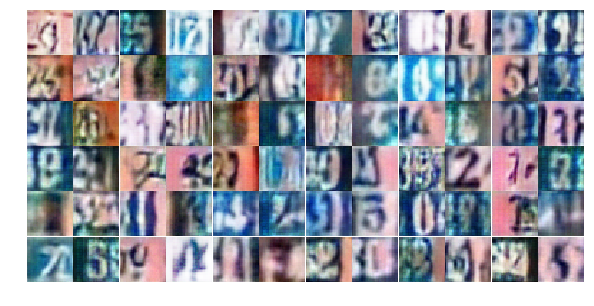

Epoch 10/25... Discriminator Loss: 0.6181... Generator Loss: 1.5712
Epoch 10/25... Discriminator Loss: 0.8234... Generator Loss: 0.9977
Epoch 10/25... Discriminator Loss: 0.7786... Generator Loss: 0.9334
Epoch 10/25... Discriminator Loss: 1.3626... Generator Loss: 0.4271
Epoch 10/25... Discriminator Loss: 0.7798... Generator Loss: 0.9739
Epoch 10/25... Discriminator Loss: 0.4232... Generator Loss: 1.5774
Epoch 10/25... Discriminator Loss: 0.9960... Generator Loss: 0.6259
Epoch 10/25... Discriminator Loss: 0.5948... Generator Loss: 1.6113
Epoch 10/25... Discriminator Loss: 0.7240... Generator Loss: 1.0816
Epoch 10/25... Discriminator Loss: 0.3830... Generator Loss: 2.1874


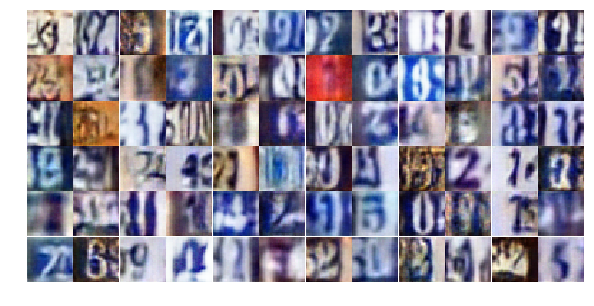

Epoch 10/25... Discriminator Loss: 1.0729... Generator Loss: 0.5454
Epoch 10/25... Discriminator Loss: 1.3943... Generator Loss: 0.4360
Epoch 10/25... Discriminator Loss: 0.4552... Generator Loss: 1.6301
Epoch 10/25... Discriminator Loss: 0.4771... Generator Loss: 2.2833
Epoch 10/25... Discriminator Loss: 1.1459... Generator Loss: 0.4736
Epoch 10/25... Discriminator Loss: 0.6335... Generator Loss: 1.1386
Epoch 10/25... Discriminator Loss: 0.4745... Generator Loss: 1.5474
Epoch 10/25... Discriminator Loss: 0.7374... Generator Loss: 0.9481
Epoch 10/25... Discriminator Loss: 0.7264... Generator Loss: 0.9129
Epoch 10/25... Discriminator Loss: 1.0087... Generator Loss: 2.1608


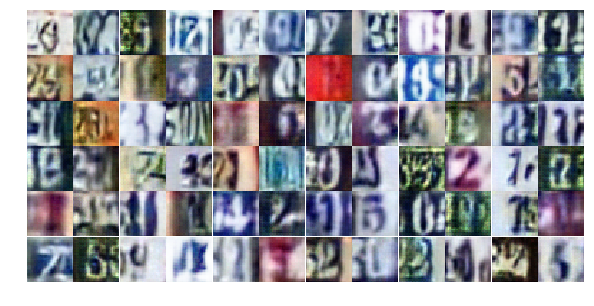

Epoch 10/25... Discriminator Loss: 0.7196... Generator Loss: 1.5405
Epoch 10/25... Discriminator Loss: 0.9673... Generator Loss: 0.7303
Epoch 10/25... Discriminator Loss: 0.4706... Generator Loss: 2.1121
Epoch 10/25... Discriminator Loss: 0.5995... Generator Loss: 1.5202
Epoch 10/25... Discriminator Loss: 0.9393... Generator Loss: 0.6425
Epoch 10/25... Discriminator Loss: 0.6697... Generator Loss: 1.0811
Epoch 10/25... Discriminator Loss: 0.6790... Generator Loss: 0.9952
Epoch 10/25... Discriminator Loss: 0.8872... Generator Loss: 0.7190
Epoch 10/25... Discriminator Loss: 0.9311... Generator Loss: 0.7529
Epoch 10/25... Discriminator Loss: 1.0533... Generator Loss: 2.4063


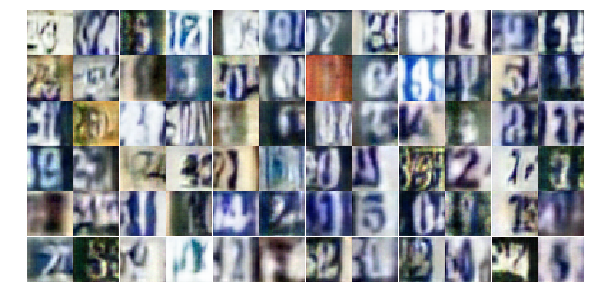

Epoch 10/25... Discriminator Loss: 0.9284... Generator Loss: 0.7580
Epoch 10/25... Discriminator Loss: 0.5897... Generator Loss: 1.6081
Epoch 10/25... Discriminator Loss: 1.2736... Generator Loss: 0.5392
Epoch 10/25... Discriminator Loss: 0.7516... Generator Loss: 1.1391
Epoch 10/25... Discriminator Loss: 0.4356... Generator Loss: 1.6071
Epoch 10/25... Discriminator Loss: 0.5175... Generator Loss: 1.2768
Epoch 10/25... Discriminator Loss: 0.6439... Generator Loss: 1.1144
Epoch 10/25... Discriminator Loss: 0.6133... Generator Loss: 1.2999
Epoch 10/25... Discriminator Loss: 0.7884... Generator Loss: 1.5778
Epoch 10/25... Discriminator Loss: 0.5321... Generator Loss: 1.7736


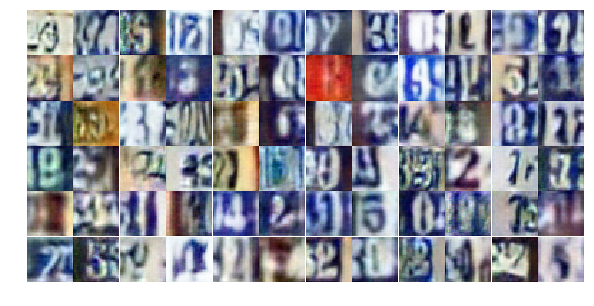

Epoch 10/25... Discriminator Loss: 1.1629... Generator Loss: 0.5436
Epoch 10/25... Discriminator Loss: 0.6398... Generator Loss: 1.0599
Epoch 10/25... Discriminator Loss: 0.3783... Generator Loss: 1.5319
Epoch 11/25... Discriminator Loss: 1.0412... Generator Loss: 0.6267
Epoch 11/25... Discriminator Loss: 0.6098... Generator Loss: 1.2449
Epoch 11/25... Discriminator Loss: 1.1946... Generator Loss: 0.4638
Epoch 11/25... Discriminator Loss: 0.8617... Generator Loss: 0.7114
Epoch 11/25... Discriminator Loss: 0.6151... Generator Loss: 1.5174
Epoch 11/25... Discriminator Loss: 1.3568... Generator Loss: 0.3848
Epoch 11/25... Discriminator Loss: 0.5060... Generator Loss: 1.5450


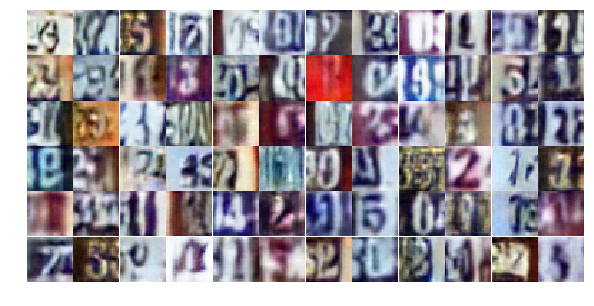

Epoch 11/25... Discriminator Loss: 0.3939... Generator Loss: 1.6268
Epoch 11/25... Discriminator Loss: 0.5180... Generator Loss: 1.4278
Epoch 11/25... Discriminator Loss: 0.3936... Generator Loss: 1.5949
Epoch 11/25... Discriminator Loss: 0.7176... Generator Loss: 0.9210
Epoch 11/25... Discriminator Loss: 1.0823... Generator Loss: 0.5680
Epoch 11/25... Discriminator Loss: 0.6265... Generator Loss: 1.1925
Epoch 11/25... Discriminator Loss: 0.5739... Generator Loss: 1.6392
Epoch 11/25... Discriminator Loss: 0.4015... Generator Loss: 1.9412
Epoch 11/25... Discriminator Loss: 0.5034... Generator Loss: 1.3642
Epoch 11/25... Discriminator Loss: 1.3391... Generator Loss: 0.5007


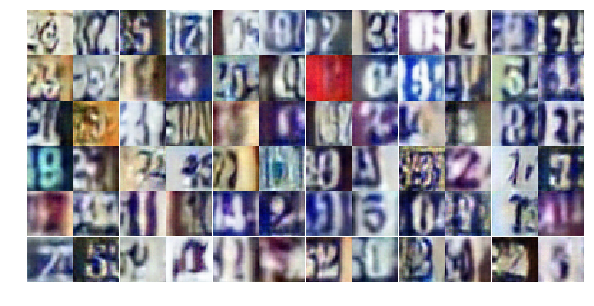

Epoch 11/25... Discriminator Loss: 0.8581... Generator Loss: 0.9042
Epoch 11/25... Discriminator Loss: 0.5126... Generator Loss: 2.0144
Epoch 11/25... Discriminator Loss: 0.7521... Generator Loss: 0.8948
Epoch 11/25... Discriminator Loss: 1.3402... Generator Loss: 0.4044
Epoch 11/25... Discriminator Loss: 0.4541... Generator Loss: 1.4994
Epoch 11/25... Discriminator Loss: 0.4311... Generator Loss: 2.0011
Epoch 11/25... Discriminator Loss: 0.8628... Generator Loss: 0.7846
Epoch 11/25... Discriminator Loss: 0.7912... Generator Loss: 1.3262
Epoch 11/25... Discriminator Loss: 0.4769... Generator Loss: 1.7041
Epoch 11/25... Discriminator Loss: 1.0051... Generator Loss: 0.6086


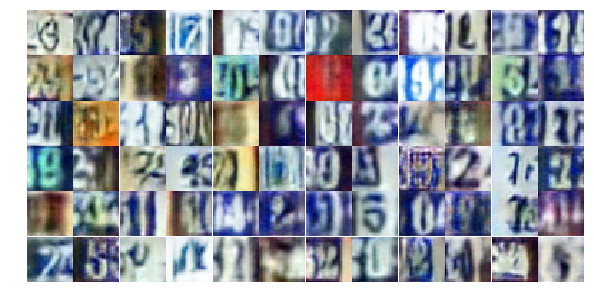

Epoch 11/25... Discriminator Loss: 0.7511... Generator Loss: 1.4954
Epoch 11/25... Discriminator Loss: 0.6767... Generator Loss: 1.0251
Epoch 11/25... Discriminator Loss: 0.8828... Generator Loss: 0.7861
Epoch 11/25... Discriminator Loss: 0.5057... Generator Loss: 1.2027
Epoch 11/25... Discriminator Loss: 0.6832... Generator Loss: 1.0435
Epoch 11/25... Discriminator Loss: 1.0039... Generator Loss: 0.6670
Epoch 11/25... Discriminator Loss: 1.6536... Generator Loss: 0.2975
Epoch 11/25... Discriminator Loss: 1.4414... Generator Loss: 0.4621
Epoch 11/25... Discriminator Loss: 0.5221... Generator Loss: 1.4538
Epoch 11/25... Discriminator Loss: 0.8382... Generator Loss: 0.7938


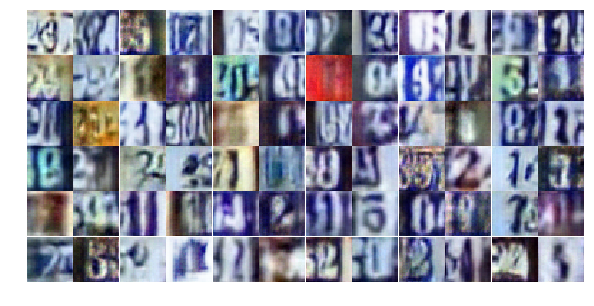

Epoch 11/25... Discriminator Loss: 0.5010... Generator Loss: 1.4996
Epoch 11/25... Discriminator Loss: 0.6253... Generator Loss: 1.0854
Epoch 11/25... Discriminator Loss: 0.6424... Generator Loss: 1.1316
Epoch 11/25... Discriminator Loss: 1.0269... Generator Loss: 1.7369
Epoch 11/25... Discriminator Loss: 1.1875... Generator Loss: 0.4799
Epoch 11/25... Discriminator Loss: 0.7138... Generator Loss: 0.9661
Epoch 11/25... Discriminator Loss: 0.3299... Generator Loss: 1.5946
Epoch 11/25... Discriminator Loss: 0.7437... Generator Loss: 0.8974
Epoch 11/25... Discriminator Loss: 1.6059... Generator Loss: 0.3003
Epoch 11/25... Discriminator Loss: 0.7095... Generator Loss: 0.9994


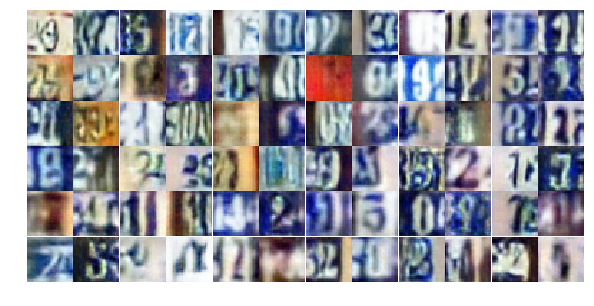

Epoch 11/25... Discriminator Loss: 0.8628... Generator Loss: 0.7354
Epoch 11/25... Discriminator Loss: 0.4684... Generator Loss: 1.7292
Epoch 11/25... Discriminator Loss: 0.9140... Generator Loss: 0.7966
Epoch 11/25... Discriminator Loss: 0.6335... Generator Loss: 1.0375
Epoch 11/25... Discriminator Loss: 0.9319... Generator Loss: 0.7360
Epoch 11/25... Discriminator Loss: 0.6782... Generator Loss: 1.0293
Epoch 11/25... Discriminator Loss: 1.7286... Generator Loss: 0.3366
Epoch 11/25... Discriminator Loss: 0.5475... Generator Loss: 1.9818
Epoch 11/25... Discriminator Loss: 0.8896... Generator Loss: 0.8034
Epoch 11/25... Discriminator Loss: 0.6318... Generator Loss: 1.1906


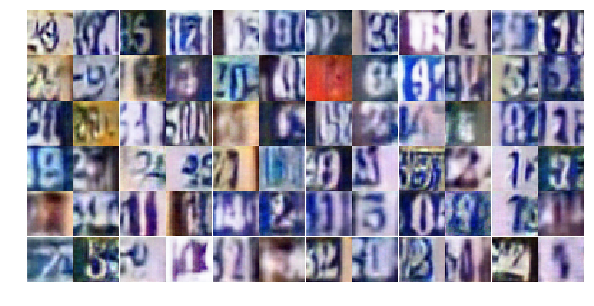

Epoch 12/25... Discriminator Loss: 0.6957... Generator Loss: 1.3881
Epoch 12/25... Discriminator Loss: 0.5378... Generator Loss: 1.2834
Epoch 12/25... Discriminator Loss: 0.9047... Generator Loss: 0.9316
Epoch 12/25... Discriminator Loss: 0.5052... Generator Loss: 1.8115
Epoch 12/25... Discriminator Loss: 0.4193... Generator Loss: 1.8511
Epoch 12/25... Discriminator Loss: 0.5861... Generator Loss: 1.1512
Epoch 12/25... Discriminator Loss: 0.6379... Generator Loss: 1.1953
Epoch 12/25... Discriminator Loss: 0.5738... Generator Loss: 1.2567
Epoch 12/25... Discriminator Loss: 0.8481... Generator Loss: 0.8041
Epoch 12/25... Discriminator Loss: 1.2211... Generator Loss: 0.5290


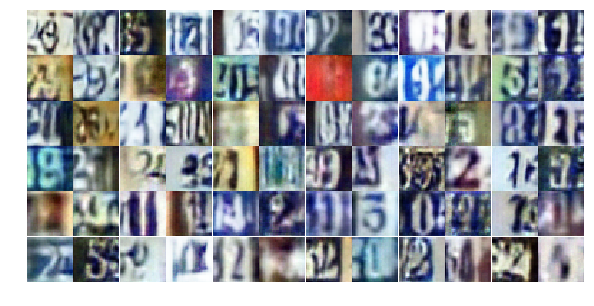

Epoch 12/25... Discriminator Loss: 0.3912... Generator Loss: 1.6027
Epoch 12/25... Discriminator Loss: 1.4530... Generator Loss: 0.3878
Epoch 12/25... Discriminator Loss: 1.3442... Generator Loss: 0.9252
Epoch 12/25... Discriminator Loss: 0.8416... Generator Loss: 1.6207
Epoch 12/25... Discriminator Loss: 0.4675... Generator Loss: 1.4740
Epoch 12/25... Discriminator Loss: 0.8032... Generator Loss: 0.9768
Epoch 12/25... Discriminator Loss: 1.2055... Generator Loss: 0.5115
Epoch 12/25... Discriminator Loss: 0.4684... Generator Loss: 1.7293
Epoch 12/25... Discriminator Loss: 0.7701... Generator Loss: 0.8524
Epoch 12/25... Discriminator Loss: 0.7173... Generator Loss: 1.3544


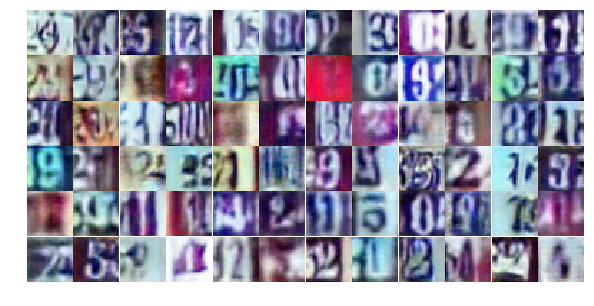

Epoch 12/25... Discriminator Loss: 0.3793... Generator Loss: 2.0669
Epoch 12/25... Discriminator Loss: 0.5946... Generator Loss: 2.3679
Epoch 12/25... Discriminator Loss: 0.8876... Generator Loss: 0.8005
Epoch 12/25... Discriminator Loss: 0.5447... Generator Loss: 1.7261
Epoch 12/25... Discriminator Loss: 0.2916... Generator Loss: 2.2810
Epoch 12/25... Discriminator Loss: 0.5176... Generator Loss: 1.2673
Epoch 12/25... Discriminator Loss: 0.4779... Generator Loss: 1.6710
Epoch 12/25... Discriminator Loss: 0.4108... Generator Loss: 1.9324
Epoch 12/25... Discriminator Loss: 0.5149... Generator Loss: 1.2450
Epoch 12/25... Discriminator Loss: 0.8538... Generator Loss: 0.8210


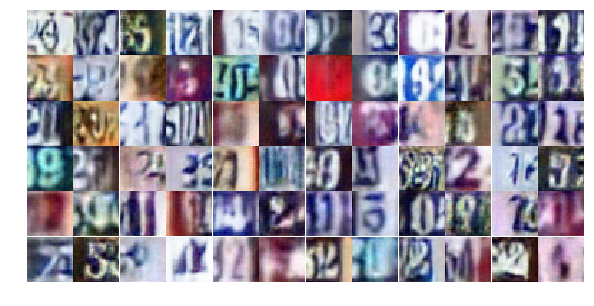

Epoch 12/25... Discriminator Loss: 0.8602... Generator Loss: 0.8220
Epoch 12/25... Discriminator Loss: 0.8982... Generator Loss: 0.7551
Epoch 12/25... Discriminator Loss: 0.8831... Generator Loss: 0.7674
Epoch 12/25... Discriminator Loss: 1.2888... Generator Loss: 0.4237
Epoch 12/25... Discriminator Loss: 0.9815... Generator Loss: 2.4019
Epoch 12/25... Discriminator Loss: 2.0056... Generator Loss: 0.1987
Epoch 12/25... Discriminator Loss: 0.9625... Generator Loss: 0.7064
Epoch 12/25... Discriminator Loss: 1.1003... Generator Loss: 0.5352
Epoch 12/25... Discriminator Loss: 0.5303... Generator Loss: 1.4008
Epoch 12/25... Discriminator Loss: 0.3152... Generator Loss: 1.8437


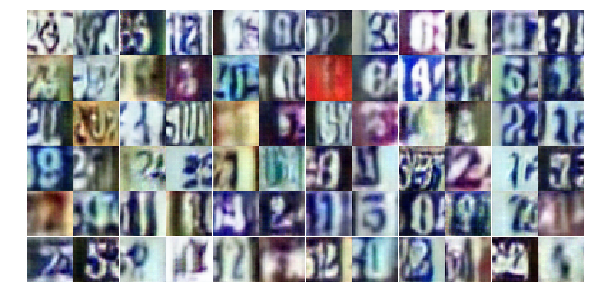

Epoch 12/25... Discriminator Loss: 0.5491... Generator Loss: 1.2681
Epoch 12/25... Discriminator Loss: 0.5469... Generator Loss: 1.3568
Epoch 12/25... Discriminator Loss: 0.3214... Generator Loss: 2.2739
Epoch 12/25... Discriminator Loss: 0.9851... Generator Loss: 0.7627
Epoch 12/25... Discriminator Loss: 0.8010... Generator Loss: 0.9906
Epoch 12/25... Discriminator Loss: 1.0916... Generator Loss: 0.5324
Epoch 12/25... Discriminator Loss: 0.3888... Generator Loss: 1.8989
Epoch 12/25... Discriminator Loss: 0.8583... Generator Loss: 0.7827
Epoch 12/25... Discriminator Loss: 0.5431... Generator Loss: 1.1987
Epoch 12/25... Discriminator Loss: 0.9634... Generator Loss: 0.6664


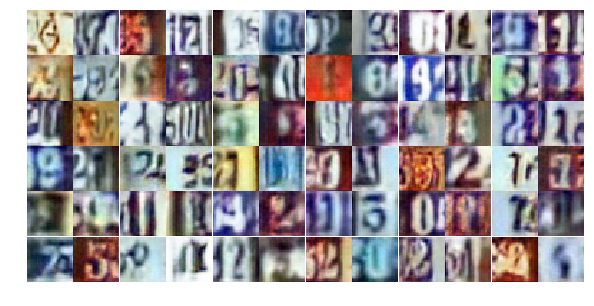

Epoch 12/25... Discriminator Loss: 0.9050... Generator Loss: 0.7920
Epoch 12/25... Discriminator Loss: 0.9673... Generator Loss: 0.6752
Epoch 12/25... Discriminator Loss: 1.0087... Generator Loss: 2.7631
Epoch 12/25... Discriminator Loss: 1.8384... Generator Loss: 0.3185
Epoch 12/25... Discriminator Loss: 0.8999... Generator Loss: 0.7433
Epoch 12/25... Discriminator Loss: 1.0264... Generator Loss: 0.8654
Epoch 12/25... Discriminator Loss: 0.7975... Generator Loss: 0.8647
Epoch 13/25... Discriminator Loss: 0.6811... Generator Loss: 1.0407
Epoch 13/25... Discriminator Loss: 0.5462... Generator Loss: 1.1476
Epoch 13/25... Discriminator Loss: 1.0370... Generator Loss: 0.5641


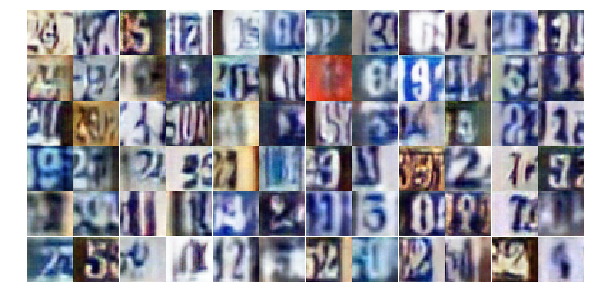

Epoch 13/25... Discriminator Loss: 0.6174... Generator Loss: 1.1466
Epoch 13/25... Discriminator Loss: 0.7869... Generator Loss: 1.6000
Epoch 13/25... Discriminator Loss: 1.2783... Generator Loss: 0.4631
Epoch 13/25... Discriminator Loss: 1.3291... Generator Loss: 0.4467
Epoch 13/25... Discriminator Loss: 0.5652... Generator Loss: 1.2484
Epoch 13/25... Discriminator Loss: 0.4669... Generator Loss: 1.4411
Epoch 13/25... Discriminator Loss: 0.5867... Generator Loss: 1.7167
Epoch 13/25... Discriminator Loss: 0.5563... Generator Loss: 1.1718
Epoch 13/25... Discriminator Loss: 0.3850... Generator Loss: 1.6789
Epoch 13/25... Discriminator Loss: 0.6062... Generator Loss: 1.3810


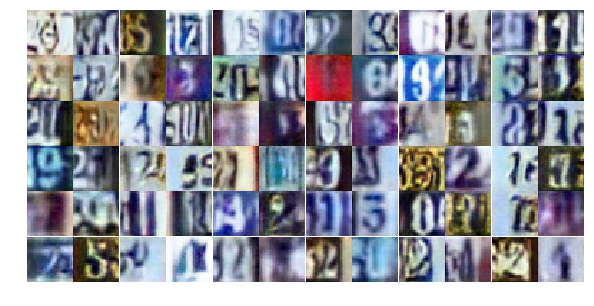

Epoch 13/25... Discriminator Loss: 0.6088... Generator Loss: 1.2443
Epoch 13/25... Discriminator Loss: 0.5217... Generator Loss: 1.5278
Epoch 13/25... Discriminator Loss: 1.2141... Generator Loss: 0.5427
Epoch 13/25... Discriminator Loss: 0.6921... Generator Loss: 0.9973
Epoch 13/25... Discriminator Loss: 0.7538... Generator Loss: 1.2217
Epoch 13/25... Discriminator Loss: 0.9407... Generator Loss: 0.7115
Epoch 13/25... Discriminator Loss: 0.7361... Generator Loss: 0.9411
Epoch 13/25... Discriminator Loss: 1.2912... Generator Loss: 0.4409
Epoch 13/25... Discriminator Loss: 0.6421... Generator Loss: 1.0669
Epoch 13/25... Discriminator Loss: 0.9373... Generator Loss: 0.6915


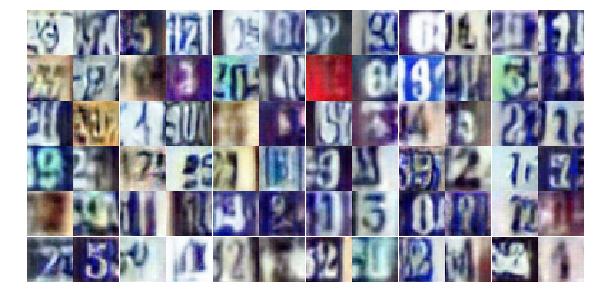

Epoch 13/25... Discriminator Loss: 0.8729... Generator Loss: 0.7444
Epoch 13/25... Discriminator Loss: 0.5686... Generator Loss: 1.4810
Epoch 13/25... Discriminator Loss: 0.4836... Generator Loss: 1.7144
Epoch 13/25... Discriminator Loss: 0.7064... Generator Loss: 0.9495
Epoch 13/25... Discriminator Loss: 0.8183... Generator Loss: 0.8018
Epoch 13/25... Discriminator Loss: 0.6079... Generator Loss: 1.2291
Epoch 13/25... Discriminator Loss: 1.1213... Generator Loss: 0.8243
Epoch 13/25... Discriminator Loss: 0.5791... Generator Loss: 1.4289
Epoch 13/25... Discriminator Loss: 0.5263... Generator Loss: 1.3333
Epoch 13/25... Discriminator Loss: 0.5248... Generator Loss: 1.6332


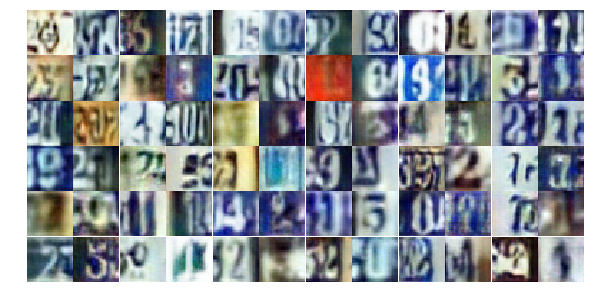

Epoch 13/25... Discriminator Loss: 0.8806... Generator Loss: 0.7280
Epoch 13/25... Discriminator Loss: 0.9102... Generator Loss: 1.7550
Epoch 13/25... Discriminator Loss: 0.9724... Generator Loss: 0.6865
Epoch 13/25... Discriminator Loss: 1.0172... Generator Loss: 0.6415
Epoch 13/25... Discriminator Loss: 0.7017... Generator Loss: 0.9753
Epoch 13/25... Discriminator Loss: 0.4263... Generator Loss: 1.6517
Epoch 13/25... Discriminator Loss: 0.3727... Generator Loss: 1.6328
Epoch 13/25... Discriminator Loss: 0.5723... Generator Loss: 1.1814
Epoch 13/25... Discriminator Loss: 0.6065... Generator Loss: 2.0280
Epoch 13/25... Discriminator Loss: 0.5302... Generator Loss: 1.4848


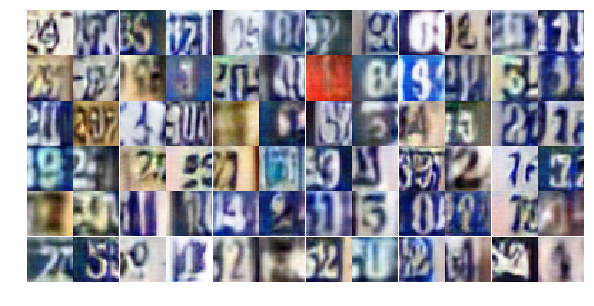

Epoch 13/25... Discriminator Loss: 0.9745... Generator Loss: 0.6982
Epoch 13/25... Discriminator Loss: 1.1610... Generator Loss: 0.6147
Epoch 13/25... Discriminator Loss: 0.7698... Generator Loss: 0.8868
Epoch 13/25... Discriminator Loss: 0.6355... Generator Loss: 1.1027
Epoch 13/25... Discriminator Loss: 0.8314... Generator Loss: 0.9042
Epoch 13/25... Discriminator Loss: 0.6067... Generator Loss: 1.1176
Epoch 13/25... Discriminator Loss: 0.8265... Generator Loss: 0.7931
Epoch 13/25... Discriminator Loss: 0.6922... Generator Loss: 1.1130
Epoch 13/25... Discriminator Loss: 0.5321... Generator Loss: 1.1810
Epoch 13/25... Discriminator Loss: 0.9276... Generator Loss: 0.7901


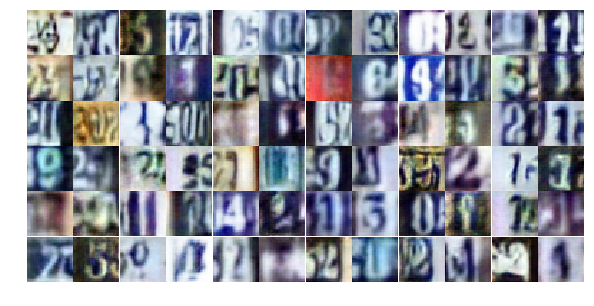

Epoch 13/25... Discriminator Loss: 0.4466... Generator Loss: 2.3832
Epoch 13/25... Discriminator Loss: 1.0878... Generator Loss: 0.6289
Epoch 13/25... Discriminator Loss: 0.7226... Generator Loss: 0.9206
Epoch 13/25... Discriminator Loss: 0.8429... Generator Loss: 0.7732
Epoch 14/25... Discriminator Loss: 0.9975... Generator Loss: 0.6161
Epoch 14/25... Discriminator Loss: 0.7413... Generator Loss: 0.9756
Epoch 14/25... Discriminator Loss: 1.0555... Generator Loss: 0.6230
Epoch 14/25... Discriminator Loss: 0.8901... Generator Loss: 1.9464
Epoch 14/25... Discriminator Loss: 0.6732... Generator Loss: 1.1388
Epoch 14/25... Discriminator Loss: 0.6765... Generator Loss: 1.0752


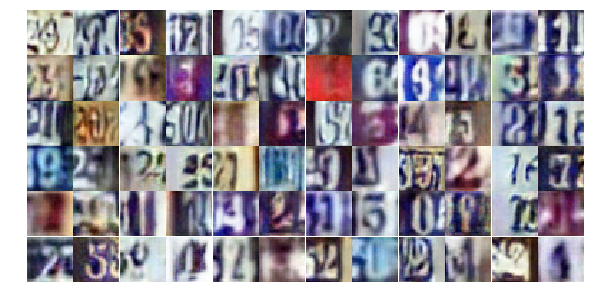

Epoch 14/25... Discriminator Loss: 0.7896... Generator Loss: 1.7536
Epoch 14/25... Discriminator Loss: 0.8857... Generator Loss: 0.7145
Epoch 14/25... Discriminator Loss: 0.5427... Generator Loss: 1.3034
Epoch 14/25... Discriminator Loss: 0.6803... Generator Loss: 1.1382
Epoch 14/25... Discriminator Loss: 1.4618... Generator Loss: 0.3871
Epoch 14/25... Discriminator Loss: 0.4200... Generator Loss: 1.4519
Epoch 14/25... Discriminator Loss: 0.5645... Generator Loss: 1.3474
Epoch 14/25... Discriminator Loss: 1.4556... Generator Loss: 0.3818
Epoch 14/25... Discriminator Loss: 1.5485... Generator Loss: 0.3763
Epoch 14/25... Discriminator Loss: 1.4352... Generator Loss: 0.4248


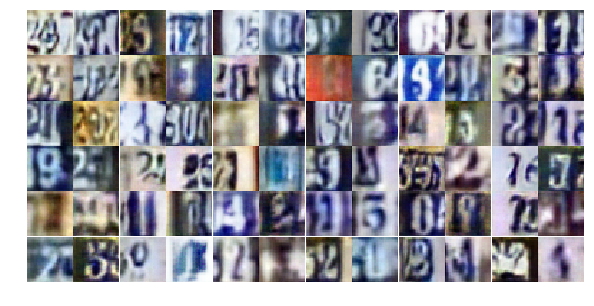

Epoch 14/25... Discriminator Loss: 0.2537... Generator Loss: 3.2327
Epoch 14/25... Discriminator Loss: 1.1346... Generator Loss: 0.5808
Epoch 14/25... Discriminator Loss: 0.9257... Generator Loss: 1.0155
Epoch 14/25... Discriminator Loss: 0.5011... Generator Loss: 1.6124
Epoch 14/25... Discriminator Loss: 0.8779... Generator Loss: 0.8187
Epoch 14/25... Discriminator Loss: 0.6151... Generator Loss: 1.3327
Epoch 14/25... Discriminator Loss: 0.7165... Generator Loss: 1.0407
Epoch 14/25... Discriminator Loss: 0.7967... Generator Loss: 0.8864
Epoch 14/25... Discriminator Loss: 0.6266... Generator Loss: 1.1968
Epoch 14/25... Discriminator Loss: 0.5058... Generator Loss: 2.3811


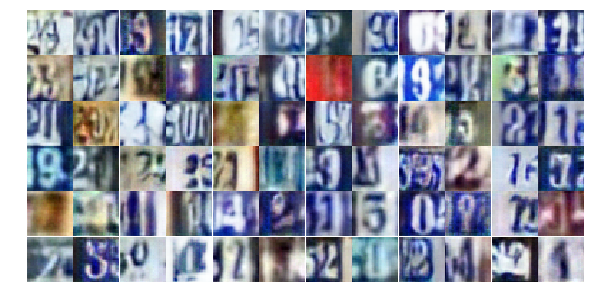

Epoch 14/25... Discriminator Loss: 1.4779... Generator Loss: 0.3530
Epoch 14/25... Discriminator Loss: 0.5714... Generator Loss: 1.1473
Epoch 14/25... Discriminator Loss: 0.5070... Generator Loss: 1.3660
Epoch 14/25... Discriminator Loss: 0.4966... Generator Loss: 1.2684
Epoch 14/25... Discriminator Loss: 0.6739... Generator Loss: 1.0298
Epoch 14/25... Discriminator Loss: 0.6810... Generator Loss: 1.0374
Epoch 14/25... Discriminator Loss: 0.6222... Generator Loss: 1.6249
Epoch 14/25... Discriminator Loss: 0.4747... Generator Loss: 1.4365
Epoch 14/25... Discriminator Loss: 0.4107... Generator Loss: 1.5255
Epoch 14/25... Discriminator Loss: 0.9016... Generator Loss: 0.9499


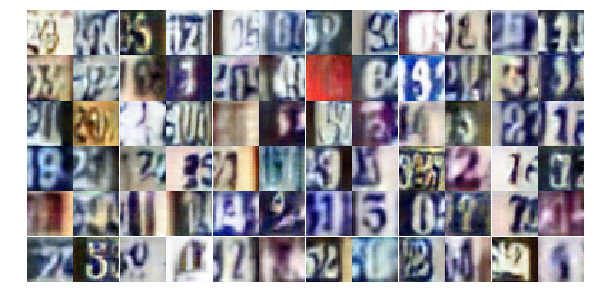

Epoch 14/25... Discriminator Loss: 1.5053... Generator Loss: 0.3890
Epoch 14/25... Discriminator Loss: 0.7376... Generator Loss: 1.4013
Epoch 14/25... Discriminator Loss: 0.7863... Generator Loss: 0.8165
Epoch 14/25... Discriminator Loss: 0.6985... Generator Loss: 0.9243
Epoch 14/25... Discriminator Loss: 0.9799... Generator Loss: 0.6214
Epoch 14/25... Discriminator Loss: 0.6529... Generator Loss: 1.2551
Epoch 14/25... Discriminator Loss: 0.6219... Generator Loss: 1.9554
Epoch 14/25... Discriminator Loss: 0.5742... Generator Loss: 1.1622
Epoch 14/25... Discriminator Loss: 0.6884... Generator Loss: 1.4115
Epoch 14/25... Discriminator Loss: 1.0167... Generator Loss: 0.6731


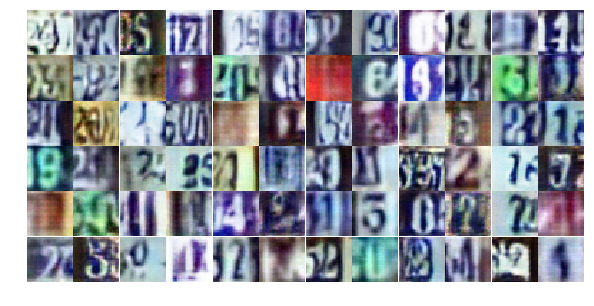

Epoch 14/25... Discriminator Loss: 1.0478... Generator Loss: 0.9006
Epoch 14/25... Discriminator Loss: 1.4777... Generator Loss: 0.3710
Epoch 14/25... Discriminator Loss: 0.8845... Generator Loss: 0.8043
Epoch 14/25... Discriminator Loss: 0.7779... Generator Loss: 0.8521
Epoch 14/25... Discriminator Loss: 0.6513... Generator Loss: 1.1968
Epoch 14/25... Discriminator Loss: 0.6222... Generator Loss: 1.0915
Epoch 14/25... Discriminator Loss: 0.7791... Generator Loss: 1.1649
Epoch 14/25... Discriminator Loss: 0.7026... Generator Loss: 0.9376
Epoch 14/25... Discriminator Loss: 0.7406... Generator Loss: 1.3448
Epoch 14/25... Discriminator Loss: 1.4051... Generator Loss: 0.4076


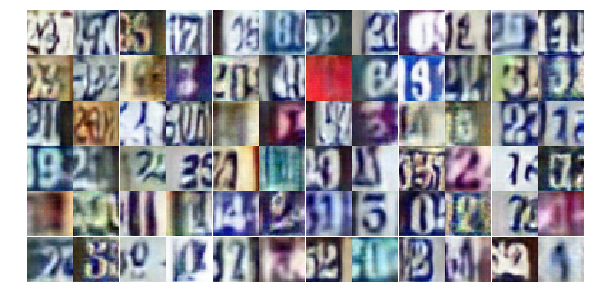

Epoch 14/25... Discriminator Loss: 0.8820... Generator Loss: 1.4198
Epoch 14/25... Discriminator Loss: 0.5879... Generator Loss: 2.0126
Epoch 15/25... Discriminator Loss: 0.6904... Generator Loss: 1.0142
Epoch 15/25... Discriminator Loss: 0.5201... Generator Loss: 1.5162
Epoch 15/25... Discriminator Loss: 0.6012... Generator Loss: 1.1583
Epoch 15/25... Discriminator Loss: 0.9657... Generator Loss: 0.6865
Epoch 15/25... Discriminator Loss: 0.9056... Generator Loss: 0.6888
Epoch 15/25... Discriminator Loss: 0.6547... Generator Loss: 1.3685
Epoch 15/25... Discriminator Loss: 1.4379... Generator Loss: 0.3890
Epoch 15/25... Discriminator Loss: 0.7183... Generator Loss: 1.0442


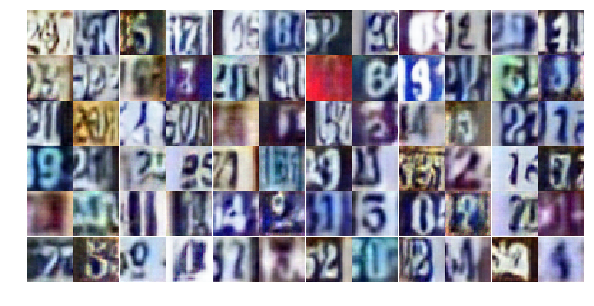

Epoch 15/25... Discriminator Loss: 0.8786... Generator Loss: 0.8440
Epoch 15/25... Discriminator Loss: 0.6902... Generator Loss: 1.2712
Epoch 15/25... Discriminator Loss: 0.7761... Generator Loss: 0.8866
Epoch 15/25... Discriminator Loss: 0.7630... Generator Loss: 0.8630
Epoch 15/25... Discriminator Loss: 0.9900... Generator Loss: 0.7159
Epoch 15/25... Discriminator Loss: 1.3390... Generator Loss: 0.5060
Epoch 15/25... Discriminator Loss: 1.2191... Generator Loss: 0.5422
Epoch 15/25... Discriminator Loss: 0.9242... Generator Loss: 0.7642
Epoch 15/25... Discriminator Loss: 0.4495... Generator Loss: 2.0132
Epoch 15/25... Discriminator Loss: 1.3680... Generator Loss: 0.4606


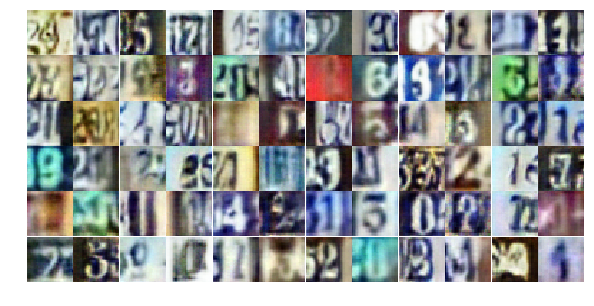

Epoch 15/25... Discriminator Loss: 1.0626... Generator Loss: 0.6055
Epoch 15/25... Discriminator Loss: 0.5883... Generator Loss: 1.3019
Epoch 15/25... Discriminator Loss: 0.6564... Generator Loss: 1.1379
Epoch 15/25... Discriminator Loss: 0.8625... Generator Loss: 0.8229
Epoch 15/25... Discriminator Loss: 0.7653... Generator Loss: 0.9975
Epoch 15/25... Discriminator Loss: 0.7540... Generator Loss: 0.8810
Epoch 15/25... Discriminator Loss: 1.1965... Generator Loss: 0.5558
Epoch 15/25... Discriminator Loss: 0.9962... Generator Loss: 0.6703
Epoch 15/25... Discriminator Loss: 0.6247... Generator Loss: 1.0280
Epoch 15/25... Discriminator Loss: 1.1794... Generator Loss: 0.4822


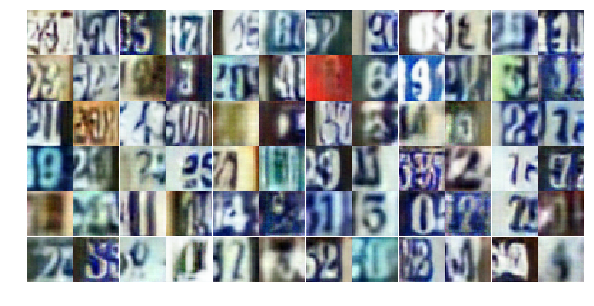

Epoch 15/25... Discriminator Loss: 0.5679... Generator Loss: 1.3728
Epoch 15/25... Discriminator Loss: 1.1125... Generator Loss: 0.5833
Epoch 15/25... Discriminator Loss: 0.4579... Generator Loss: 1.4516
Epoch 15/25... Discriminator Loss: 0.7335... Generator Loss: 0.9789
Epoch 15/25... Discriminator Loss: 0.7360... Generator Loss: 0.8166
Epoch 15/25... Discriminator Loss: 0.7872... Generator Loss: 1.8716
Epoch 15/25... Discriminator Loss: 0.4861... Generator Loss: 1.6481
Epoch 15/25... Discriminator Loss: 0.7377... Generator Loss: 0.9744
Epoch 15/25... Discriminator Loss: 0.6776... Generator Loss: 1.0131
Epoch 15/25... Discriminator Loss: 0.7795... Generator Loss: 0.9947


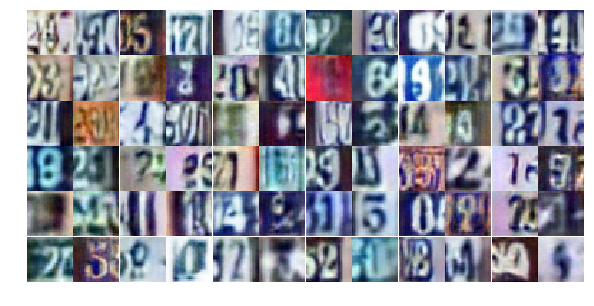

Epoch 15/25... Discriminator Loss: 0.4804... Generator Loss: 1.3643
Epoch 15/25... Discriminator Loss: 1.0980... Generator Loss: 0.5409
Epoch 15/25... Discriminator Loss: 0.8581... Generator Loss: 0.8163
Epoch 15/25... Discriminator Loss: 0.5156... Generator Loss: 1.1987
Epoch 15/25... Discriminator Loss: 0.6350... Generator Loss: 0.9711
Epoch 15/25... Discriminator Loss: 1.0061... Generator Loss: 0.7444
Epoch 15/25... Discriminator Loss: 0.6270... Generator Loss: 1.2099
Epoch 15/25... Discriminator Loss: 0.7505... Generator Loss: 1.0463
Epoch 15/25... Discriminator Loss: 0.9944... Generator Loss: 0.7033
Epoch 15/25... Discriminator Loss: 1.0283... Generator Loss: 0.6369


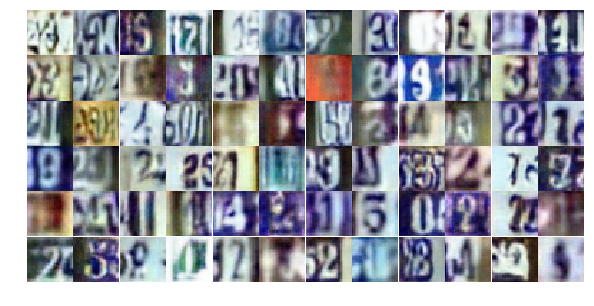

Epoch 15/25... Discriminator Loss: 0.9614... Generator Loss: 0.6759
Epoch 15/25... Discriminator Loss: 0.6765... Generator Loss: 1.9378
Epoch 15/25... Discriminator Loss: 0.7475... Generator Loss: 1.2278
Epoch 15/25... Discriminator Loss: 1.2022... Generator Loss: 0.5777
Epoch 15/25... Discriminator Loss: 0.6809... Generator Loss: 0.9893
Epoch 15/25... Discriminator Loss: 0.5997... Generator Loss: 2.0246
Epoch 15/25... Discriminator Loss: 1.1827... Generator Loss: 0.5659
Epoch 15/25... Discriminator Loss: 1.3825... Generator Loss: 0.4341
Epoch 15/25... Discriminator Loss: 1.6251... Generator Loss: 0.4831
Epoch 16/25... Discriminator Loss: 0.9760... Generator Loss: 0.6599


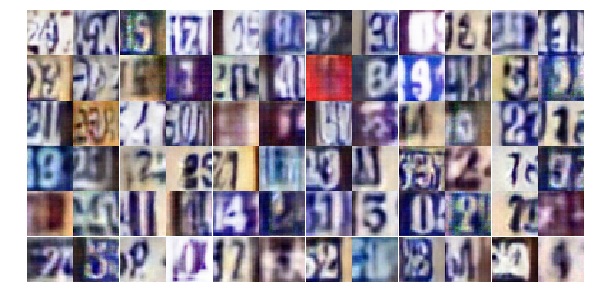

Epoch 16/25... Discriminator Loss: 0.6040... Generator Loss: 1.1765
Epoch 16/25... Discriminator Loss: 0.7826... Generator Loss: 1.1988
Epoch 16/25... Discriminator Loss: 1.0640... Generator Loss: 0.5841
Epoch 16/25... Discriminator Loss: 0.6495... Generator Loss: 1.1269
Epoch 16/25... Discriminator Loss: 0.6991... Generator Loss: 1.1600
Epoch 16/25... Discriminator Loss: 0.6949... Generator Loss: 1.5410
Epoch 16/25... Discriminator Loss: 1.6610... Generator Loss: 0.2894
Epoch 16/25... Discriminator Loss: 0.9129... Generator Loss: 0.7045
Epoch 16/25... Discriminator Loss: 0.9688... Generator Loss: 0.6896
Epoch 16/25... Discriminator Loss: 0.6198... Generator Loss: 1.1637


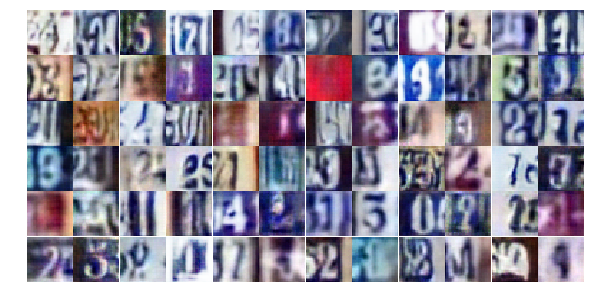

Epoch 16/25... Discriminator Loss: 1.0934... Generator Loss: 0.5646
Epoch 16/25... Discriminator Loss: 0.7143... Generator Loss: 1.1057
Epoch 16/25... Discriminator Loss: 0.8152... Generator Loss: 0.9987
Epoch 16/25... Discriminator Loss: 1.2033... Generator Loss: 0.5129
Epoch 16/25... Discriminator Loss: 0.4967... Generator Loss: 1.4379
Epoch 16/25... Discriminator Loss: 0.7502... Generator Loss: 0.8944
Epoch 16/25... Discriminator Loss: 1.5792... Generator Loss: 0.3441
Epoch 16/25... Discriminator Loss: 0.5976... Generator Loss: 1.6432
Epoch 16/25... Discriminator Loss: 0.5653... Generator Loss: 1.3451
Epoch 16/25... Discriminator Loss: 0.8281... Generator Loss: 0.8564


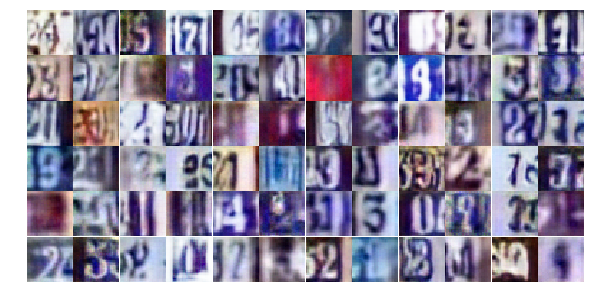

Epoch 16/25... Discriminator Loss: 0.6356... Generator Loss: 1.1529
Epoch 16/25... Discriminator Loss: 0.9538... Generator Loss: 0.6739
Epoch 16/25... Discriminator Loss: 0.8051... Generator Loss: 0.8784
Epoch 16/25... Discriminator Loss: 1.1160... Generator Loss: 0.5785
Epoch 16/25... Discriminator Loss: 0.7381... Generator Loss: 1.0706
Epoch 16/25... Discriminator Loss: 0.7225... Generator Loss: 1.1725
Epoch 16/25... Discriminator Loss: 0.8908... Generator Loss: 0.7515
Epoch 16/25... Discriminator Loss: 0.5714... Generator Loss: 1.2585
Epoch 16/25... Discriminator Loss: 0.7199... Generator Loss: 1.0793
Epoch 16/25... Discriminator Loss: 0.7235... Generator Loss: 0.8735


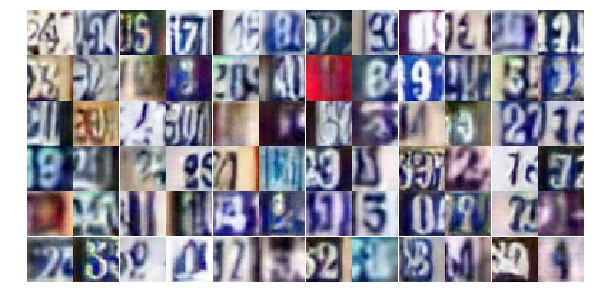

Epoch 16/25... Discriminator Loss: 0.5530... Generator Loss: 1.2433
Epoch 16/25... Discriminator Loss: 0.5772... Generator Loss: 1.2448
Epoch 16/25... Discriminator Loss: 0.7018... Generator Loss: 0.9874
Epoch 16/25... Discriminator Loss: 0.5029... Generator Loss: 1.6564
Epoch 16/25... Discriminator Loss: 0.8818... Generator Loss: 0.8087
Epoch 16/25... Discriminator Loss: 0.8509... Generator Loss: 2.1516
Epoch 16/25... Discriminator Loss: 0.7873... Generator Loss: 0.8913
Epoch 16/25... Discriminator Loss: 1.0583... Generator Loss: 0.6276
Epoch 16/25... Discriminator Loss: 1.0328... Generator Loss: 0.6331
Epoch 16/25... Discriminator Loss: 0.4947... Generator Loss: 1.4324


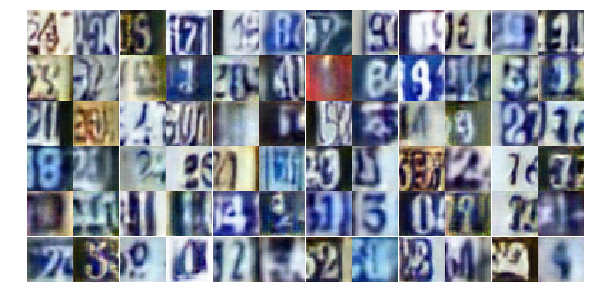

Epoch 16/25... Discriminator Loss: 0.5581... Generator Loss: 1.3943
Epoch 16/25... Discriminator Loss: 0.5171... Generator Loss: 1.3289
Epoch 16/25... Discriminator Loss: 1.2221... Generator Loss: 0.5457
Epoch 16/25... Discriminator Loss: 1.5185... Generator Loss: 0.7517
Epoch 16/25... Discriminator Loss: 0.8388... Generator Loss: 0.9688
Epoch 16/25... Discriminator Loss: 1.1236... Generator Loss: 0.5214
Epoch 16/25... Discriminator Loss: 0.9571... Generator Loss: 0.8112
Epoch 16/25... Discriminator Loss: 0.8398... Generator Loss: 0.9349
Epoch 16/25... Discriminator Loss: 0.5041... Generator Loss: 1.2263
Epoch 16/25... Discriminator Loss: 1.0316... Generator Loss: 0.6901


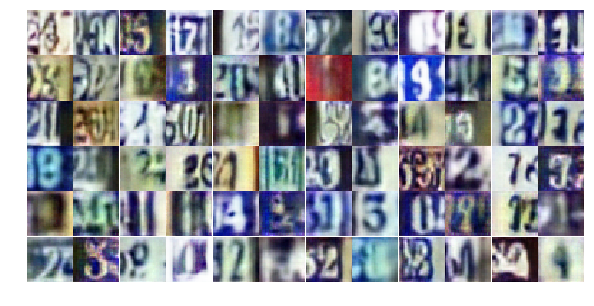

Epoch 16/25... Discriminator Loss: 1.3957... Generator Loss: 0.4400
Epoch 16/25... Discriminator Loss: 0.7493... Generator Loss: 0.9822
Epoch 16/25... Discriminator Loss: 1.8124... Generator Loss: 0.2496
Epoch 16/25... Discriminator Loss: 0.4829... Generator Loss: 2.2109
Epoch 16/25... Discriminator Loss: 0.5633... Generator Loss: 1.3143
Epoch 16/25... Discriminator Loss: 0.7926... Generator Loss: 0.8775
Epoch 17/25... Discriminator Loss: 0.7713... Generator Loss: 1.3864
Epoch 17/25... Discriminator Loss: 0.6361... Generator Loss: 1.0670
Epoch 17/25... Discriminator Loss: 0.8430... Generator Loss: 1.0174
Epoch 17/25... Discriminator Loss: 1.0211... Generator Loss: 0.6004


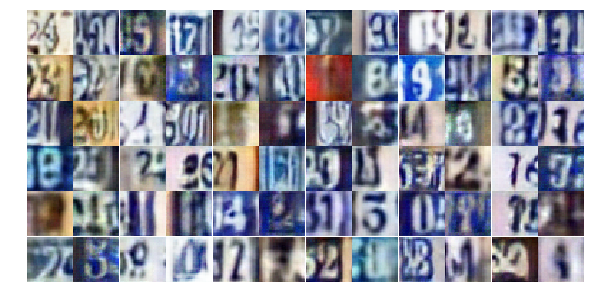

Epoch 17/25... Discriminator Loss: 0.5883... Generator Loss: 1.3992
Epoch 17/25... Discriminator Loss: 0.5846... Generator Loss: 1.6143
Epoch 17/25... Discriminator Loss: 0.9758... Generator Loss: 0.7708
Epoch 17/25... Discriminator Loss: 0.7641... Generator Loss: 1.0683
Epoch 17/25... Discriminator Loss: 1.1064... Generator Loss: 0.5968
Epoch 17/25... Discriminator Loss: 1.1973... Generator Loss: 0.5011
Epoch 17/25... Discriminator Loss: 0.8192... Generator Loss: 1.5381
Epoch 17/25... Discriminator Loss: 0.6939... Generator Loss: 0.9188
Epoch 17/25... Discriminator Loss: 0.4366... Generator Loss: 1.6282
Epoch 17/25... Discriminator Loss: 0.5908... Generator Loss: 1.6891


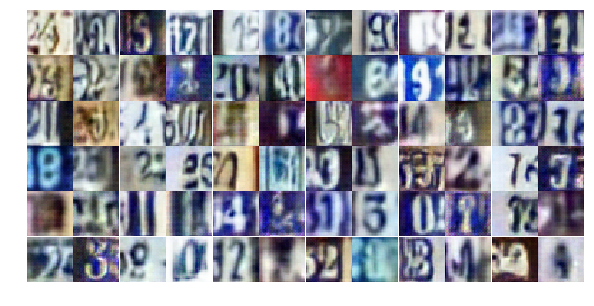

Epoch 17/25... Discriminator Loss: 0.8203... Generator Loss: 1.0114
Epoch 17/25... Discriminator Loss: 0.6105... Generator Loss: 1.2701
Epoch 17/25... Discriminator Loss: 0.6137... Generator Loss: 1.1963
Epoch 17/25... Discriminator Loss: 1.6867... Generator Loss: 0.3252
Epoch 17/25... Discriminator Loss: 0.4291... Generator Loss: 1.7876
Epoch 17/25... Discriminator Loss: 0.8520... Generator Loss: 0.7938
Epoch 17/25... Discriminator Loss: 0.7112... Generator Loss: 2.0660
Epoch 17/25... Discriminator Loss: 0.5386... Generator Loss: 1.3401
Epoch 17/25... Discriminator Loss: 0.7507... Generator Loss: 0.8546
Epoch 17/25... Discriminator Loss: 0.6525... Generator Loss: 1.0043


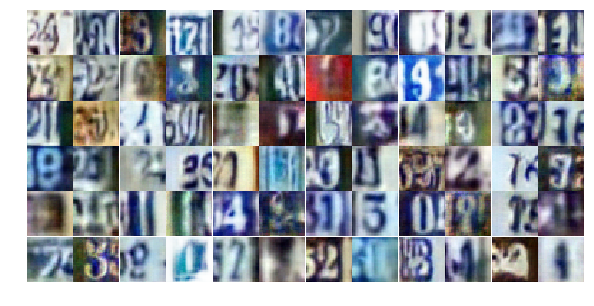

Epoch 17/25... Discriminator Loss: 1.6927... Generator Loss: 0.3145
Epoch 17/25... Discriminator Loss: 0.5317... Generator Loss: 1.5776
Epoch 17/25... Discriminator Loss: 0.5747... Generator Loss: 1.2334
Epoch 17/25... Discriminator Loss: 1.2215... Generator Loss: 0.5818
Epoch 17/25... Discriminator Loss: 1.6271... Generator Loss: 0.3171
Epoch 17/25... Discriminator Loss: 0.6508... Generator Loss: 1.0279
Epoch 17/25... Discriminator Loss: 0.7634... Generator Loss: 1.0010
Epoch 17/25... Discriminator Loss: 0.7397... Generator Loss: 0.8903
Epoch 17/25... Discriminator Loss: 1.0727... Generator Loss: 0.6378
Epoch 17/25... Discriminator Loss: 0.5551... Generator Loss: 1.3193


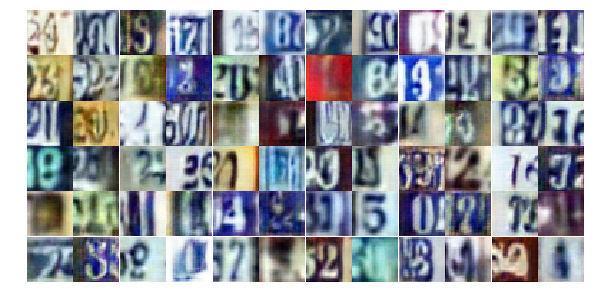

Epoch 17/25... Discriminator Loss: 0.6623... Generator Loss: 1.2554
Epoch 17/25... Discriminator Loss: 1.0151... Generator Loss: 1.1018
Epoch 17/25... Discriminator Loss: 0.7833... Generator Loss: 0.9331
Epoch 17/25... Discriminator Loss: 0.7382... Generator Loss: 1.1254
Epoch 17/25... Discriminator Loss: 0.6568... Generator Loss: 0.9628
Epoch 17/25... Discriminator Loss: 0.6029... Generator Loss: 1.1836
Epoch 17/25... Discriminator Loss: 0.7190... Generator Loss: 1.4958
Epoch 17/25... Discriminator Loss: 0.4446... Generator Loss: 1.6350
Epoch 17/25... Discriminator Loss: 0.6808... Generator Loss: 1.0124
Epoch 17/25... Discriminator Loss: 1.0208... Generator Loss: 0.5835


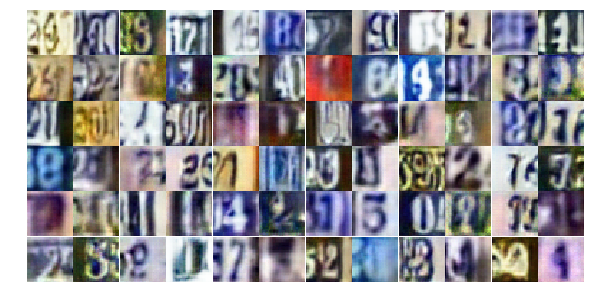

Epoch 17/25... Discriminator Loss: 1.5177... Generator Loss: 2.5686
Epoch 17/25... Discriminator Loss: 0.4092... Generator Loss: 1.9897
Epoch 17/25... Discriminator Loss: 0.5988... Generator Loss: 1.5378
Epoch 17/25... Discriminator Loss: 0.5004... Generator Loss: 1.5239
Epoch 17/25... Discriminator Loss: 1.0760... Generator Loss: 0.5639
Epoch 17/25... Discriminator Loss: 0.7867... Generator Loss: 1.0162
Epoch 17/25... Discriminator Loss: 0.8040... Generator Loss: 0.8469
Epoch 17/25... Discriminator Loss: 0.6380... Generator Loss: 1.1692
Epoch 17/25... Discriminator Loss: 0.6611... Generator Loss: 1.2520
Epoch 17/25... Discriminator Loss: 1.7278... Generator Loss: 0.2969


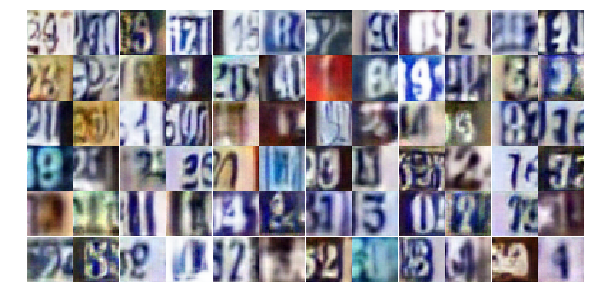

Epoch 17/25... Discriminator Loss: 0.8001... Generator Loss: 1.3166
Epoch 17/25... Discriminator Loss: 0.7998... Generator Loss: 1.6668
Epoch 17/25... Discriminator Loss: 0.4177... Generator Loss: 1.6190
Epoch 17/25... Discriminator Loss: 0.5371... Generator Loss: 1.6207
Epoch 18/25... Discriminator Loss: 1.0206... Generator Loss: 0.6344
Epoch 18/25... Discriminator Loss: 1.4182... Generator Loss: 0.4272
Epoch 18/25... Discriminator Loss: 0.7588... Generator Loss: 0.9198
Epoch 18/25... Discriminator Loss: 0.8714... Generator Loss: 0.7416
Epoch 18/25... Discriminator Loss: 1.4240... Generator Loss: 0.4108
Epoch 18/25... Discriminator Loss: 0.6695... Generator Loss: 1.6422


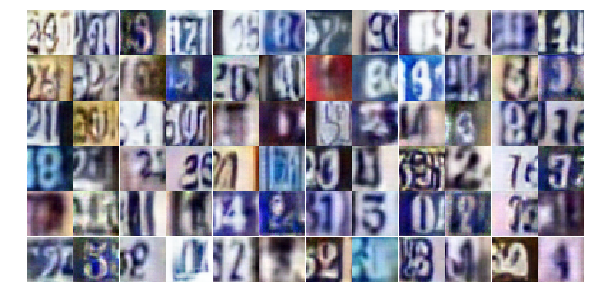

Epoch 18/25... Discriminator Loss: 0.7099... Generator Loss: 1.6759
Epoch 18/25... Discriminator Loss: 1.0402... Generator Loss: 0.6275
Epoch 18/25... Discriminator Loss: 0.9950... Generator Loss: 0.6521
Epoch 18/25... Discriminator Loss: 0.5044... Generator Loss: 1.3532
Epoch 18/25... Discriminator Loss: 0.6042... Generator Loss: 1.0759
Epoch 18/25... Discriminator Loss: 0.8965... Generator Loss: 0.7946
Epoch 18/25... Discriminator Loss: 0.5331... Generator Loss: 1.2948
Epoch 18/25... Discriminator Loss: 1.0914... Generator Loss: 0.6051
Epoch 18/25... Discriminator Loss: 0.6706... Generator Loss: 1.0826
Epoch 18/25... Discriminator Loss: 0.2747... Generator Loss: 2.3795


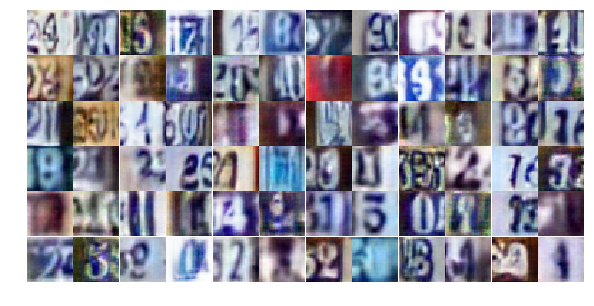

Epoch 18/25... Discriminator Loss: 0.5278... Generator Loss: 1.4064
Epoch 18/25... Discriminator Loss: 1.0932... Generator Loss: 2.0514
Epoch 18/25... Discriminator Loss: 0.8434... Generator Loss: 1.0768
Epoch 18/25... Discriminator Loss: 0.5045... Generator Loss: 1.3019
Epoch 18/25... Discriminator Loss: 0.8728... Generator Loss: 0.7571
Epoch 18/25... Discriminator Loss: 1.0371... Generator Loss: 0.6687
Epoch 18/25... Discriminator Loss: 0.8869... Generator Loss: 0.9698
Epoch 18/25... Discriminator Loss: 1.0411... Generator Loss: 0.6422
Epoch 18/25... Discriminator Loss: 0.8261... Generator Loss: 0.8207
Epoch 18/25... Discriminator Loss: 0.5151... Generator Loss: 1.3705


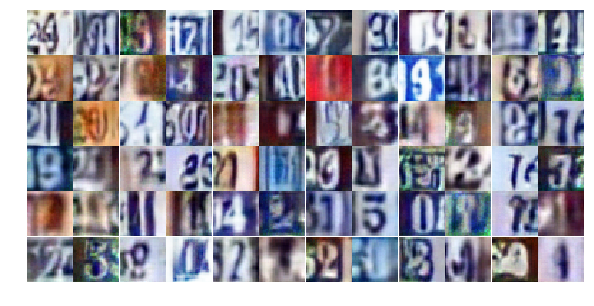

Epoch 18/25... Discriminator Loss: 0.4382... Generator Loss: 1.8236
Epoch 18/25... Discriminator Loss: 0.8669... Generator Loss: 1.9389
Epoch 18/25... Discriminator Loss: 1.2341... Generator Loss: 0.5337
Epoch 18/25... Discriminator Loss: 1.0025... Generator Loss: 0.7101
Epoch 18/25... Discriminator Loss: 0.7004... Generator Loss: 1.0044
Epoch 18/25... Discriminator Loss: 0.8385... Generator Loss: 0.8298
Epoch 18/25... Discriminator Loss: 0.5542... Generator Loss: 1.5008
Epoch 18/25... Discriminator Loss: 0.5306... Generator Loss: 1.5640
Epoch 18/25... Discriminator Loss: 0.5963... Generator Loss: 1.0781
Epoch 18/25... Discriminator Loss: 0.7787... Generator Loss: 1.0872


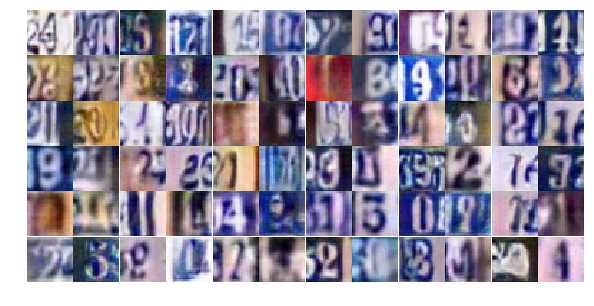

Epoch 18/25... Discriminator Loss: 0.8335... Generator Loss: 0.8478
Epoch 18/25... Discriminator Loss: 0.6608... Generator Loss: 1.3455
Epoch 18/25... Discriminator Loss: 0.7814... Generator Loss: 0.8715
Epoch 18/25... Discriminator Loss: 0.6529... Generator Loss: 1.0978
Epoch 18/25... Discriminator Loss: 1.1040... Generator Loss: 0.5895
Epoch 18/25... Discriminator Loss: 0.5606... Generator Loss: 1.1713
Epoch 18/25... Discriminator Loss: 1.1030... Generator Loss: 0.5803
Epoch 18/25... Discriminator Loss: 0.9881... Generator Loss: 2.1663
Epoch 18/25... Discriminator Loss: 0.9437... Generator Loss: 0.7159
Epoch 18/25... Discriminator Loss: 0.4243... Generator Loss: 1.6648


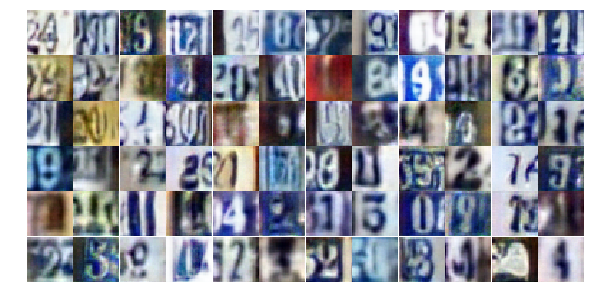

Epoch 18/25... Discriminator Loss: 0.6459... Generator Loss: 1.1494
Epoch 18/25... Discriminator Loss: 0.6590... Generator Loss: 1.2477
Epoch 18/25... Discriminator Loss: 0.6247... Generator Loss: 1.9790
Epoch 18/25... Discriminator Loss: 0.8915... Generator Loss: 0.8249
Epoch 18/25... Discriminator Loss: 0.8221... Generator Loss: 0.8182
Epoch 18/25... Discriminator Loss: 0.6835... Generator Loss: 1.0577
Epoch 18/25... Discriminator Loss: 0.5097... Generator Loss: 1.3468
Epoch 18/25... Discriminator Loss: 0.5587... Generator Loss: 1.2970
Epoch 18/25... Discriminator Loss: 1.3025... Generator Loss: 0.4638
Epoch 18/25... Discriminator Loss: 0.8840... Generator Loss: 0.9284


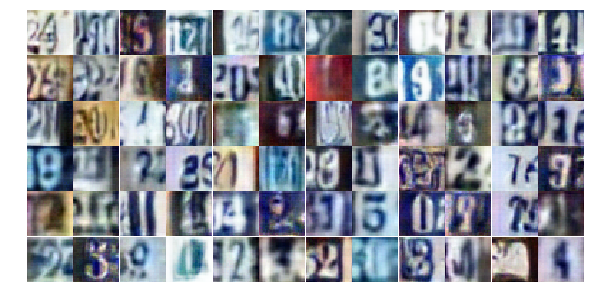

Epoch 18/25... Discriminator Loss: 1.1107... Generator Loss: 3.2830
Epoch 19/25... Discriminator Loss: 1.2268... Generator Loss: 0.6048
Epoch 19/25... Discriminator Loss: 1.0695... Generator Loss: 0.6500
Epoch 19/25... Discriminator Loss: 0.8850... Generator Loss: 0.7468
Epoch 19/25... Discriminator Loss: 0.6019... Generator Loss: 1.1038
Epoch 19/25... Discriminator Loss: 1.0998... Generator Loss: 0.5992
Epoch 19/25... Discriminator Loss: 0.5453... Generator Loss: 1.3228
Epoch 19/25... Discriminator Loss: 0.8467... Generator Loss: 0.7967
Epoch 19/25... Discriminator Loss: 0.7009... Generator Loss: 1.8181
Epoch 19/25... Discriminator Loss: 0.7813... Generator Loss: 1.2832


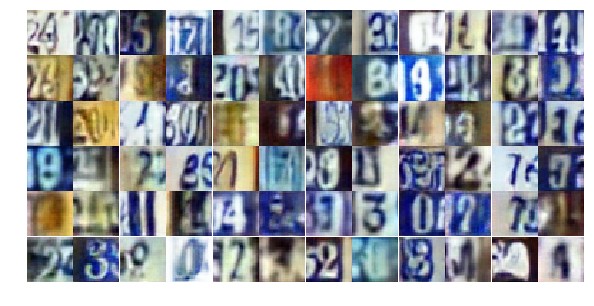

Epoch 19/25... Discriminator Loss: 0.6720... Generator Loss: 0.9348
Epoch 19/25... Discriminator Loss: 0.8728... Generator Loss: 0.8228
Epoch 19/25... Discriminator Loss: 0.8580... Generator Loss: 1.0885
Epoch 19/25... Discriminator Loss: 0.9187... Generator Loss: 0.6829
Epoch 19/25... Discriminator Loss: 0.7749... Generator Loss: 0.8969
Epoch 19/25... Discriminator Loss: 0.6837... Generator Loss: 1.1290
Epoch 19/25... Discriminator Loss: 2.0607... Generator Loss: 3.8370
Epoch 19/25... Discriminator Loss: 1.8289... Generator Loss: 2.8693
Epoch 19/25... Discriminator Loss: 1.0995... Generator Loss: 0.8221
Epoch 19/25... Discriminator Loss: 0.8295... Generator Loss: 0.9532


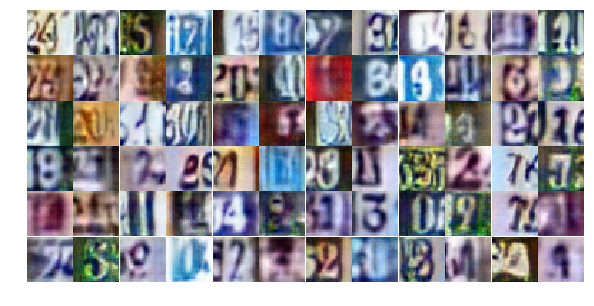

Epoch 19/25... Discriminator Loss: 0.5220... Generator Loss: 1.5863
Epoch 19/25... Discriminator Loss: 1.1534... Generator Loss: 0.6907
Epoch 19/25... Discriminator Loss: 1.2977... Generator Loss: 0.4961
Epoch 19/25... Discriminator Loss: 1.0532... Generator Loss: 0.6834
Epoch 19/25... Discriminator Loss: 1.4588... Generator Loss: 0.3998
Epoch 19/25... Discriminator Loss: 0.8001... Generator Loss: 1.4560
Epoch 19/25... Discriminator Loss: 0.7056... Generator Loss: 1.1130
Epoch 19/25... Discriminator Loss: 0.6528... Generator Loss: 1.1773
Epoch 19/25... Discriminator Loss: 0.6772... Generator Loss: 1.0457
Epoch 19/25... Discriminator Loss: 0.9933... Generator Loss: 0.6871


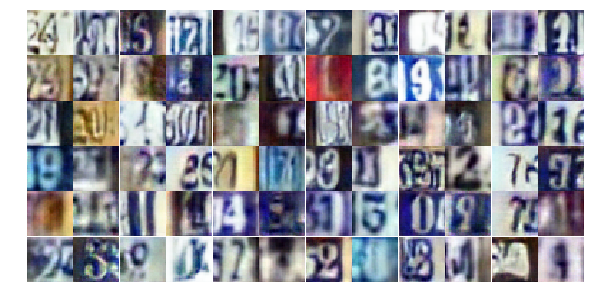

Epoch 19/25... Discriminator Loss: 0.8416... Generator Loss: 0.8401
Epoch 19/25... Discriminator Loss: 0.7016... Generator Loss: 0.9903
Epoch 19/25... Discriminator Loss: 0.9934... Generator Loss: 0.6749
Epoch 19/25... Discriminator Loss: 0.6008... Generator Loss: 1.1238
Epoch 19/25... Discriminator Loss: 0.9203... Generator Loss: 0.7486
Epoch 19/25... Discriminator Loss: 0.9236... Generator Loss: 0.7428
Epoch 19/25... Discriminator Loss: 0.6335... Generator Loss: 1.7302
Epoch 19/25... Discriminator Loss: 0.7561... Generator Loss: 1.0025
Epoch 19/25... Discriminator Loss: 1.0231... Generator Loss: 0.6575
Epoch 19/25... Discriminator Loss: 0.9986... Generator Loss: 0.7069


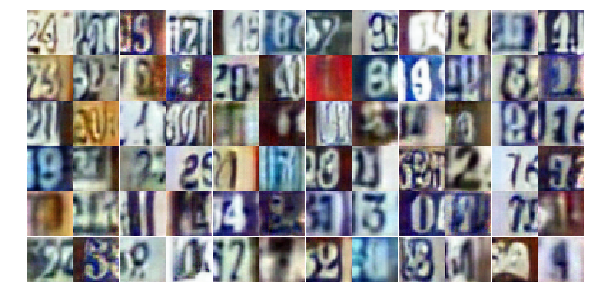

Epoch 19/25... Discriminator Loss: 0.8674... Generator Loss: 0.7154
Epoch 19/25... Discriminator Loss: 0.6908... Generator Loss: 1.0687
Epoch 19/25... Discriminator Loss: 1.3175... Generator Loss: 0.4699
Epoch 19/25... Discriminator Loss: 0.7848... Generator Loss: 0.9735
Epoch 19/25... Discriminator Loss: 0.6527... Generator Loss: 1.2888
Epoch 19/25... Discriminator Loss: 0.6334... Generator Loss: 1.3201
Epoch 19/25... Discriminator Loss: 0.8589... Generator Loss: 0.8468
Epoch 19/25... Discriminator Loss: 0.6022... Generator Loss: 1.3041
Epoch 19/25... Discriminator Loss: 0.5182... Generator Loss: 1.4757
Epoch 19/25... Discriminator Loss: 1.1402... Generator Loss: 0.5849


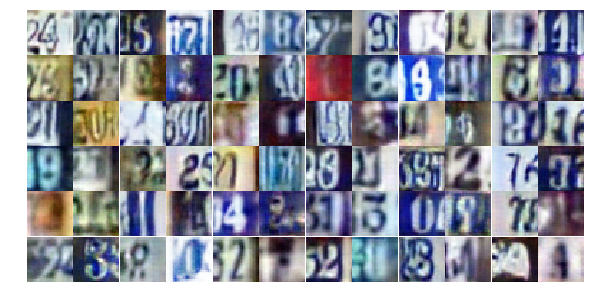

Epoch 19/25... Discriminator Loss: 0.9923... Generator Loss: 0.6921
Epoch 19/25... Discriminator Loss: 0.6925... Generator Loss: 0.9696
Epoch 19/25... Discriminator Loss: 0.6043... Generator Loss: 1.3161
Epoch 19/25... Discriminator Loss: 1.2575... Generator Loss: 0.5224
Epoch 19/25... Discriminator Loss: 0.6572... Generator Loss: 1.7173
Epoch 19/25... Discriminator Loss: 0.6813... Generator Loss: 1.3057
Epoch 19/25... Discriminator Loss: 1.5177... Generator Loss: 0.4283
Epoch 19/25... Discriminator Loss: 0.5136... Generator Loss: 1.6247
Epoch 20/25... Discriminator Loss: 0.6684... Generator Loss: 1.2321
Epoch 20/25... Discriminator Loss: 0.8557... Generator Loss: 0.8390


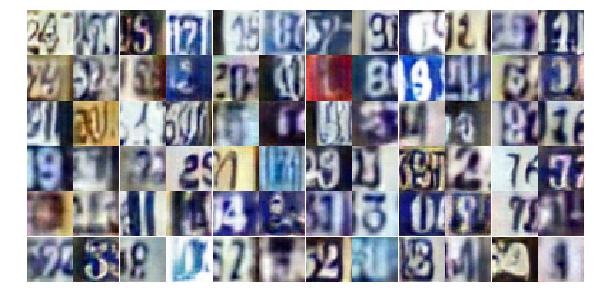

Epoch 20/25... Discriminator Loss: 0.5687... Generator Loss: 1.1336
Epoch 20/25... Discriminator Loss: 1.0397... Generator Loss: 0.6670
Epoch 20/25... Discriminator Loss: 1.8533... Generator Loss: 0.2688
Epoch 20/25... Discriminator Loss: 1.4628... Generator Loss: 0.3620
Epoch 20/25... Discriminator Loss: 0.4889... Generator Loss: 1.8346
Epoch 20/25... Discriminator Loss: 0.5611... Generator Loss: 1.4898
Epoch 20/25... Discriminator Loss: 0.7892... Generator Loss: 0.8658
Epoch 20/25... Discriminator Loss: 0.8154... Generator Loss: 0.9025
Epoch 20/25... Discriminator Loss: 0.7993... Generator Loss: 0.9396
Epoch 20/25... Discriminator Loss: 0.7701... Generator Loss: 0.8484


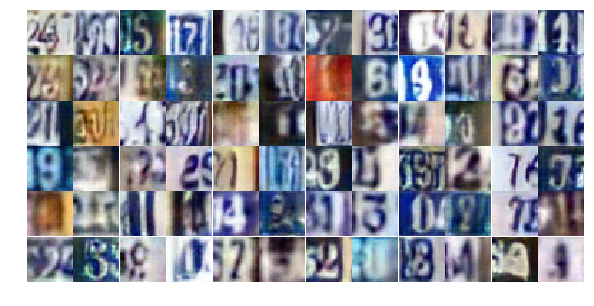

Epoch 20/25... Discriminator Loss: 1.2540... Generator Loss: 0.4713
Epoch 20/25... Discriminator Loss: 1.1092... Generator Loss: 0.6125
Epoch 20/25... Discriminator Loss: 0.7236... Generator Loss: 1.1144
Epoch 20/25... Discriminator Loss: 1.1016... Generator Loss: 0.6417
Epoch 20/25... Discriminator Loss: 1.2229... Generator Loss: 0.5499
Epoch 20/25... Discriminator Loss: 1.0157... Generator Loss: 0.7077
Epoch 20/25... Discriminator Loss: 1.2916... Generator Loss: 0.4900
Epoch 20/25... Discriminator Loss: 0.7337... Generator Loss: 1.1230
Epoch 20/25... Discriminator Loss: 1.1165... Generator Loss: 0.5752
Epoch 20/25... Discriminator Loss: 1.3607... Generator Loss: 0.4572


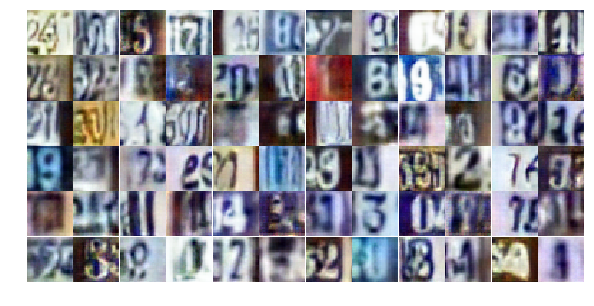

Epoch 20/25... Discriminator Loss: 0.6018... Generator Loss: 1.1548
Epoch 20/25... Discriminator Loss: 0.9290... Generator Loss: 0.7584
Epoch 20/25... Discriminator Loss: 0.3901... Generator Loss: 1.5265
Epoch 20/25... Discriminator Loss: 1.4433... Generator Loss: 0.3980
Epoch 20/25... Discriminator Loss: 0.7898... Generator Loss: 0.8739
Epoch 20/25... Discriminator Loss: 0.5997... Generator Loss: 1.1045
Epoch 20/25... Discriminator Loss: 0.7092... Generator Loss: 0.9171
Epoch 20/25... Discriminator Loss: 1.3002... Generator Loss: 0.4654
Epoch 20/25... Discriminator Loss: 0.7551... Generator Loss: 0.9739
Epoch 20/25... Discriminator Loss: 0.6421... Generator Loss: 1.0388


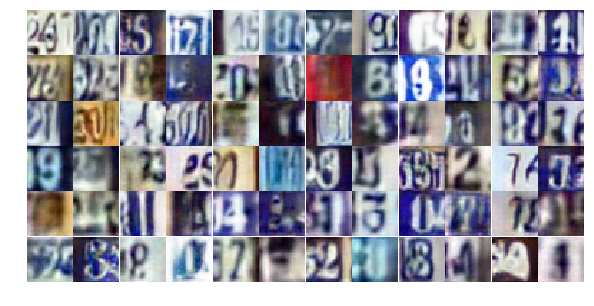

Epoch 20/25... Discriminator Loss: 0.7020... Generator Loss: 1.4817
Epoch 20/25... Discriminator Loss: 0.4683... Generator Loss: 1.3217
Epoch 20/25... Discriminator Loss: 1.0863... Generator Loss: 0.7072
Epoch 20/25... Discriminator Loss: 0.7714... Generator Loss: 1.0113
Epoch 20/25... Discriminator Loss: 0.6732... Generator Loss: 1.1915
Epoch 20/25... Discriminator Loss: 0.8171... Generator Loss: 0.8426
Epoch 20/25... Discriminator Loss: 0.5673... Generator Loss: 1.3599
Epoch 20/25... Discriminator Loss: 0.7035... Generator Loss: 1.3344
Epoch 20/25... Discriminator Loss: 1.0881... Generator Loss: 2.2677
Epoch 20/25... Discriminator Loss: 1.4214... Generator Loss: 0.4057


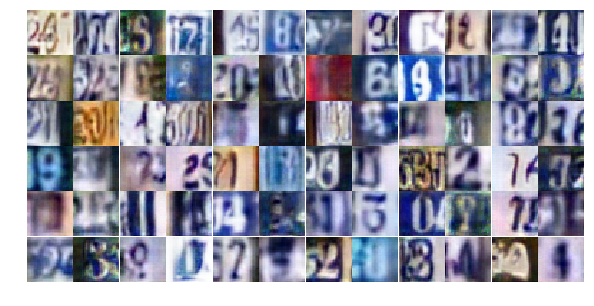

Epoch 20/25... Discriminator Loss: 0.8161... Generator Loss: 0.8085
Epoch 20/25... Discriminator Loss: 1.2963... Generator Loss: 0.4573
Epoch 20/25... Discriminator Loss: 1.0872... Generator Loss: 0.8707
Epoch 20/25... Discriminator Loss: 0.9069... Generator Loss: 0.7502
Epoch 20/25... Discriminator Loss: 0.6694... Generator Loss: 1.4937
Epoch 20/25... Discriminator Loss: 1.2032... Generator Loss: 0.5500
Epoch 20/25... Discriminator Loss: 0.9567... Generator Loss: 0.7821
Epoch 20/25... Discriminator Loss: 0.4834... Generator Loss: 1.5416
Epoch 20/25... Discriminator Loss: 0.6486... Generator Loss: 1.4239
Epoch 20/25... Discriminator Loss: 0.6749... Generator Loss: 1.0721


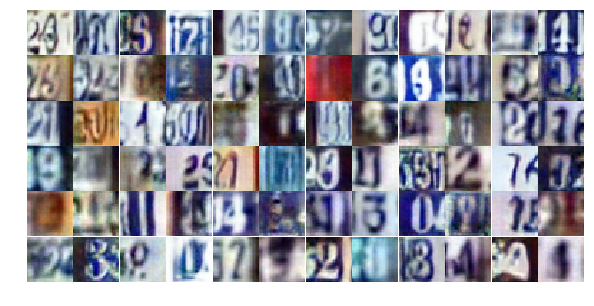

Epoch 20/25... Discriminator Loss: 0.5896... Generator Loss: 1.3686
Epoch 20/25... Discriminator Loss: 0.8946... Generator Loss: 0.7658
Epoch 20/25... Discriminator Loss: 0.4740... Generator Loss: 1.7806
Epoch 20/25... Discriminator Loss: 0.9002... Generator Loss: 0.9229
Epoch 20/25... Discriminator Loss: 0.5676... Generator Loss: 1.6609
Epoch 20/25... Discriminator Loss: 0.6146... Generator Loss: 1.2004
Epoch 21/25... Discriminator Loss: 1.2648... Generator Loss: 0.4740
Epoch 21/25... Discriminator Loss: 0.9261... Generator Loss: 0.8264
Epoch 21/25... Discriminator Loss: 1.0895... Generator Loss: 0.6446
Epoch 21/25... Discriminator Loss: 0.9945... Generator Loss: 0.6839


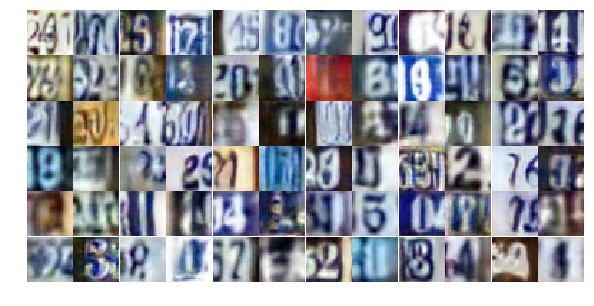

Epoch 21/25... Discriminator Loss: 0.6187... Generator Loss: 2.0561
Epoch 21/25... Discriminator Loss: 1.3961... Generator Loss: 0.3905
Epoch 21/25... Discriminator Loss: 0.5473... Generator Loss: 1.3907
Epoch 21/25... Discriminator Loss: 1.0386... Generator Loss: 3.6360
Epoch 21/25... Discriminator Loss: 0.6733... Generator Loss: 1.1829
Epoch 21/25... Discriminator Loss: 0.4742... Generator Loss: 1.4173
Epoch 21/25... Discriminator Loss: 1.0604... Generator Loss: 0.6725
Epoch 21/25... Discriminator Loss: 1.3327... Generator Loss: 0.4718
Epoch 21/25... Discriminator Loss: 0.6943... Generator Loss: 0.9857
Epoch 21/25... Discriminator Loss: 0.9876... Generator Loss: 0.6349


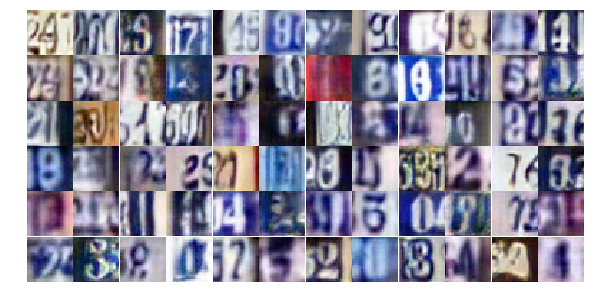

Epoch 21/25... Discriminator Loss: 0.3790... Generator Loss: 1.8930
Epoch 21/25... Discriminator Loss: 0.7547... Generator Loss: 0.8591
Epoch 21/25... Discriminator Loss: 1.7555... Generator Loss: 0.2988
Epoch 21/25... Discriminator Loss: 0.7219... Generator Loss: 1.0644
Epoch 21/25... Discriminator Loss: 0.5396... Generator Loss: 1.4370
Epoch 21/25... Discriminator Loss: 1.1105... Generator Loss: 0.6822
Epoch 21/25... Discriminator Loss: 0.7308... Generator Loss: 1.2929
Epoch 21/25... Discriminator Loss: 0.4872... Generator Loss: 1.4065
Epoch 21/25... Discriminator Loss: 0.6094... Generator Loss: 1.1132
Epoch 21/25... Discriminator Loss: 0.7764... Generator Loss: 0.8747


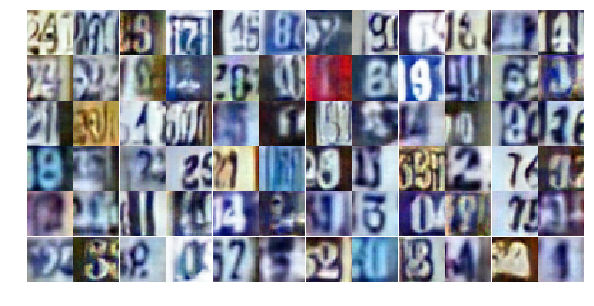

Epoch 21/25... Discriminator Loss: 0.9952... Generator Loss: 0.7699
Epoch 21/25... Discriminator Loss: 0.5149... Generator Loss: 1.2563
Epoch 21/25... Discriminator Loss: 0.7523... Generator Loss: 0.9032
Epoch 21/25... Discriminator Loss: 0.7119... Generator Loss: 1.8467
Epoch 21/25... Discriminator Loss: 1.1121... Generator Loss: 0.5459
Epoch 21/25... Discriminator Loss: 0.9074... Generator Loss: 0.8257
Epoch 21/25... Discriminator Loss: 0.7432... Generator Loss: 0.8904
Epoch 21/25... Discriminator Loss: 0.9234... Generator Loss: 0.7770
Epoch 21/25... Discriminator Loss: 1.2569... Generator Loss: 0.5579
Epoch 21/25... Discriminator Loss: 1.3586... Generator Loss: 0.5042


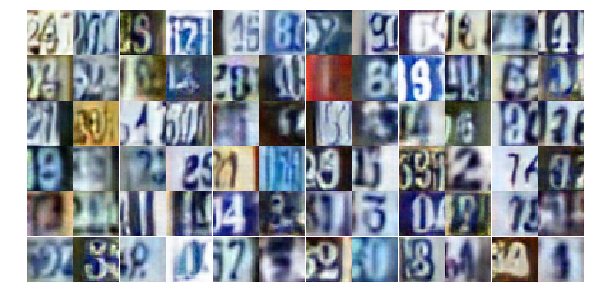

Epoch 21/25... Discriminator Loss: 1.1164... Generator Loss: 0.6390
Epoch 21/25... Discriminator Loss: 0.7144... Generator Loss: 0.9308
Epoch 21/25... Discriminator Loss: 1.2767... Generator Loss: 0.5017
Epoch 21/25... Discriminator Loss: 0.5116... Generator Loss: 1.2528
Epoch 21/25... Discriminator Loss: 0.6053... Generator Loss: 1.1191
Epoch 21/25... Discriminator Loss: 1.2614... Generator Loss: 0.4890
Epoch 21/25... Discriminator Loss: 0.9525... Generator Loss: 0.7743
Epoch 21/25... Discriminator Loss: 1.4078... Generator Loss: 0.4309
Epoch 21/25... Discriminator Loss: 0.7337... Generator Loss: 1.2502
Epoch 21/25... Discriminator Loss: 0.8641... Generator Loss: 1.0619


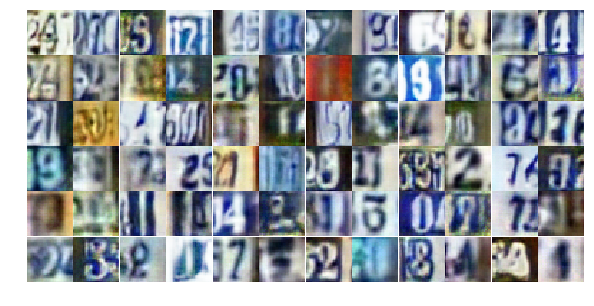

Epoch 21/25... Discriminator Loss: 1.3569... Generator Loss: 0.5764
Epoch 21/25... Discriminator Loss: 1.2681... Generator Loss: 0.4630
Epoch 21/25... Discriminator Loss: 0.6889... Generator Loss: 1.4330
Epoch 21/25... Discriminator Loss: 0.7547... Generator Loss: 1.0346
Epoch 21/25... Discriminator Loss: 0.5231... Generator Loss: 1.3096
Epoch 21/25... Discriminator Loss: 0.7642... Generator Loss: 1.0742
Epoch 21/25... Discriminator Loss: 1.2066... Generator Loss: 0.5215
Epoch 21/25... Discriminator Loss: 1.2869... Generator Loss: 0.4936
Epoch 21/25... Discriminator Loss: 0.8047... Generator Loss: 0.9070
Epoch 21/25... Discriminator Loss: 0.6460... Generator Loss: 1.0494


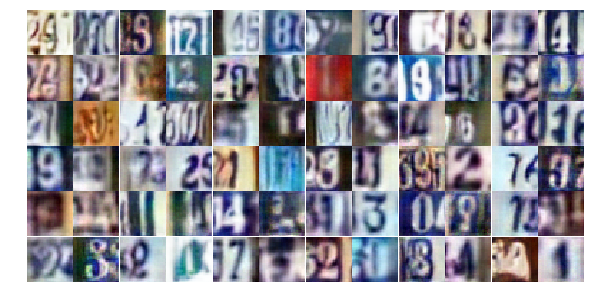

Epoch 21/25... Discriminator Loss: 0.4761... Generator Loss: 1.5650
Epoch 21/25... Discriminator Loss: 0.6368... Generator Loss: 1.0984
Epoch 21/25... Discriminator Loss: 0.6031... Generator Loss: 1.3066
Epoch 22/25... Discriminator Loss: 0.7355... Generator Loss: 2.1225
Epoch 22/25... Discriminator Loss: 0.8401... Generator Loss: 0.9398
Epoch 22/25... Discriminator Loss: 0.8916... Generator Loss: 0.7901
Epoch 22/25... Discriminator Loss: 1.0545... Generator Loss: 0.6268
Epoch 22/25... Discriminator Loss: 0.6950... Generator Loss: 0.9329
Epoch 22/25... Discriminator Loss: 1.1722... Generator Loss: 0.4865
Epoch 22/25... Discriminator Loss: 0.9797... Generator Loss: 0.6420


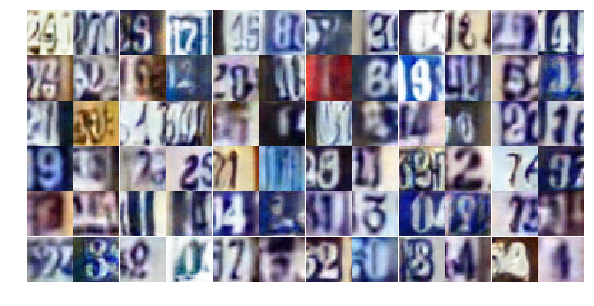

Epoch 22/25... Discriminator Loss: 0.5042... Generator Loss: 1.5338
Epoch 22/25... Discriminator Loss: 0.6167... Generator Loss: 1.2993
Epoch 22/25... Discriminator Loss: 1.5949... Generator Loss: 0.3252
Epoch 22/25... Discriminator Loss: 0.6811... Generator Loss: 1.0575
Epoch 22/25... Discriminator Loss: 0.7975... Generator Loss: 0.9871
Epoch 22/25... Discriminator Loss: 0.5926... Generator Loss: 1.2862
Epoch 22/25... Discriminator Loss: 0.7792... Generator Loss: 0.8718
Epoch 22/25... Discriminator Loss: 0.4096... Generator Loss: 1.6535
Epoch 22/25... Discriminator Loss: 1.0960... Generator Loss: 0.6418
Epoch 22/25... Discriminator Loss: 1.9593... Generator Loss: 0.2153


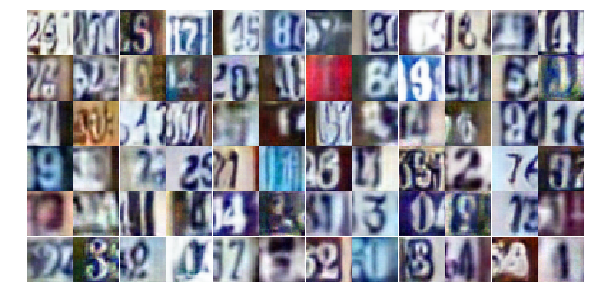

Epoch 22/25... Discriminator Loss: 0.5612... Generator Loss: 1.2510
Epoch 22/25... Discriminator Loss: 0.6190... Generator Loss: 1.0569
Epoch 22/25... Discriminator Loss: 1.0484... Generator Loss: 0.6653
Epoch 22/25... Discriminator Loss: 0.5535... Generator Loss: 1.4989
Epoch 22/25... Discriminator Loss: 0.4767... Generator Loss: 1.3950
Epoch 22/25... Discriminator Loss: 1.2726... Generator Loss: 0.4375
Epoch 22/25... Discriminator Loss: 0.3806... Generator Loss: 2.1142
Epoch 22/25... Discriminator Loss: 0.4113... Generator Loss: 2.0515
Epoch 22/25... Discriminator Loss: 0.6969... Generator Loss: 0.9778
Epoch 22/25... Discriminator Loss: 0.9376... Generator Loss: 0.7302


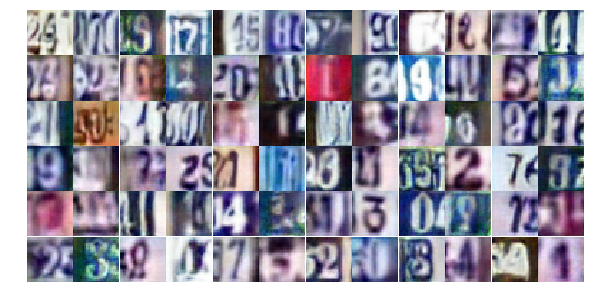

Epoch 22/25... Discriminator Loss: 0.4797... Generator Loss: 1.3144
Epoch 22/25... Discriminator Loss: 0.3538... Generator Loss: 1.9192
Epoch 22/25... Discriminator Loss: 0.8603... Generator Loss: 0.7862
Epoch 22/25... Discriminator Loss: 1.1308... Generator Loss: 0.5560
Epoch 22/25... Discriminator Loss: 1.3444... Generator Loss: 0.4593
Epoch 22/25... Discriminator Loss: 0.9718... Generator Loss: 0.8033
Epoch 22/25... Discriminator Loss: 1.5372... Generator Loss: 0.3347
Epoch 22/25... Discriminator Loss: 0.6297... Generator Loss: 1.1152
Epoch 22/25... Discriminator Loss: 0.7995... Generator Loss: 0.9450
Epoch 22/25... Discriminator Loss: 0.8909... Generator Loss: 0.7435


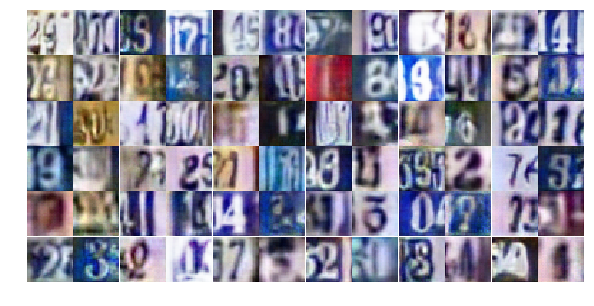

Epoch 22/25... Discriminator Loss: 0.6235... Generator Loss: 1.1436
Epoch 22/25... Discriminator Loss: 0.8097... Generator Loss: 0.8260
Epoch 22/25... Discriminator Loss: 0.3121... Generator Loss: 2.4017
Epoch 22/25... Discriminator Loss: 0.8388... Generator Loss: 0.8676
Epoch 22/25... Discriminator Loss: 0.4737... Generator Loss: 2.1472
Epoch 22/25... Discriminator Loss: 0.5355... Generator Loss: 1.1228
Epoch 22/25... Discriminator Loss: 0.5262... Generator Loss: 1.5394
Epoch 22/25... Discriminator Loss: 1.0826... Generator Loss: 0.5800
Epoch 22/25... Discriminator Loss: 2.0805... Generator Loss: 0.2546
Epoch 22/25... Discriminator Loss: 1.2409... Generator Loss: 2.8481


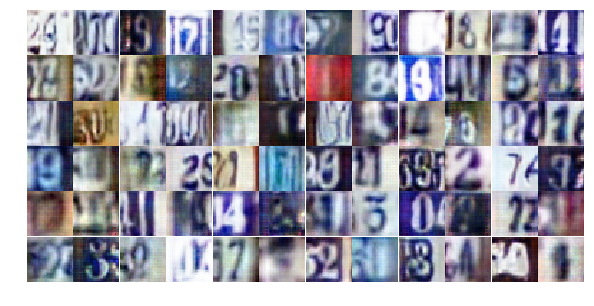

Epoch 22/25... Discriminator Loss: 0.8509... Generator Loss: 1.9150
Epoch 22/25... Discriminator Loss: 0.8828... Generator Loss: 1.3074
Epoch 22/25... Discriminator Loss: 0.8864... Generator Loss: 0.7902
Epoch 22/25... Discriminator Loss: 0.7773... Generator Loss: 1.0941
Epoch 22/25... Discriminator Loss: 1.2024... Generator Loss: 0.5692
Epoch 22/25... Discriminator Loss: 0.9190... Generator Loss: 0.8357
Epoch 22/25... Discriminator Loss: 1.5855... Generator Loss: 0.3151
Epoch 22/25... Discriminator Loss: 0.5491... Generator Loss: 1.4277
Epoch 22/25... Discriminator Loss: 0.9883... Generator Loss: 1.1878
Epoch 22/25... Discriminator Loss: 0.8489... Generator Loss: 0.8954


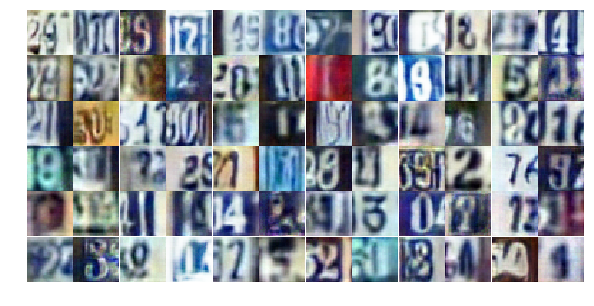

Epoch 23/25... Discriminator Loss: 0.6141... Generator Loss: 1.1601
Epoch 23/25... Discriminator Loss: 0.6077... Generator Loss: 1.0841
Epoch 23/25... Discriminator Loss: 0.9061... Generator Loss: 0.7537
Epoch 23/25... Discriminator Loss: 0.6719... Generator Loss: 1.1566
Epoch 23/25... Discriminator Loss: 0.9211... Generator Loss: 0.7762
Epoch 23/25... Discriminator Loss: 1.2262... Generator Loss: 0.5202
Epoch 23/25... Discriminator Loss: 0.9559... Generator Loss: 0.7142
Epoch 23/25... Discriminator Loss: 1.0080... Generator Loss: 0.6923
Epoch 23/25... Discriminator Loss: 0.7529... Generator Loss: 1.2069
Epoch 23/25... Discriminator Loss: 0.4424... Generator Loss: 1.9698


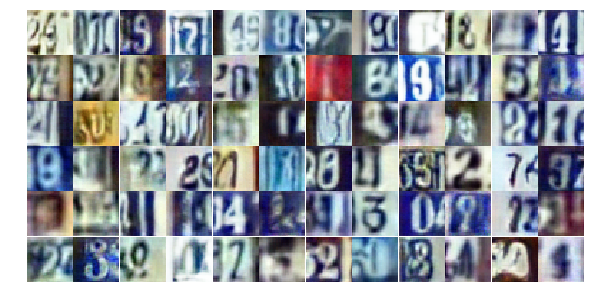

Epoch 23/25... Discriminator Loss: 0.7627... Generator Loss: 0.8881
Epoch 23/25... Discriminator Loss: 0.9788... Generator Loss: 0.6907
Epoch 23/25... Discriminator Loss: 0.9445... Generator Loss: 0.7685
Epoch 23/25... Discriminator Loss: 0.7091... Generator Loss: 0.9673
Epoch 23/25... Discriminator Loss: 0.6202... Generator Loss: 1.1194
Epoch 23/25... Discriminator Loss: 1.2260... Generator Loss: 0.5396
Epoch 23/25... Discriminator Loss: 0.8448... Generator Loss: 0.8571
Epoch 23/25... Discriminator Loss: 1.6852... Generator Loss: 0.4198
Epoch 23/25... Discriminator Loss: 0.7962... Generator Loss: 0.9265
Epoch 23/25... Discriminator Loss: 0.9466... Generator Loss: 0.7088


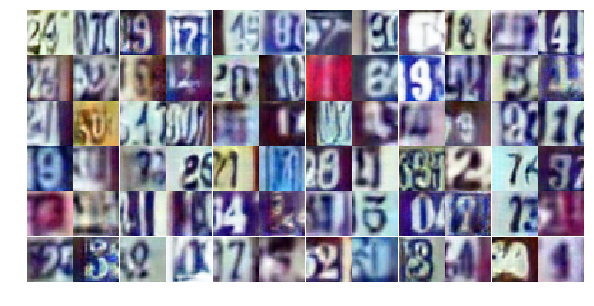

Epoch 23/25... Discriminator Loss: 1.2151... Generator Loss: 0.4754
Epoch 23/25... Discriminator Loss: 0.4916... Generator Loss: 1.5978
Epoch 23/25... Discriminator Loss: 1.1221... Generator Loss: 0.5759
Epoch 23/25... Discriminator Loss: 0.7080... Generator Loss: 0.9599
Epoch 23/25... Discriminator Loss: 0.5310... Generator Loss: 1.5866
Epoch 23/25... Discriminator Loss: 0.8050... Generator Loss: 0.8453
Epoch 23/25... Discriminator Loss: 0.9196... Generator Loss: 0.7192
Epoch 23/25... Discriminator Loss: 0.6327... Generator Loss: 1.0196
Epoch 23/25... Discriminator Loss: 0.6799... Generator Loss: 1.1606
Epoch 23/25... Discriminator Loss: 0.8890... Generator Loss: 1.4888


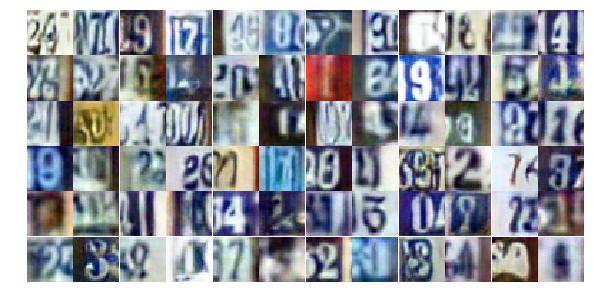

Epoch 23/25... Discriminator Loss: 0.5941... Generator Loss: 1.2004
Epoch 23/25... Discriminator Loss: 0.6432... Generator Loss: 1.0716
Epoch 23/25... Discriminator Loss: 0.6788... Generator Loss: 1.0555
Epoch 23/25... Discriminator Loss: 1.5466... Generator Loss: 0.3522
Epoch 23/25... Discriminator Loss: 0.5452... Generator Loss: 1.6823
Epoch 23/25... Discriminator Loss: 1.3279... Generator Loss: 0.4581
Epoch 23/25... Discriminator Loss: 1.1037... Generator Loss: 0.6190
Epoch 23/25... Discriminator Loss: 0.6149... Generator Loss: 1.0795
Epoch 23/25... Discriminator Loss: 0.4183... Generator Loss: 1.5875
Epoch 23/25... Discriminator Loss: 0.3926... Generator Loss: 1.5704


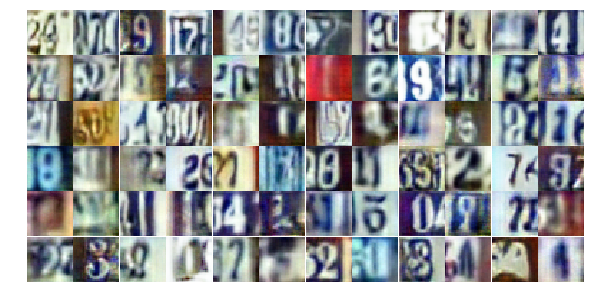

Epoch 23/25... Discriminator Loss: 0.8962... Generator Loss: 0.8495
Epoch 23/25... Discriminator Loss: 0.7023... Generator Loss: 1.0142
Epoch 23/25... Discriminator Loss: 1.2846... Generator Loss: 0.4640
Epoch 23/25... Discriminator Loss: 0.7228... Generator Loss: 0.9290
Epoch 23/25... Discriminator Loss: 1.4302... Generator Loss: 0.3856
Epoch 23/25... Discriminator Loss: 0.5009... Generator Loss: 1.6276
Epoch 23/25... Discriminator Loss: 2.1589... Generator Loss: 0.4638
Epoch 23/25... Discriminator Loss: 1.3641... Generator Loss: 0.5905
Epoch 23/25... Discriminator Loss: 0.7044... Generator Loss: 1.7861
Epoch 23/25... Discriminator Loss: 1.1941... Generator Loss: 0.5627


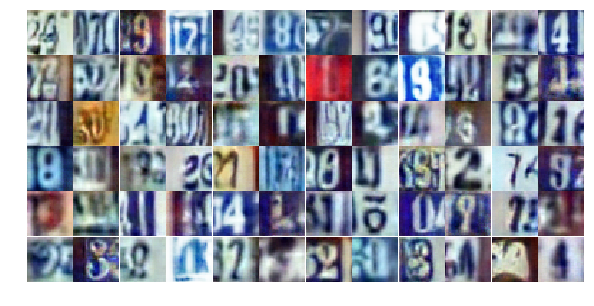

Epoch 23/25... Discriminator Loss: 0.6234... Generator Loss: 1.1195
Epoch 23/25... Discriminator Loss: 1.4017... Generator Loss: 0.3892
Epoch 23/25... Discriminator Loss: 0.7725... Generator Loss: 0.9512
Epoch 23/25... Discriminator Loss: 0.4579... Generator Loss: 1.3524
Epoch 23/25... Discriminator Loss: 1.1865... Generator Loss: 0.6136
Epoch 23/25... Discriminator Loss: 1.5760... Generator Loss: 4.0902
Epoch 23/25... Discriminator Loss: 0.8405... Generator Loss: 0.9376
Epoch 24/25... Discriminator Loss: 0.9180... Generator Loss: 0.7576
Epoch 24/25... Discriminator Loss: 0.7348... Generator Loss: 1.0834
Epoch 24/25... Discriminator Loss: 1.1556... Generator Loss: 0.5640


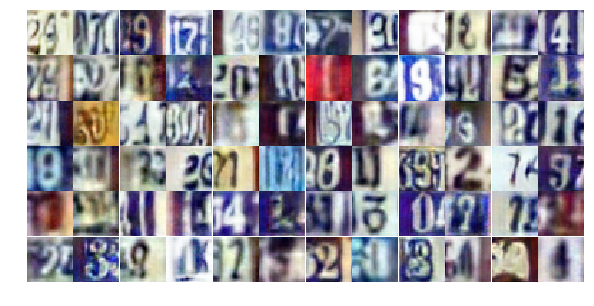

Epoch 24/25... Discriminator Loss: 0.5830... Generator Loss: 1.3032
Epoch 24/25... Discriminator Loss: 0.6505... Generator Loss: 1.3469
Epoch 24/25... Discriminator Loss: 0.5837... Generator Loss: 1.2774
Epoch 24/25... Discriminator Loss: 0.7806... Generator Loss: 1.9809
Epoch 24/25... Discriminator Loss: 0.5918... Generator Loss: 1.1703
Epoch 24/25... Discriminator Loss: 0.5016... Generator Loss: 1.3698
Epoch 24/25... Discriminator Loss: 0.6869... Generator Loss: 1.0830
Epoch 24/25... Discriminator Loss: 1.5366... Generator Loss: 0.3518
Epoch 24/25... Discriminator Loss: 0.5172... Generator Loss: 1.1714
Epoch 24/25... Discriminator Loss: 0.5011... Generator Loss: 1.6243


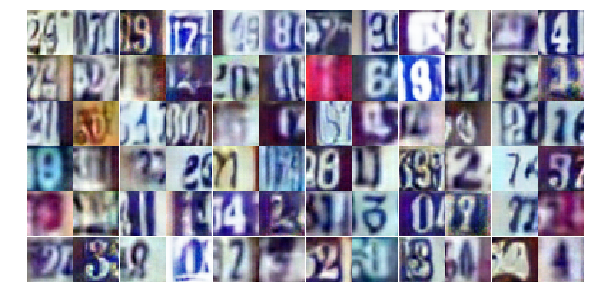

Epoch 24/25... Discriminator Loss: 1.5637... Generator Loss: 0.3284
Epoch 24/25... Discriminator Loss: 1.1488... Generator Loss: 0.5893
Epoch 24/25... Discriminator Loss: 1.3340... Generator Loss: 0.4616
Epoch 24/25... Discriminator Loss: 0.6799... Generator Loss: 0.9931
Epoch 24/25... Discriminator Loss: 1.1980... Generator Loss: 3.3303
Epoch 24/25... Discriminator Loss: 1.5570... Generator Loss: 0.4681
Epoch 24/25... Discriminator Loss: 1.0314... Generator Loss: 0.6696
Epoch 24/25... Discriminator Loss: 1.2550... Generator Loss: 0.5082
Epoch 24/25... Discriminator Loss: 0.8260... Generator Loss: 0.9533
Epoch 24/25... Discriminator Loss: 0.6169... Generator Loss: 1.2592


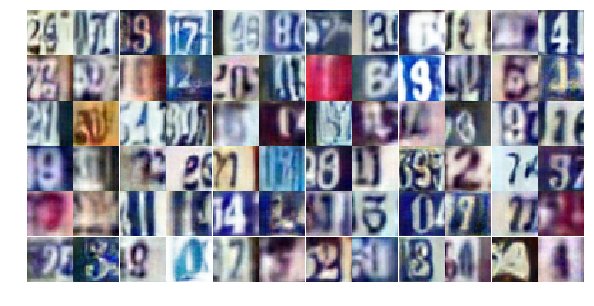

Epoch 24/25... Discriminator Loss: 0.6853... Generator Loss: 1.0685
Epoch 24/25... Discriminator Loss: 0.8405... Generator Loss: 1.1189
Epoch 24/25... Discriminator Loss: 0.5074... Generator Loss: 1.6625
Epoch 24/25... Discriminator Loss: 0.8671... Generator Loss: 0.8077
Epoch 24/25... Discriminator Loss: 0.6192... Generator Loss: 0.9889
Epoch 24/25... Discriminator Loss: 0.6888... Generator Loss: 0.9906
Epoch 24/25... Discriminator Loss: 0.5562... Generator Loss: 1.1119
Epoch 24/25... Discriminator Loss: 0.6484... Generator Loss: 1.2728
Epoch 24/25... Discriminator Loss: 0.9415... Generator Loss: 0.7144
Epoch 24/25... Discriminator Loss: 0.9388... Generator Loss: 0.8096


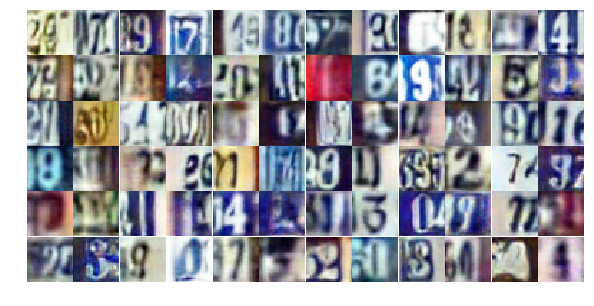

Epoch 24/25... Discriminator Loss: 0.6017... Generator Loss: 1.2152
Epoch 24/25... Discriminator Loss: 0.8705... Generator Loss: 0.7079
Epoch 24/25... Discriminator Loss: 0.8890... Generator Loss: 0.8445
Epoch 24/25... Discriminator Loss: 1.3998... Generator Loss: 0.4866
Epoch 24/25... Discriminator Loss: 1.2708... Generator Loss: 0.4872
Epoch 24/25... Discriminator Loss: 1.0406... Generator Loss: 0.6428
Epoch 24/25... Discriminator Loss: 1.1234... Generator Loss: 0.5545
Epoch 24/25... Discriminator Loss: 1.1833... Generator Loss: 0.5434
Epoch 24/25... Discriminator Loss: 0.5915... Generator Loss: 1.2330
Epoch 24/25... Discriminator Loss: 0.6600... Generator Loss: 2.0180


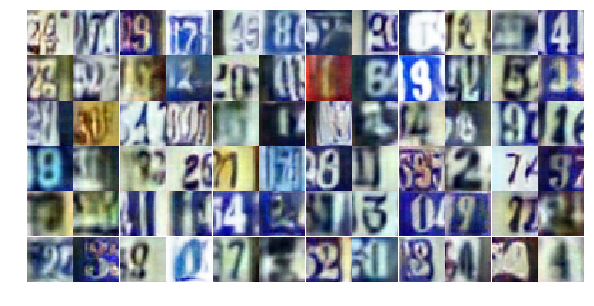

Epoch 24/25... Discriminator Loss: 0.9162... Generator Loss: 0.7461
Epoch 24/25... Discriminator Loss: 1.4747... Generator Loss: 0.4810
Epoch 24/25... Discriminator Loss: 1.5354... Generator Loss: 0.3612
Epoch 24/25... Discriminator Loss: 0.7297... Generator Loss: 1.8664
Epoch 24/25... Discriminator Loss: 1.4687... Generator Loss: 0.3925
Epoch 24/25... Discriminator Loss: 1.0098... Generator Loss: 0.7215
Epoch 24/25... Discriminator Loss: 0.8105... Generator Loss: 0.8872
Epoch 24/25... Discriminator Loss: 0.6243... Generator Loss: 1.0731
Epoch 24/25... Discriminator Loss: 1.0639... Generator Loss: 0.5770
Epoch 24/25... Discriminator Loss: 1.1128... Generator Loss: 0.6771


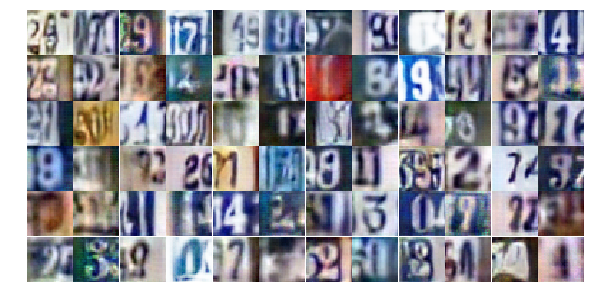

Epoch 24/25... Discriminator Loss: 1.0923... Generator Loss: 0.6026
Epoch 24/25... Discriminator Loss: 1.5187... Generator Loss: 0.3774
Epoch 24/25... Discriminator Loss: 0.8456... Generator Loss: 0.9291
Epoch 24/25... Discriminator Loss: 1.9127... Generator Loss: 0.2509
Epoch 24/25... Discriminator Loss: 1.0533... Generator Loss: 0.7291
Epoch 25/25... Discriminator Loss: 0.9328... Generator Loss: 0.7605
Epoch 25/25... Discriminator Loss: 0.5179... Generator Loss: 1.5051
Epoch 25/25... Discriminator Loss: 0.8660... Generator Loss: 0.7419
Epoch 25/25... Discriminator Loss: 0.6601... Generator Loss: 1.1105
Epoch 25/25... Discriminator Loss: 0.6658... Generator Loss: 1.1571


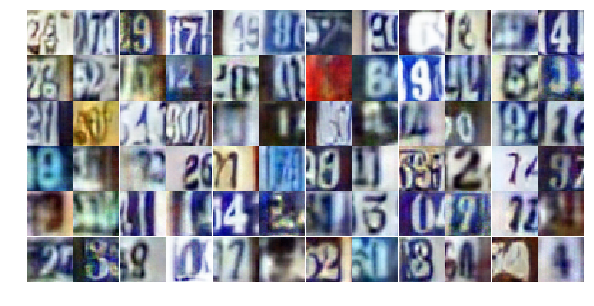

Epoch 25/25... Discriminator Loss: 0.7822... Generator Loss: 1.3840
Epoch 25/25... Discriminator Loss: 0.8857... Generator Loss: 0.8561
Epoch 25/25... Discriminator Loss: 0.6566... Generator Loss: 1.2870
Epoch 25/25... Discriminator Loss: 1.1233... Generator Loss: 0.5800
Epoch 25/25... Discriminator Loss: 0.6870... Generator Loss: 1.3137
Epoch 25/25... Discriminator Loss: 0.7101... Generator Loss: 1.0484
Epoch 25/25... Discriminator Loss: 0.8668... Generator Loss: 0.8040
Epoch 25/25... Discriminator Loss: 0.4951... Generator Loss: 1.5939
Epoch 25/25... Discriminator Loss: 0.6511... Generator Loss: 1.1346
Epoch 25/25... Discriminator Loss: 1.1900... Generator Loss: 0.5276


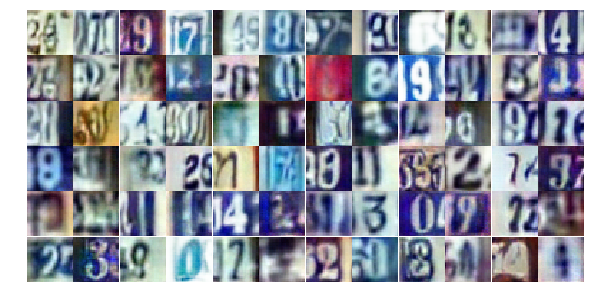

Epoch 25/25... Discriminator Loss: 0.9597... Generator Loss: 0.6933
Epoch 25/25... Discriminator Loss: 0.9402... Generator Loss: 3.2734
Epoch 25/25... Discriminator Loss: 1.9377... Generator Loss: 0.2556
Epoch 25/25... Discriminator Loss: 1.2586... Generator Loss: 0.5647
Epoch 25/25... Discriminator Loss: 0.9841... Generator Loss: 0.7581
Epoch 25/25... Discriminator Loss: 0.4798... Generator Loss: 1.5276
Epoch 25/25... Discriminator Loss: 0.6464... Generator Loss: 1.1952
Epoch 25/25... Discriminator Loss: 0.6720... Generator Loss: 1.9550
Epoch 25/25... Discriminator Loss: 0.6127... Generator Loss: 1.4566
Epoch 25/25... Discriminator Loss: 0.6719... Generator Loss: 1.1083


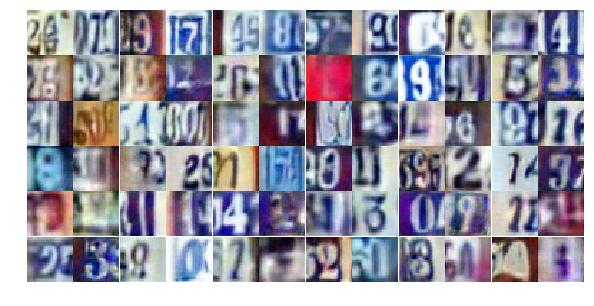

Epoch 25/25... Discriminator Loss: 0.9420... Generator Loss: 0.7719
Epoch 25/25... Discriminator Loss: 0.4717... Generator Loss: 1.8978
Epoch 25/25... Discriminator Loss: 1.1304... Generator Loss: 0.6153
Epoch 25/25... Discriminator Loss: 0.8960... Generator Loss: 0.8804
Epoch 25/25... Discriminator Loss: 0.8542... Generator Loss: 1.0032
Epoch 25/25... Discriminator Loss: 0.6456... Generator Loss: 1.0445
Epoch 25/25... Discriminator Loss: 0.4982... Generator Loss: 1.7302
Epoch 25/25... Discriminator Loss: 0.7844... Generator Loss: 0.9140
Epoch 25/25... Discriminator Loss: 0.7368... Generator Loss: 2.1324
Epoch 25/25... Discriminator Loss: 0.3937... Generator Loss: 2.0322


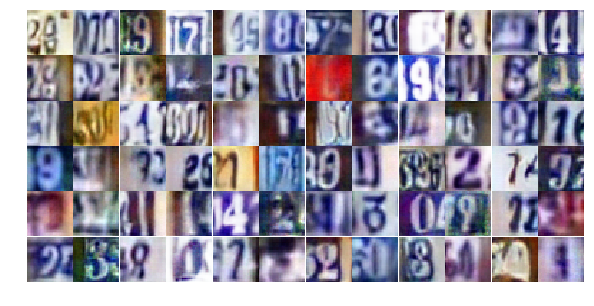

Epoch 25/25... Discriminator Loss: 1.0608... Generator Loss: 0.5875
Epoch 25/25... Discriminator Loss: 0.5895... Generator Loss: 1.1700
Epoch 25/25... Discriminator Loss: 0.8023... Generator Loss: 0.8218
Epoch 25/25... Discriminator Loss: 0.7680... Generator Loss: 0.9121
Epoch 25/25... Discriminator Loss: 1.3103... Generator Loss: 0.5371
Epoch 25/25... Discriminator Loss: 0.8810... Generator Loss: 0.8267
Epoch 25/25... Discriminator Loss: 0.5429... Generator Loss: 1.6765
Epoch 25/25... Discriminator Loss: 0.3859... Generator Loss: 1.6742
Epoch 25/25... Discriminator Loss: 1.5884... Generator Loss: 0.3731
Epoch 25/25... Discriminator Loss: 0.7256... Generator Loss: 0.9336


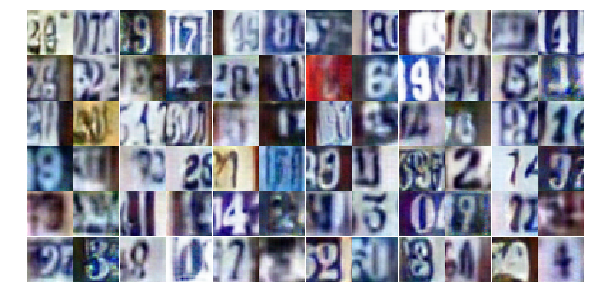

Epoch 25/25... Discriminator Loss: 0.8648... Generator Loss: 1.1250
Epoch 25/25... Discriminator Loss: 0.5930... Generator Loss: 1.1122
Epoch 25/25... Discriminator Loss: 0.8935... Generator Loss: 0.7514
Epoch 25/25... Discriminator Loss: 1.4162... Generator Loss: 0.4418
Epoch 25/25... Discriminator Loss: 1.2800... Generator Loss: 0.5481
Epoch 25/25... Discriminator Loss: 0.5589... Generator Loss: 1.1849
Epoch 25/25... Discriminator Loss: 1.4135... Generator Loss: 0.4397
Epoch 25/25... Discriminator Loss: 0.5686... Generator Loss: 1.4054
Epoch 25/25... Discriminator Loss: 0.6966... Generator Loss: 1.0543
Epoch 25/25... Discriminator Loss: 1.0421... Generator Loss: 0.7118


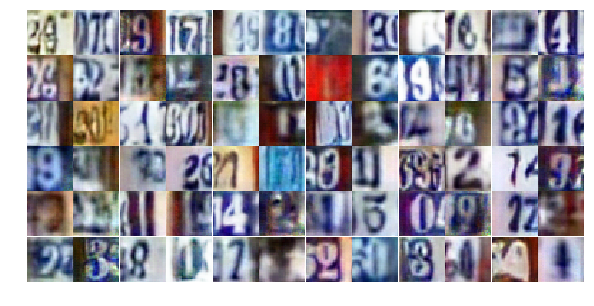

Epoch 25/25... Discriminator Loss: 0.4499... Generator Loss: 1.6000
Epoch 25/25... Discriminator Loss: 1.7534... Generator Loss: 0.3483


In [18]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

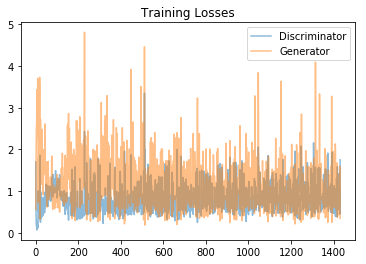

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

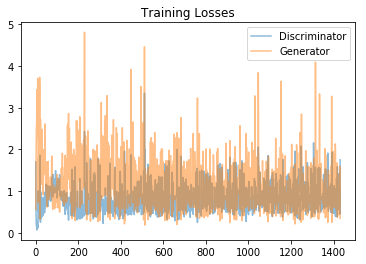

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

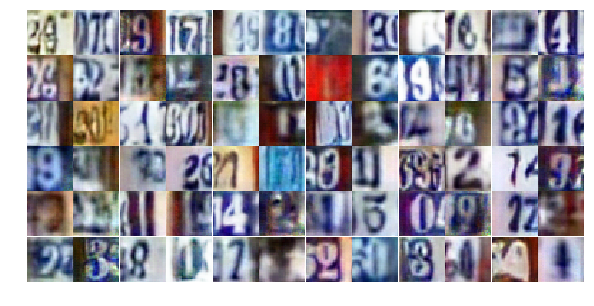

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

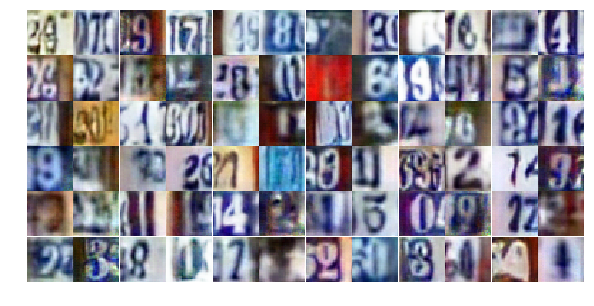

In [22]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))